In [1]:
import numpy as np
from numpy import *
from pylab import *
from math import *
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import os 
import pandas as pd
import glob
from astropy.io import ascii
import itertools
from datetime import datetime

# Ajuste gaussiano
from scipy.optimize import minimize
import emcee
import corner
from IPython.display import display, Math
from scipy.optimize import curve_fit

path = os.getcwd()

### Sustracción del espectro de los gases

Una vez se obtiene el espectro sintetizado mediante Starlight se procede a obtener el espectro del gas.

El espectro sintetizado por el código de Starlight se corresponde con la parte estelar, por lo que al eliminarla obtenemos los gases.

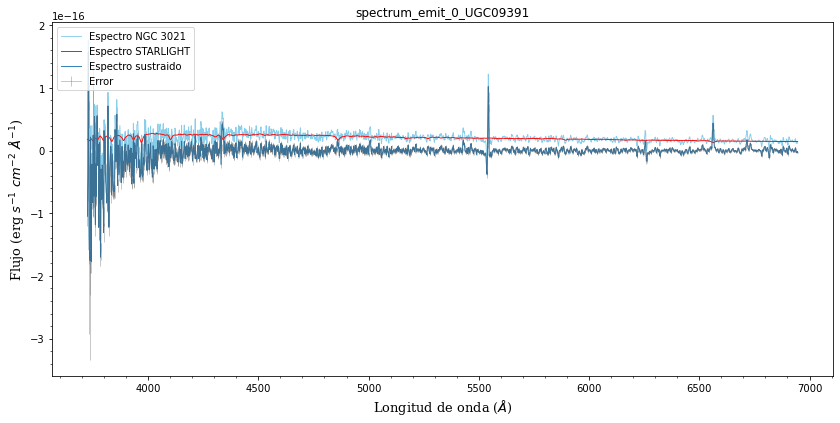

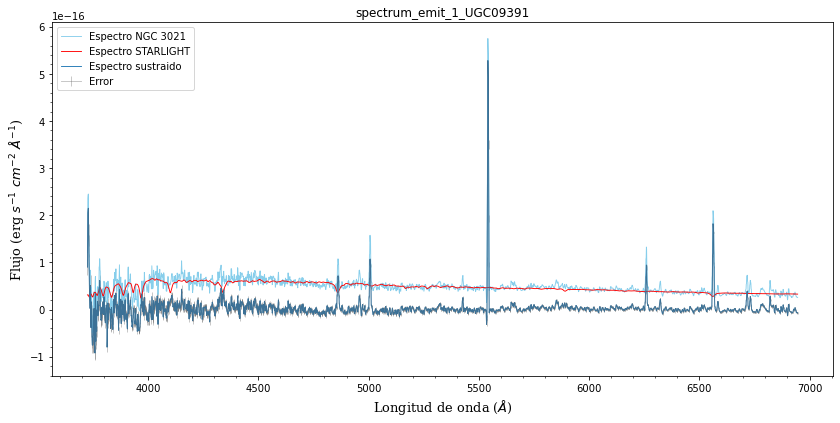

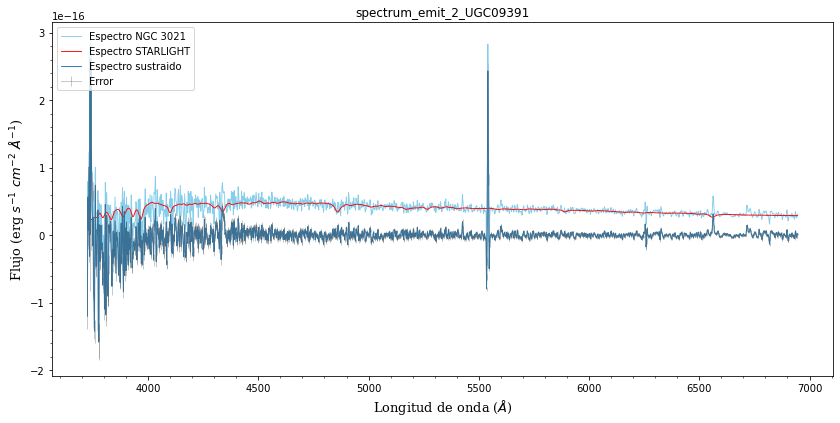

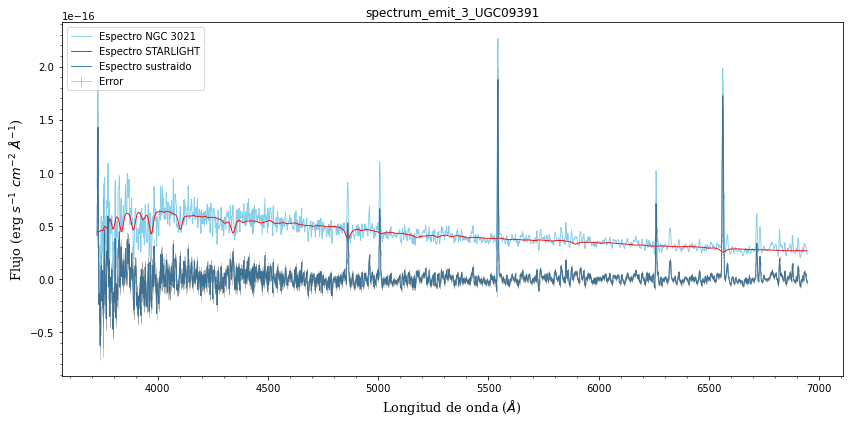

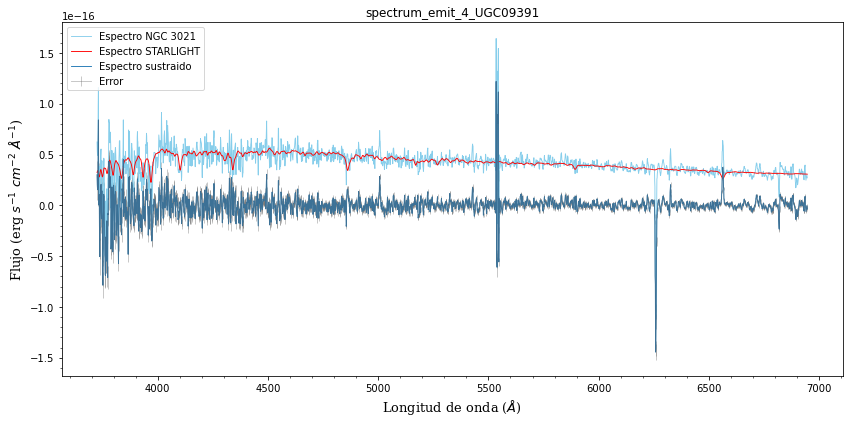

...

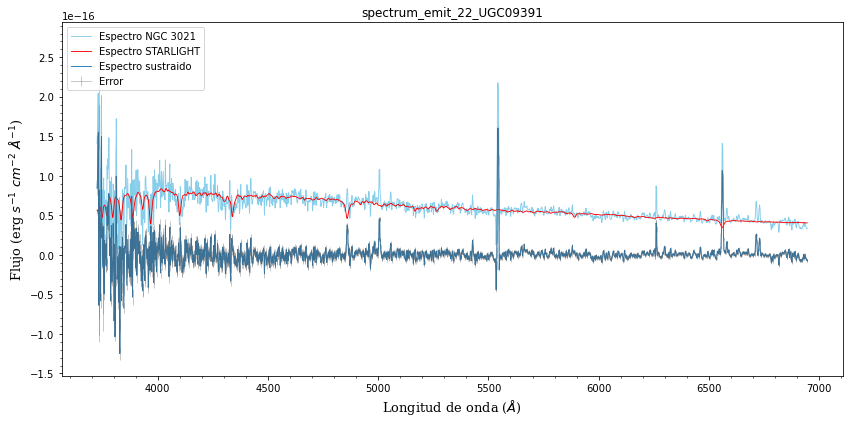

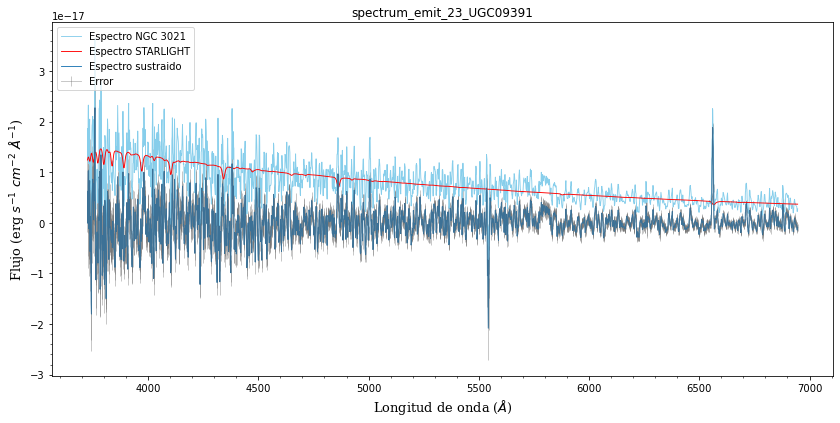

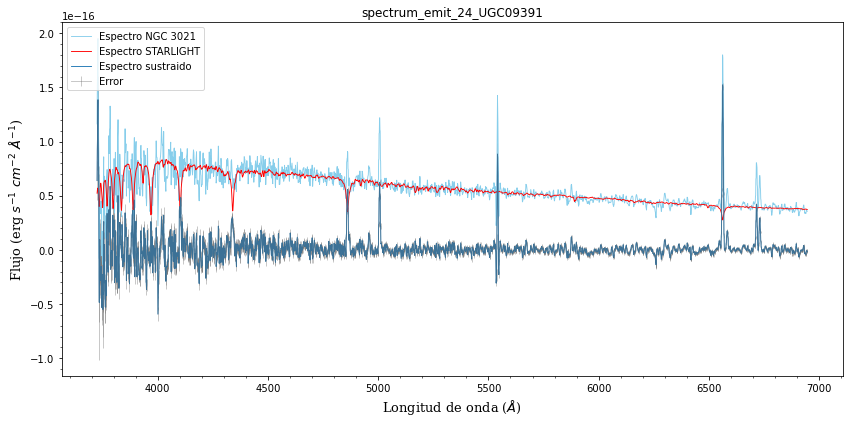

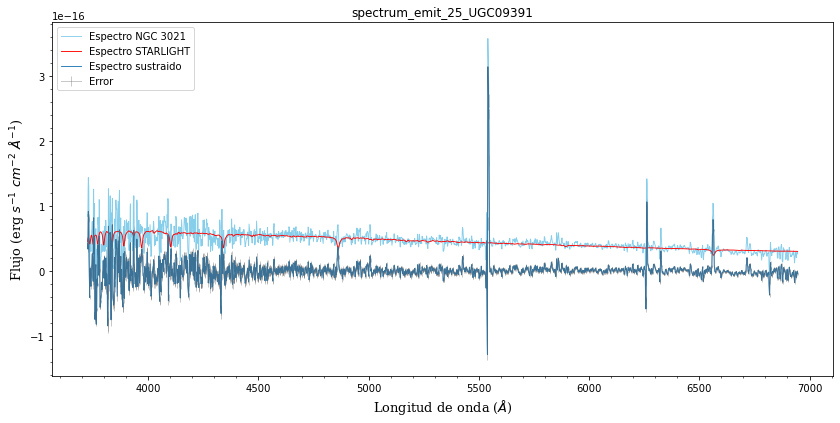

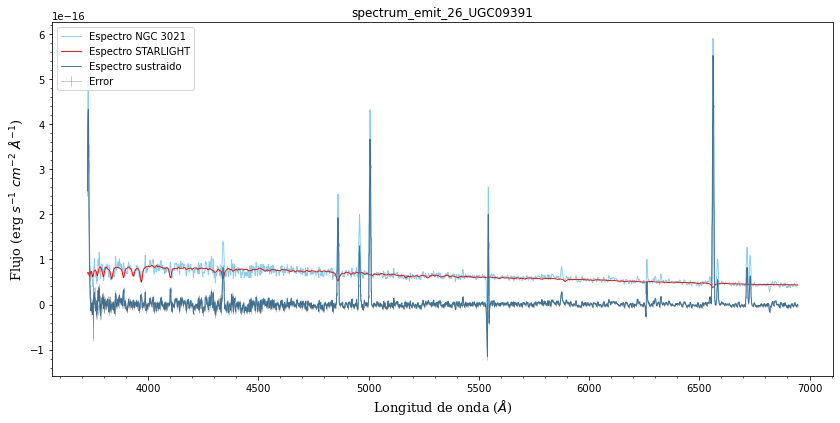

In [2]:
os.chdir(path+'\emited_spectrum')    
os.getcwd()

l_obs_todos = []
f_obs_todos = []
f_syn_todos = []
e_emit_todos = []

lenn = len(glob.glob1(path+'\emited_spectrum',"*.BN"))
#for i in list(itertools.chain(range(lenn-10,lenn-9))):
for i in range(len(glob.glob1(path+'/emited_spectrum',"*.BN"))):
    file = 'spectrum_emit_'+str(i)+'_UGC09391'
    l_obs = []
    f_obs = []
    f_syn = []
    with open(file+'.BN', 'r') as SL:
        f_obs_norm = float((np.array((SL.readlines()[25]).split()))[0,])
    with open(file+'.BN', 'r') as SL:
        data = SL.readlines()[1078:4334]   
        for linea in data:
            linea = np.array(linea.split())
            if float(linea[1]) != 0:
                l_obs.append(float(linea[0,]))
                f_obs.append(float(linea[1,]))
                f_syn.append(float(linea[2,]))
        l_obs = np.array(l_obs)
        f_obs = np.array(f_obs)*f_obs_norm
        f_syn = np.array(f_syn)*f_obs_norm
    
    e_emit = []
    with open(file+'.txt','r') as datos:
        data = datos.readlines()
        for linea in data:
            linea = np.array(linea.split())
            if float(linea[0]) >= l_obs[0] and float(linea[0]) <= l_obs[-1]:
                e_emit.append(float(linea[2,]))
        e_emit = np.array(e_emit)        
        
    
    fig, ax = plt.subplots(figsize=(14,6.5))
    ax.plot(l_obs,f_obs,color='skyblue', linewidth=0.9,label="Espectro NGC 3021")
    ax.plot(l_obs,f_syn,color='red', linewidth=0.9,label="Espectro STARLIGHT")
    ax.errorbar(l_obs,f_obs-f_syn,yerr=e_emit,linewidth=0.9, alpha=0.4, label='Error', color='dimgrey')
    ax.plot(l_obs,f_obs-f_syn, linewidth=0.9,label="Espectro sustraido")
    
    xlabel(r'Longitud de onda ($\AA$)', fontsize=13,fontfamily='serif'); ylabel(r'Flujo (erg $s^{-1}$ $cm^{-2}$ $\AA^{-1}$)', fontsize=13,fontfamily='serif') 
    plt.legend(loc='upper left')
    title('%s' %(file));plt.legend(loc='upper left')
    plt.minorticks_on()
    #axvline(4861, color='k', ls="dotted",lw='0.9')
    #text(4881, 8.3*10**(-16), r'[H$_{\beta}$] 4861',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(5007, color='k', ls="dotted",lw='0.9')
    #text(5027, 8.3*10**(-16), r'[O III] 5007',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(6563, color='k', ls="dotted",lw='0.9')
    #text(6485, 9.9*10**(-16), r'[H$_{\alpha}$] 6563',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(6583, color='k', ls="dotted",lw='0.9')
    #text(6603, 9.9*10**(-16), r'[N II] 6583',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(6716, color='k', ls="dotted",lw='0.9')
    #text(6646, 6.5*10**(-16), r'[S II] 6716',alpha=0.8,rotation='vertical',fontsize='11') 
    #axvline(6731, color='k', ls="dotted",lw='0.9')
    #text(6751, 6.5*10**(-16), r'[S II] 6731',alpha=0.8,rotation='vertical',fontsize='11')  
    #plt.savefig('espectro_final.png')
    plt.show() 
    
    l_obs_todos.append(l_obs)
    f_obs_todos.append(f_obs)
    f_syn_todos.append(f_syn)
    e_emit_todos.append(e_emit)
    
l_obs_todos = np.array(l_obs_todos)
f_obs_todos = np.array(f_obs_todos)
f_syn_todos = np.array(f_syn_todos)
e_emit_todos = np.array(e_emit_todos)

### Ajuste gaussiano en las líneas de Hbeta, OIII, Halfa y NII

Se emplean dos ajustes distintos:
 - Dos ajustes simple para Hb y OIII 
         def gaussian(x, a, x0, sigma):
            return a*np.exp(-(x-x0)**2/(2*sigma**2))
            
 - Un ajuste triple para Halfa y NII 
         def gaussian_2(x, a1 ,a2,a3, x0, sigma):
           return a1*np.exp(-(x-x0)**2/(2*sigma**2))+a2*np.exp(-(x-(x0+d1))**2/(2*sigma**2))+a3*np.exp(-(x-(x0-d2))**2/(2*sigma**2))
        
   
Como las líneas de Halfa y NII están muy cerca hay que hacer un ajuste de tres gaussianas a la vez. 


AJUSTANDO ESPECTRO 0

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


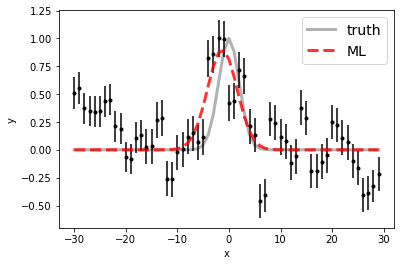

100%|██████████| 15000/15000 [00:20<00:00, 714.51it/s]


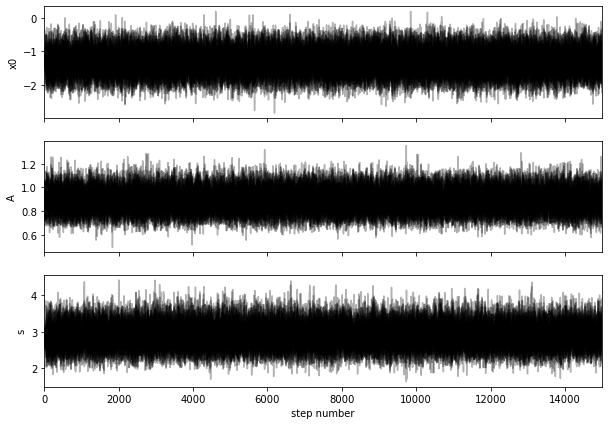

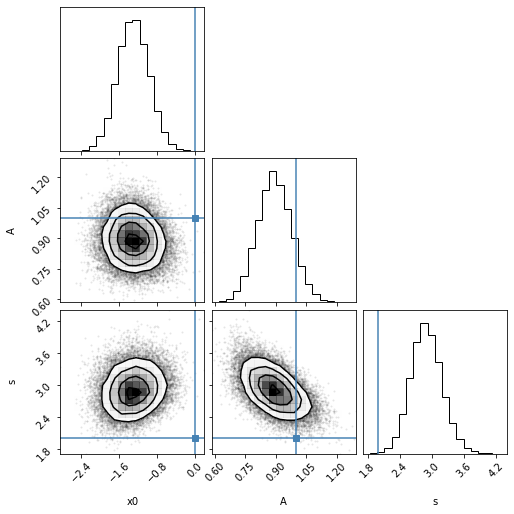

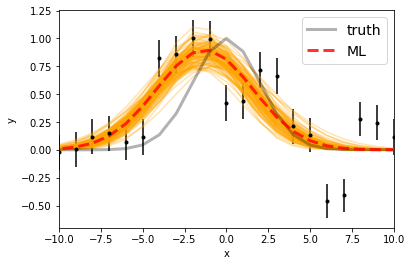

Maximum likelihood estimates:
x0 = -1.291
A = 0.898
s = 2.877


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4859.69197104317 [0.32586068 0.33363826]
A  =  1.5140541544635942e-17 [1.42668786e-18 1.45185378e-18]
s  =  2.889611558845315 [0.27968295 0.29749379]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


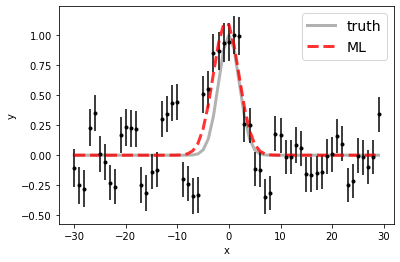

100%|██████████| 15000/15000 [00:18<00:00, 791.87it/s]


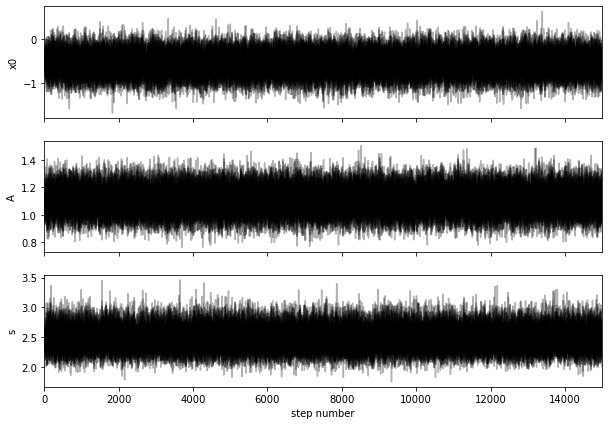

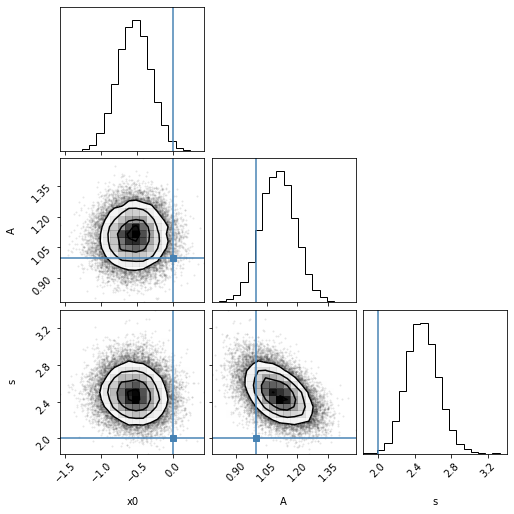

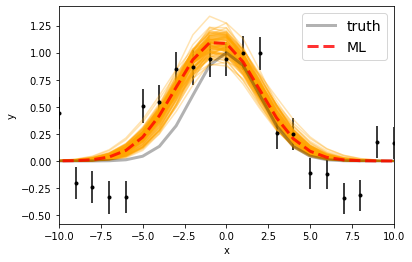

Maximum likelihood estimates:
x0 = -0.546
A = 1.111
s = 2.474


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.45963025127 [0.23551663 0.23109124]
A  =  1.8300505496045944e-17 [1.37956083e-18 1.41564100e-18]
s  =  2.4781377327706315 [0.16664186 0.1779604 ]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


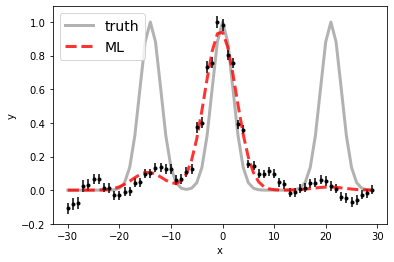

100%|██████████| 15000/15000 [00:31<00:00, 479.25it/s]


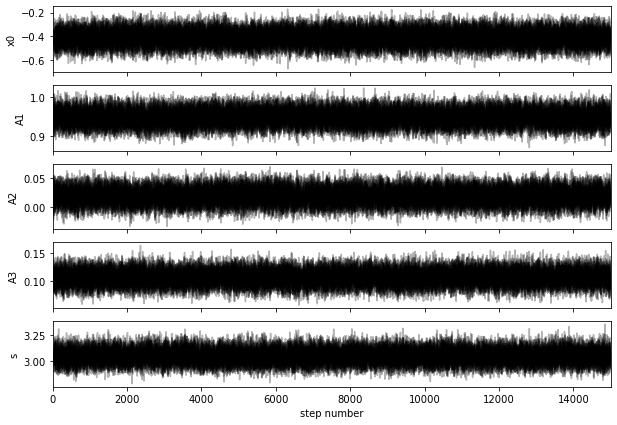

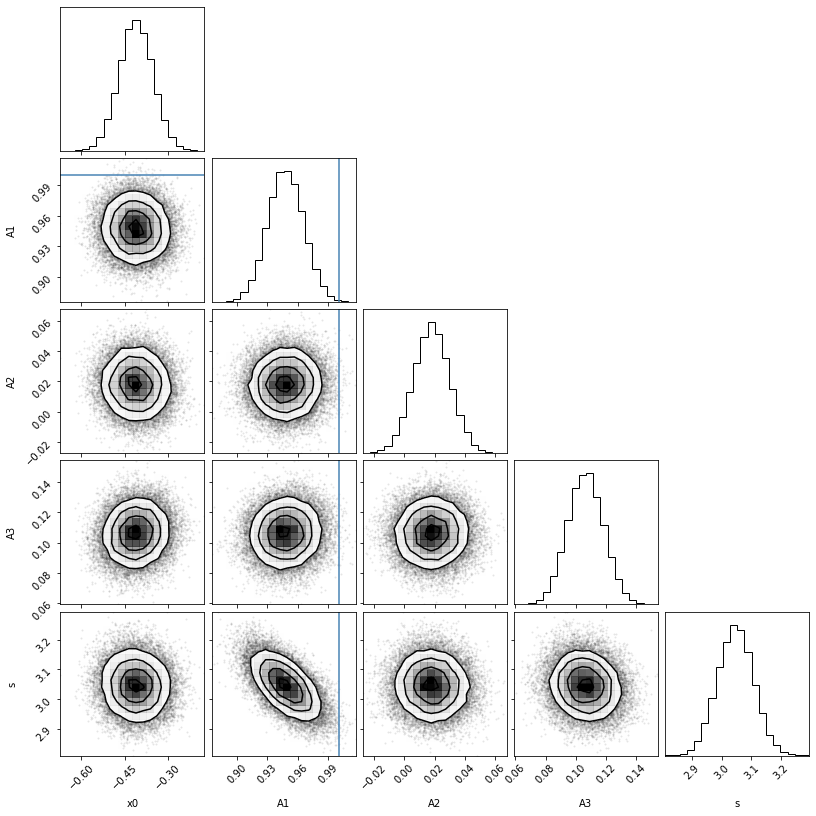

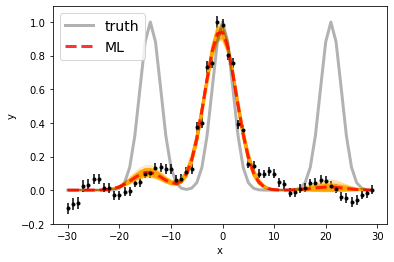

Maximum likelihood estimates:
x0 = -0.411
A1 = 0.948
A2 = 0.018
A3 = 0.107
s = 3.046


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.588945186215 6583.588945186215 [0.05749304 0.05848244]
A1, A2   =  4.139565456472833e-17 7.920011279296732e-19 [7.67942226e-19 7.71187599e-19] [5.22225752e-19 5.21436010e-19]
s  =  3.0463002020058423 [0.06062864 0.06036312]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 1

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


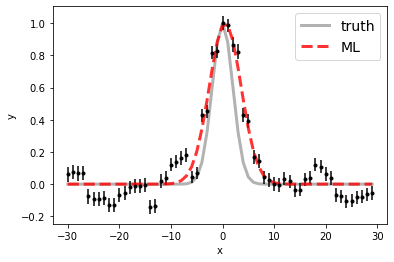

100%|██████████| 15000/15000 [00:17<00:00, 845.28it/s]


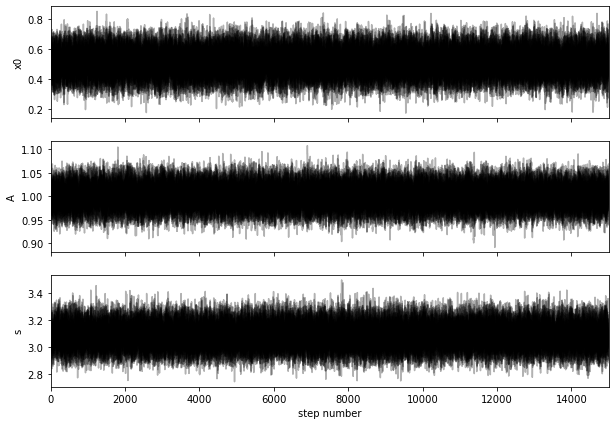

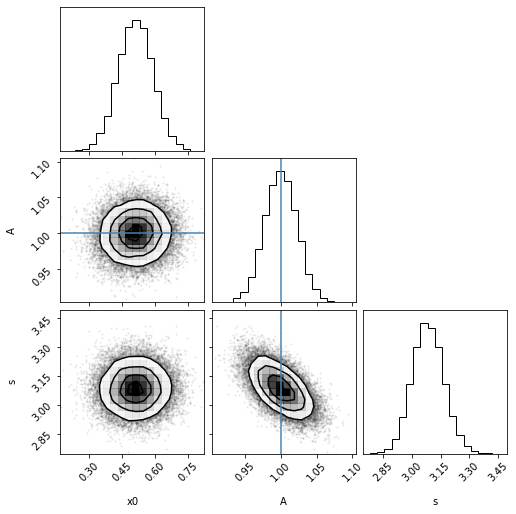

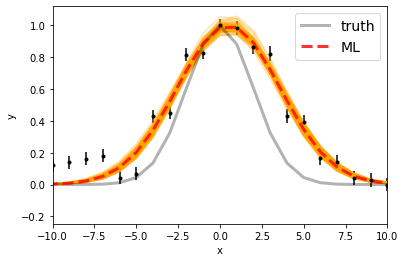

Maximum likelihood estimates:
x0 = 0.513
A = 1.001
s = 3.081


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.512259535156 [0.08035992 0.07881721]
A  =  7.147929592859312e-17 [1.63048125e-18 1.63058170e-18]
s  =  3.083500864035038 [0.07954346 0.08262715]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


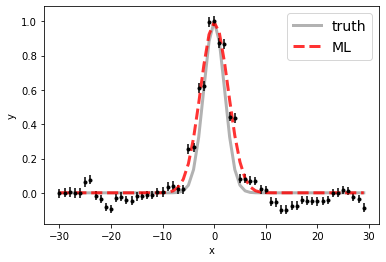

100%|██████████| 15000/15000 [00:18<00:00, 793.46it/s]


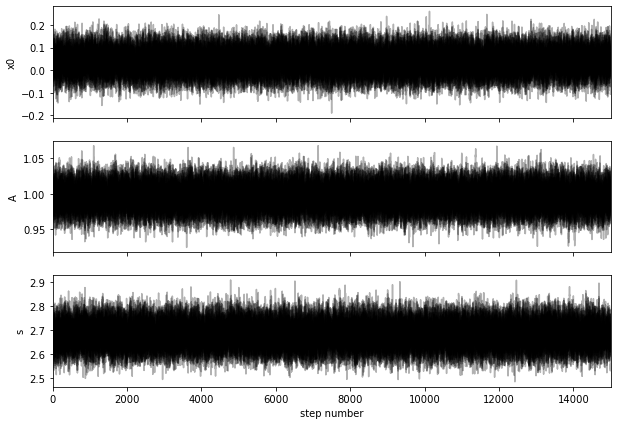

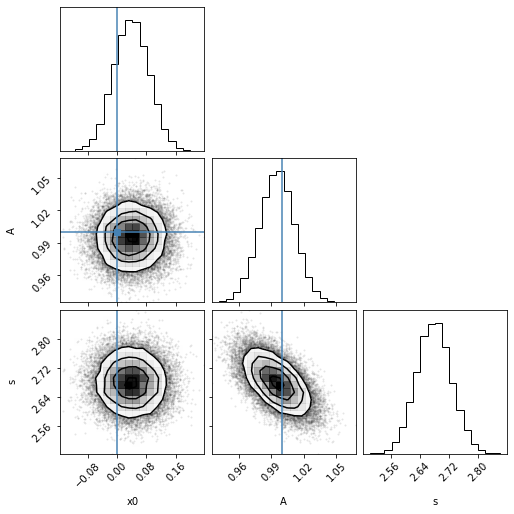

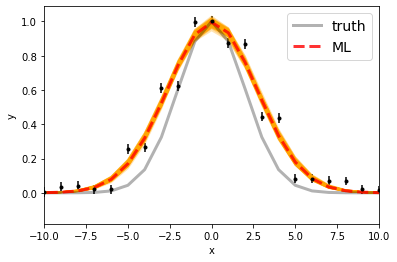

Maximum likelihood estimates:
x0 = 0.040
A = 0.995
s = 2.678


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5007.0387894629785 [0.04800166 0.04849623]
A  =  1.0631645445439725e-16 [1.71946648e-18 1.71149156e-18]
s  =  2.679234596613 [0.04770471 0.04739247]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


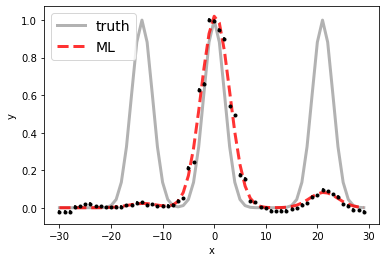

100%|██████████| 15000/15000 [00:30<00:00, 485.25it/s]


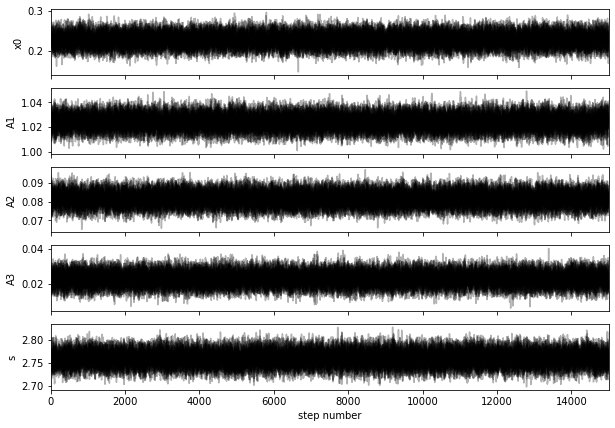

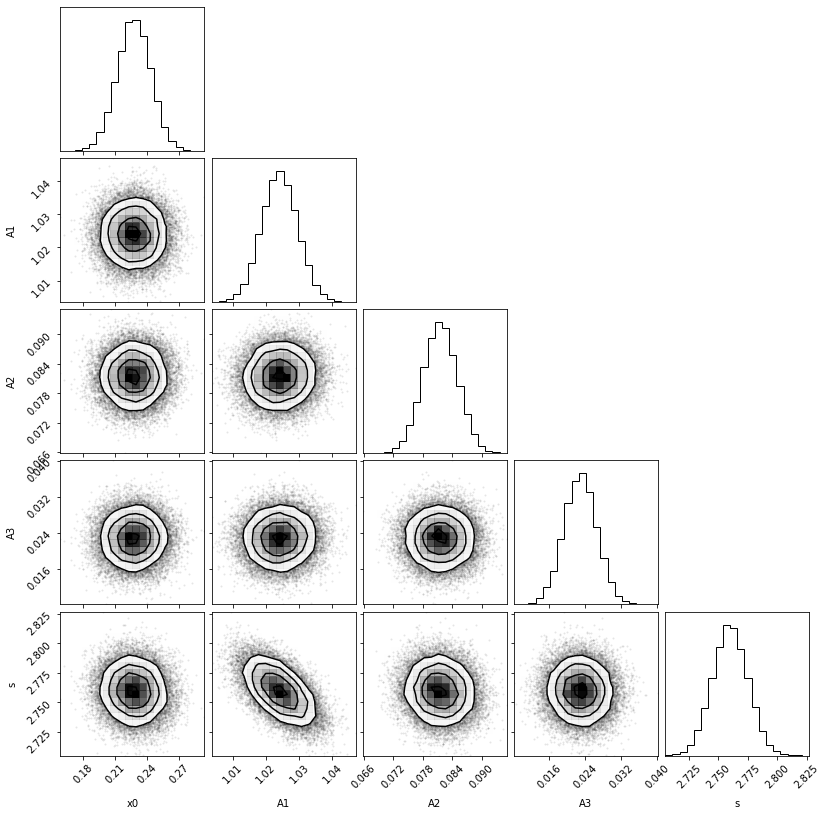

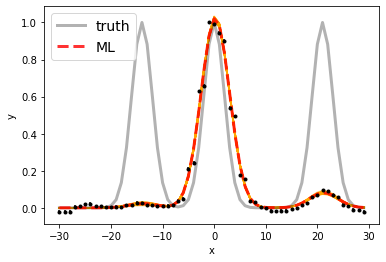

Maximum likelihood estimates:
x0 = 0.228
A1 = 1.024
A2 = 0.082
A3 = 0.023
s = 2.760


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6563.227672825619 6584.227672825619 [0.01580122 0.0158041 ]
A1, A2   =  1.863001270693849e-16 1.482935509436211e-17 [9.90922069e-19 9.91801675e-19] [6.27285009e-19 6.39119653e-19]
s  =  2.759731628582102 [0.01471003 0.01492947]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 2

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


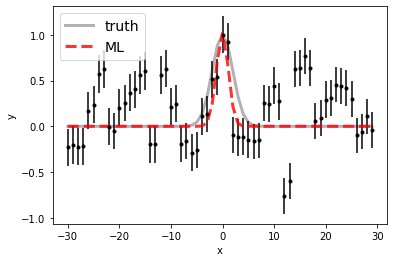

100%|██████████| 15000/15000 [00:20<00:00, 739.57it/s]


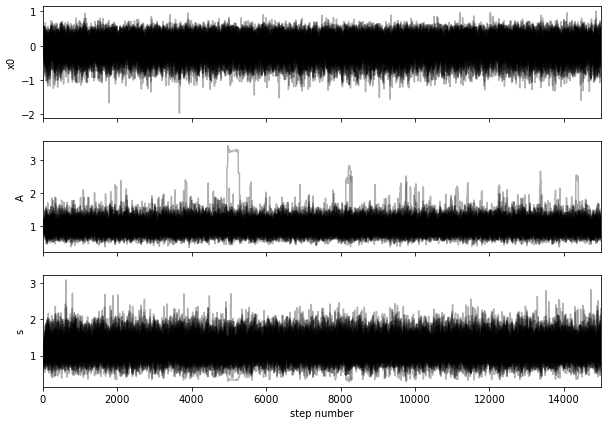

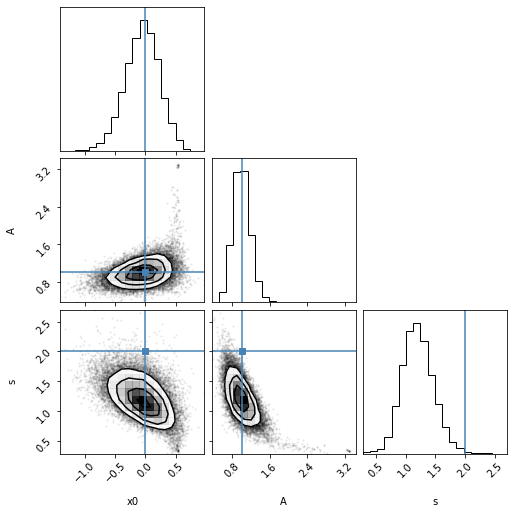

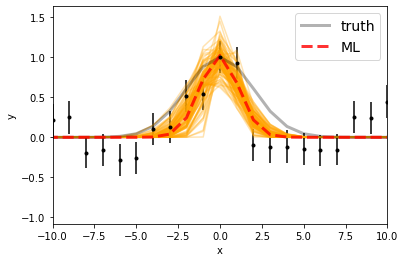

Maximum likelihood estimates:
x0 = -0.041
A = 1.021
s = 1.158


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.954537195104 [0.29276512 0.26558186]
A  =  1.447315802635019e-17 [2.48715241e-18 2.73059626e-18]
s  =  1.1897429270550768 [0.24364305 0.27401807]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


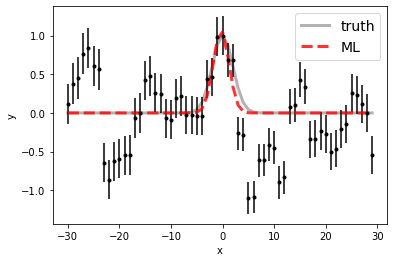

100%|██████████| 15000/15000 [00:17<00:00, 870.89it/s]


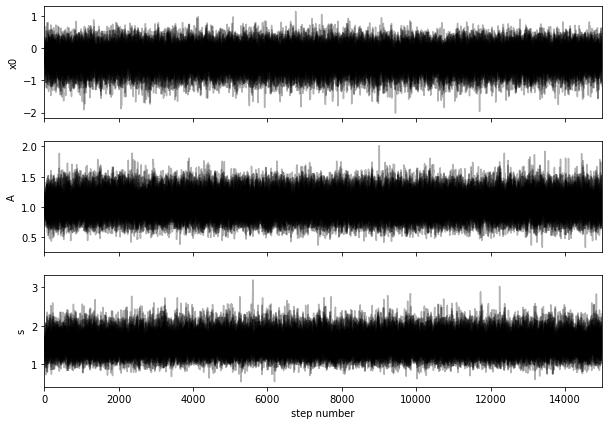

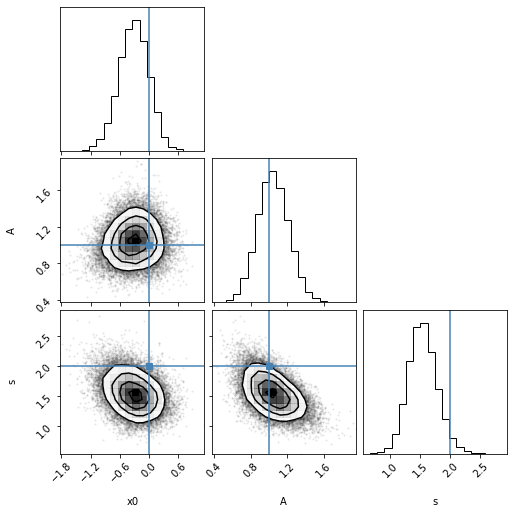

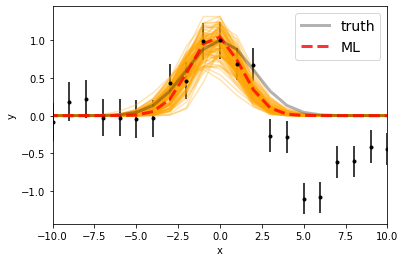

Maximum likelihood estimates:
x0 = -0.288
A = 1.064
s = 1.520


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.686768572276 [0.31011711 0.30610472]
A  =  1.1091282818250758e-17 [1.75255200e-18 1.88554781e-18]
s  =  1.5275157749270978 [0.22350035 0.24474367]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


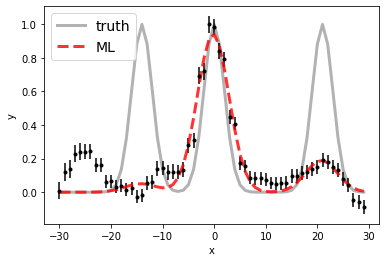

100%|██████████| 15000/15000 [00:27<00:00, 553.15it/s]


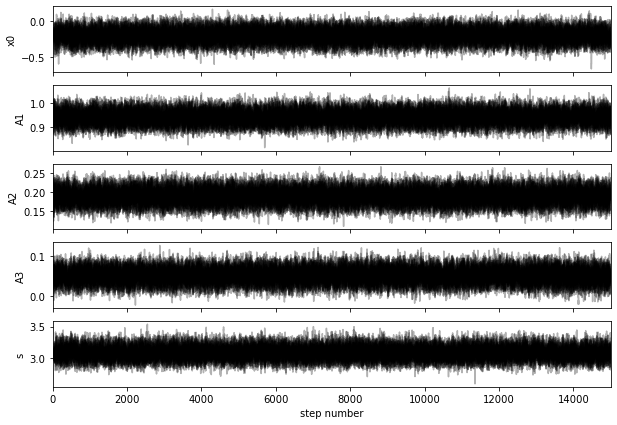

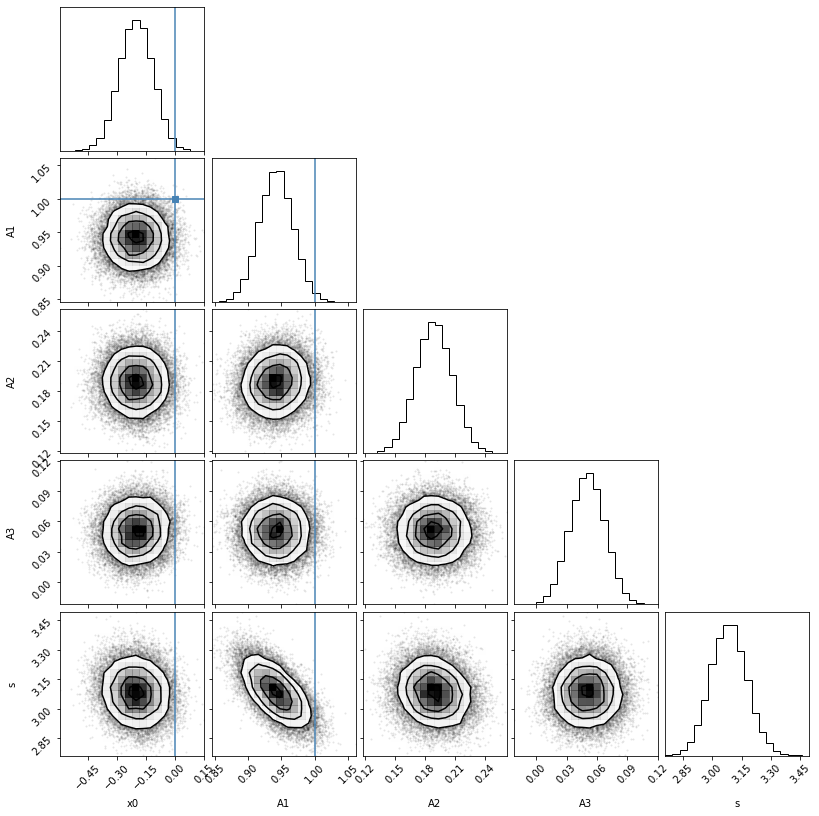

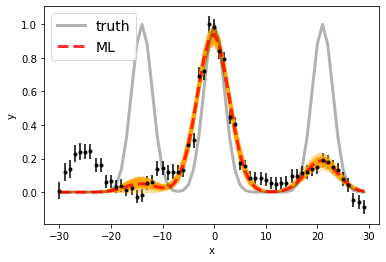

Maximum likelihood estimates:
x0 = -0.202
A1 = 0.942
A2 = 0.189
A3 = 0.050
s = 3.081


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.798369947816 6583.798369947816 [0.08604029 0.08632131]
A1, A2   =  2.96260861116894e-17 5.9349809829955066e-18 [8.03936142e-19 7.92196708e-19] [5.70181900e-19 5.77059913e-19]
s  =  3.0834617069652928 [0.0912868 0.0922172]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 3

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


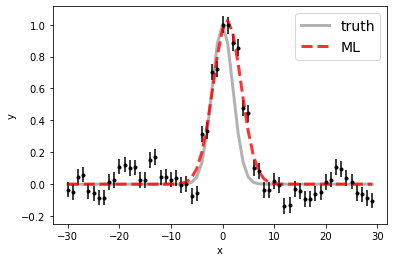

100%|██████████| 15000/15000 [00:19<00:00, 785.51it/s]


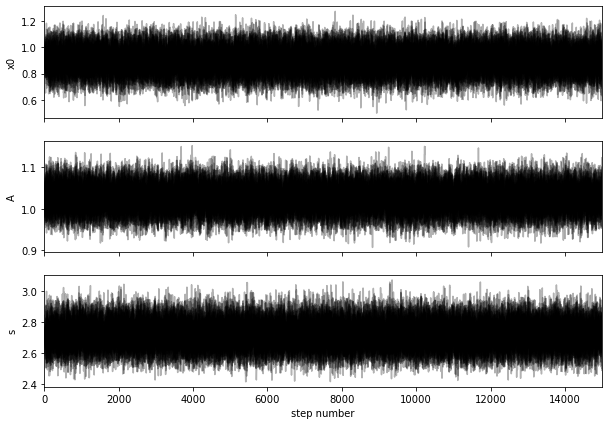

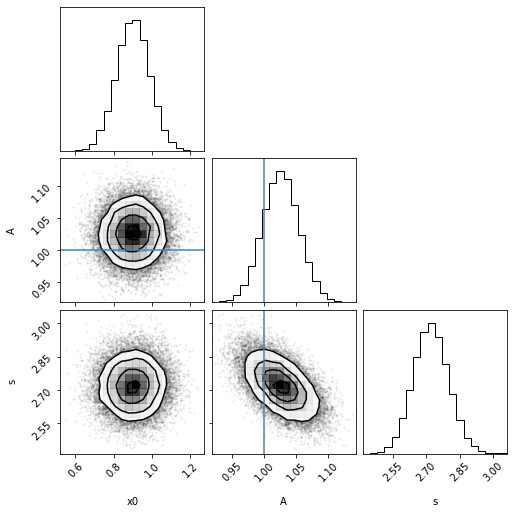

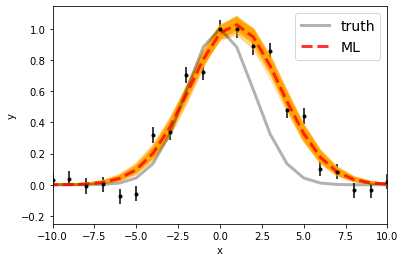

Maximum likelihood estimates:
x0 = 0.900
A = 1.027
s = 2.717


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.900681122334 [0.0865755 0.0851153]
A  =  5.419085812605296e-17 [1.50077311e-18 1.50514613e-18]
s  =  2.719126521441573 [0.07732246 0.07938989]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


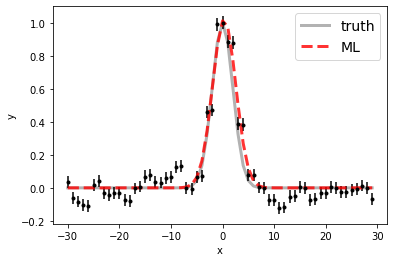

100%|██████████| 15000/15000 [00:17<00:00, 845.73it/s]


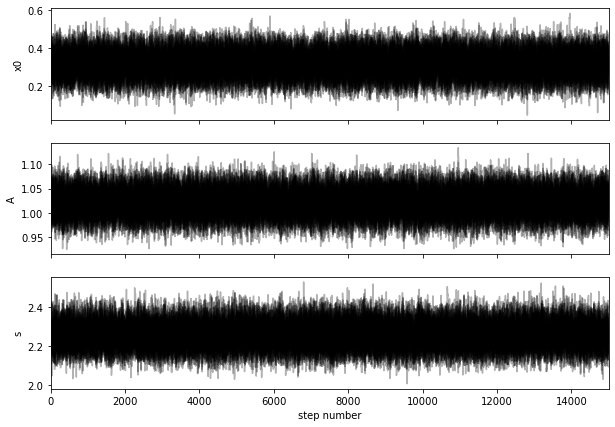

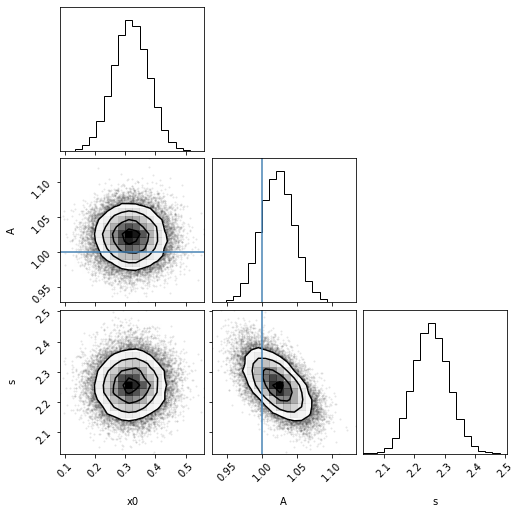

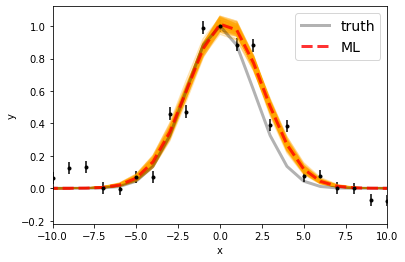

Maximum likelihood estimates:
x0 = 0.318
A = 1.022
s = 2.255


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5007.318518281233 [0.05874864 0.05926137]
A  =  6.767338132341654e-17 [1.5756436e-18 1.5673014e-18]
s  =  2.255586242099473 [0.05724604 0.05908962]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


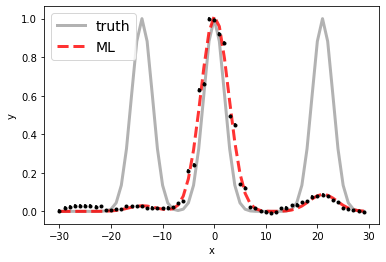

100%|██████████| 15000/15000 [00:25<00:00, 581.60it/s]


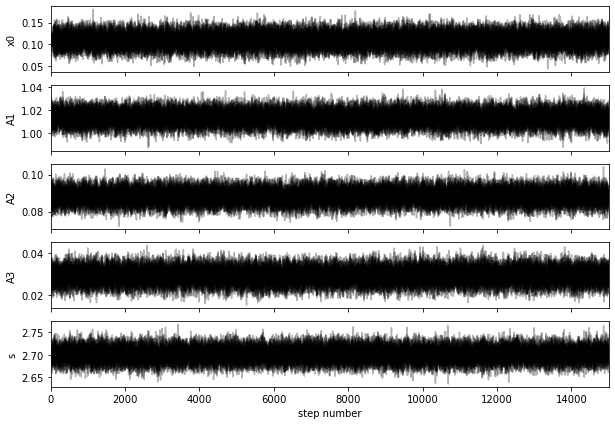

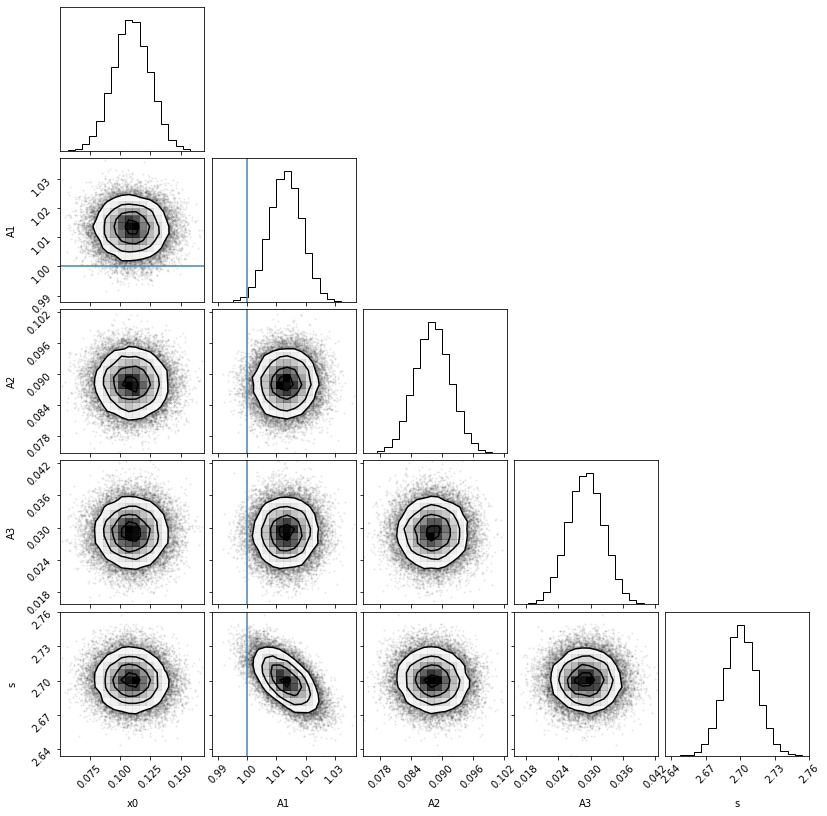

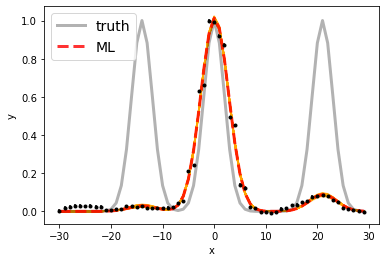

Maximum likelihood estimates:
x0 = 0.109
A1 = 1.013
A2 = 0.088
A3 = 0.029
s = 2.700


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6563.109288809812 6584.109288809812 [0.01505152 0.01527422]
A1, A2   =  1.746794702935104e-16 1.5216082751388724e-17 [9.61486902e-19 9.58639264e-19] [6.01210953e-19 5.94970981e-19]
s  =  2.70017809457283 [0.01391187 0.01418512]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 4

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


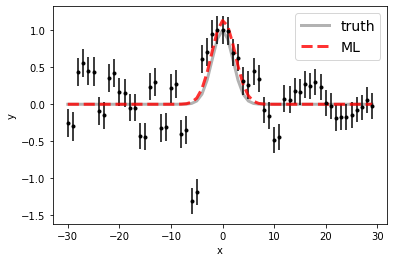

100%|██████████| 15000/15000 [00:17<00:00, 881.70it/s] 


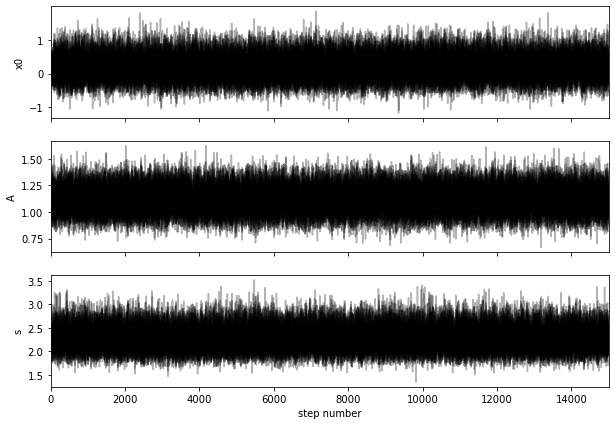

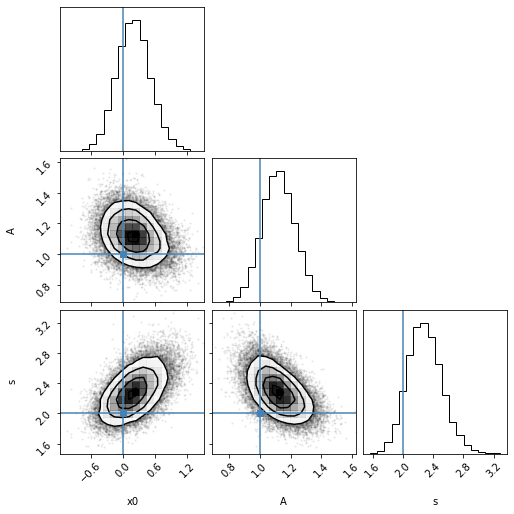

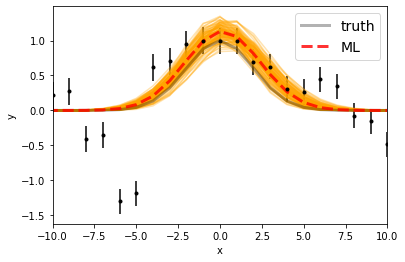

Maximum likelihood estimates:
x0 = 0.162
A = 1.132
s = 2.259


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.192821464992 [0.30882482 0.31917668]
A  =  1.770893345867574e-17 [1.65916080e-18 1.77319909e-18]
s  =  2.274848614508537 [0.21384589 0.23621724]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


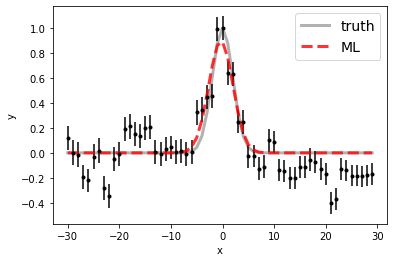

100%|██████████| 15000/15000 [00:19<00:00, 771.59it/s]


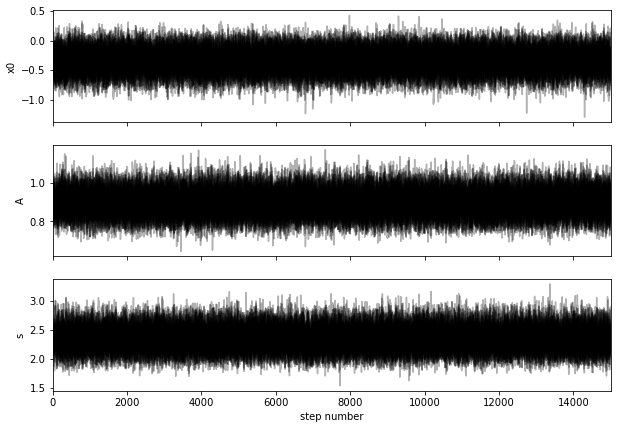

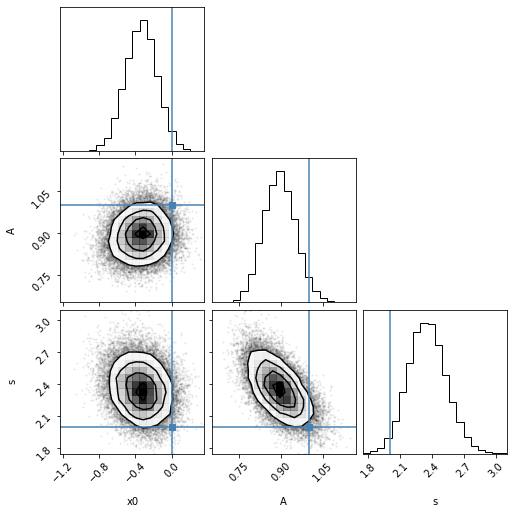

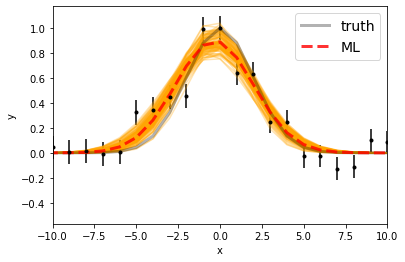

Maximum likelihood estimates:
x0 = -0.334
A = 0.899
s = 2.339


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.666414043421 [0.17857172 0.17080438]
A  =  2.5404137636970056e-17 [1.63743524e-18 1.65658026e-18]
s  =  2.3479794788828836 [0.17438714 0.18193826]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


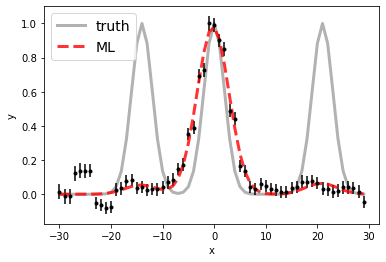

100%|██████████| 15000/15000 [00:26<00:00, 569.28it/s]


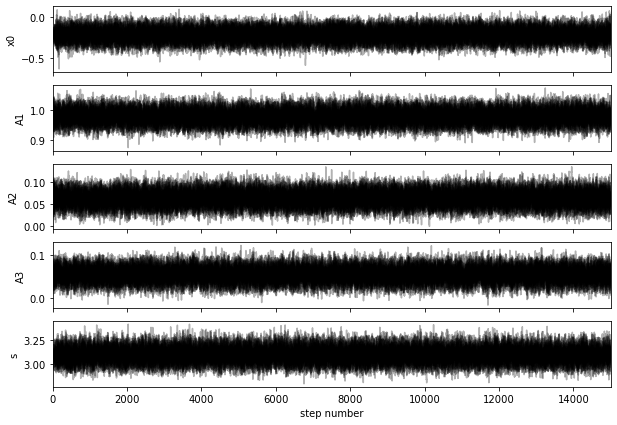

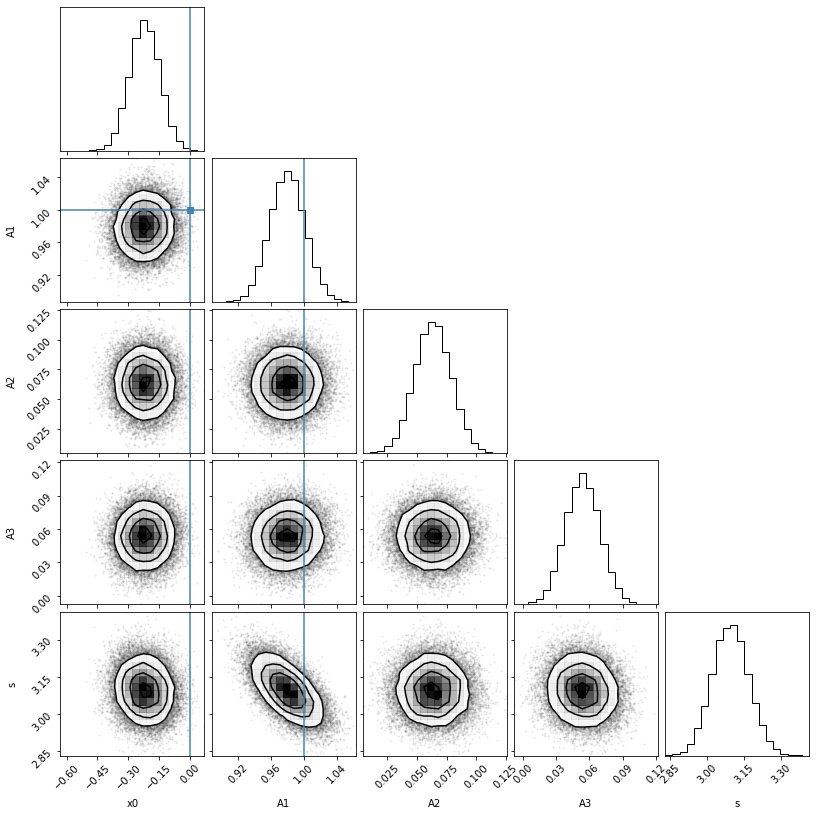

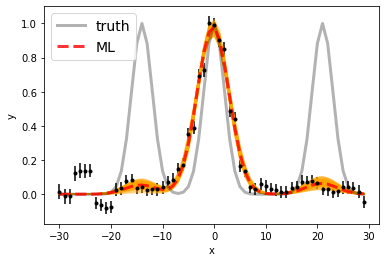

Maximum likelihood estimates:
x0 = -0.219
A1 = 0.980
A2 = 0.063
A3 = 0.054
s = 3.094


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.779948132576 6583.779948132576 [0.07259239 0.07300186]
A1, A2   =  3.665720090365608e-17 2.374156196099688e-18 [8.01862090e-19 8.05899295e-19] [5.75923676e-19 5.82828130e-19]
s  =  3.094646747308909 [0.07176976 0.07414264]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 5

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


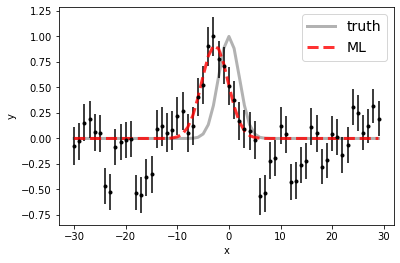

100%|██████████| 15000/15000 [00:20<00:00, 725.02it/s]


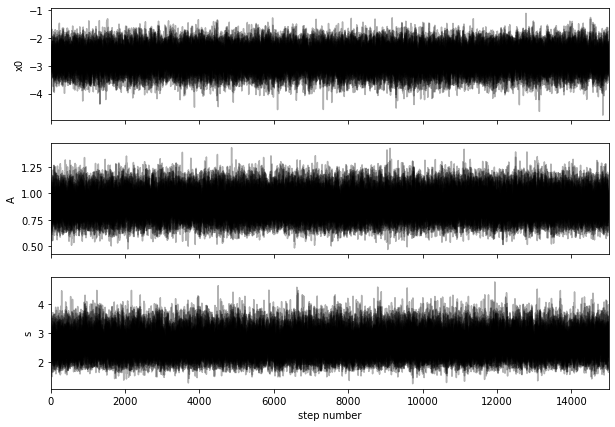

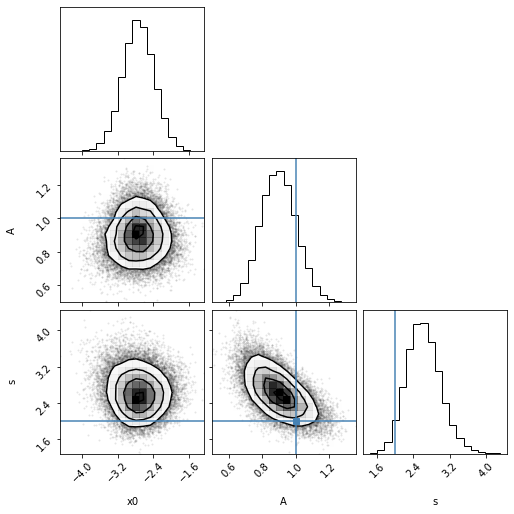

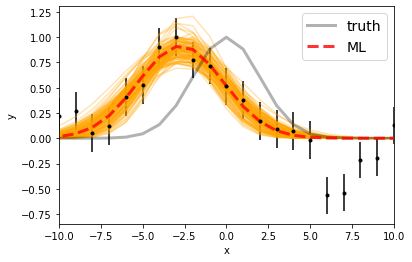

Maximum likelihood estimates:
x0 = -2.718
A = 0.914
s = 2.554


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4858.261393640034 [0.35194978 0.35315891]
A  =  1.2565323669639628e-17 [1.46982313e-18 1.53697149e-18]
s  =  2.601928848676428 [0.35038378 0.38786676]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


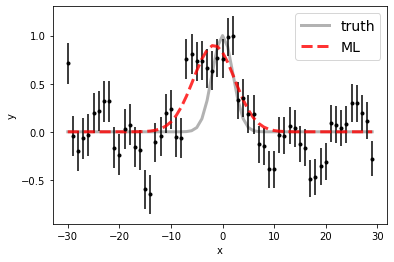

100%|██████████| 15000/15000 [00:16<00:00, 898.85it/s]


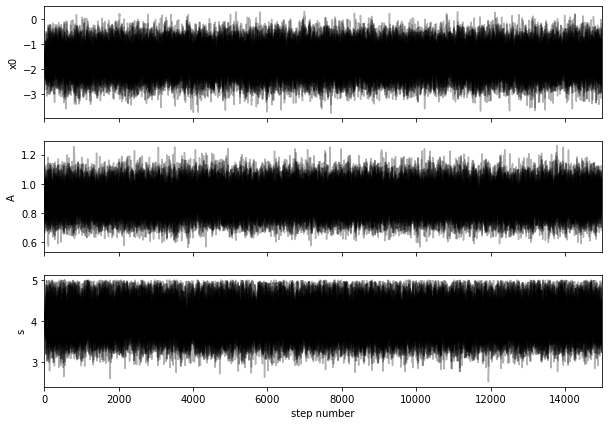

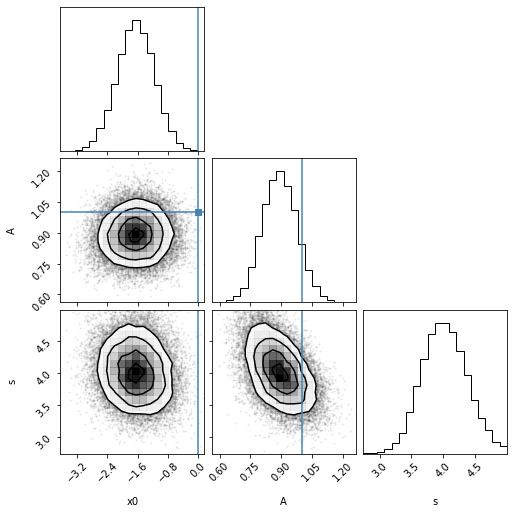

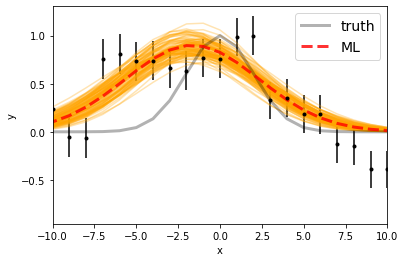

Maximum likelihood estimates:
x0 = -1.658
A = 0.899
s = 4.008


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5005.349978239446 [0.49336891 0.48430942]
A  =  9.964467432037993e-18 [9.25097257e-19 9.58567464e-19]
s  =  4.013631763480925 [0.33995929 0.36101472]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


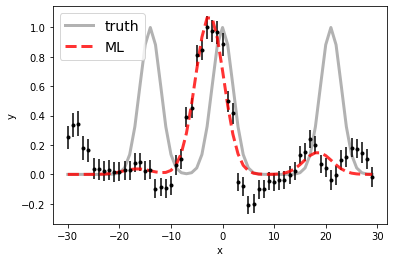

100%|██████████| 15000/15000 [00:24<00:00, 608.52it/s]


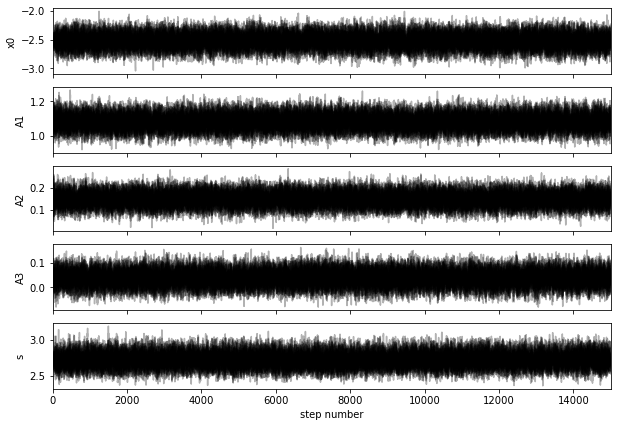

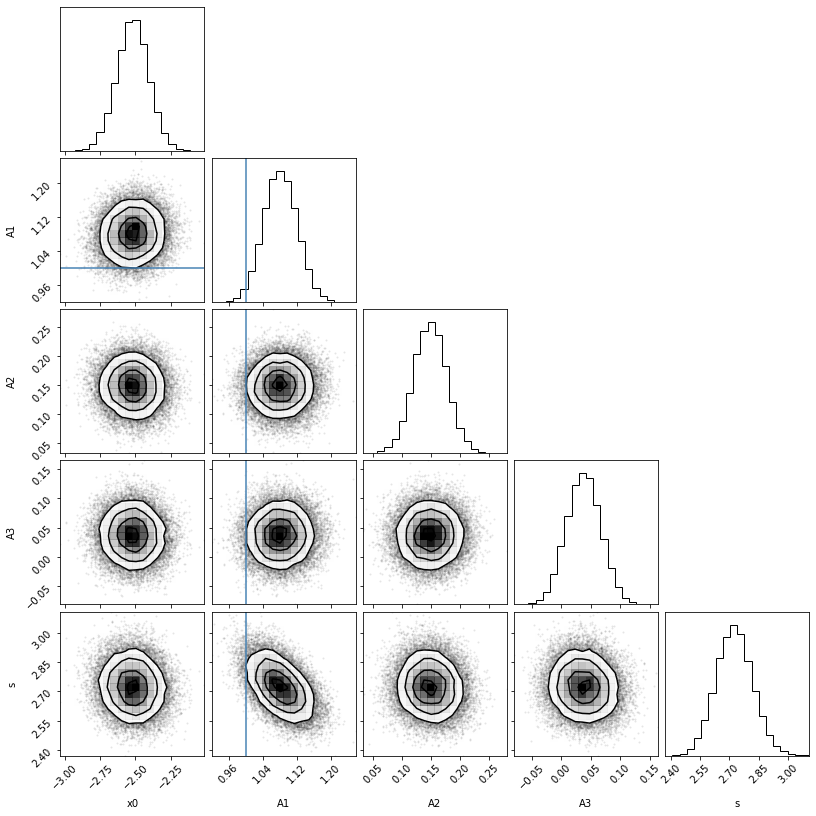

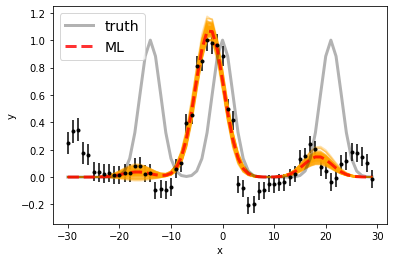

Maximum likelihood estimates:
x0 = -2.520
A1 = 1.082
A2 = 0.150
A3 = 0.038
s = 2.726


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6560.480389941718 6581.480389941718 [0.11388228 0.11184002]
A1, A2   =  1.9728408861796716e-17 2.7114182999492404e-18 [7.1452981e-19 7.1997617e-19] [5.10977242e-19 5.12978760e-19]
s  =  2.722848789072854 [0.09013518 0.09443339]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 6

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


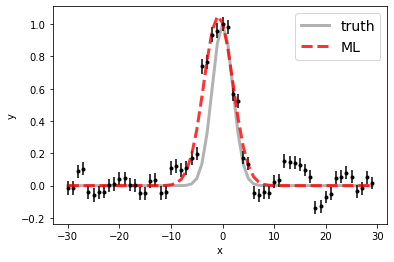

100%|██████████| 15000/15000 [00:17<00:00, 880.91it/s]


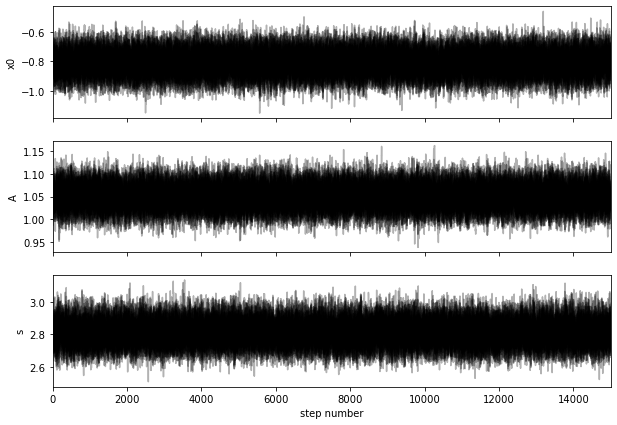

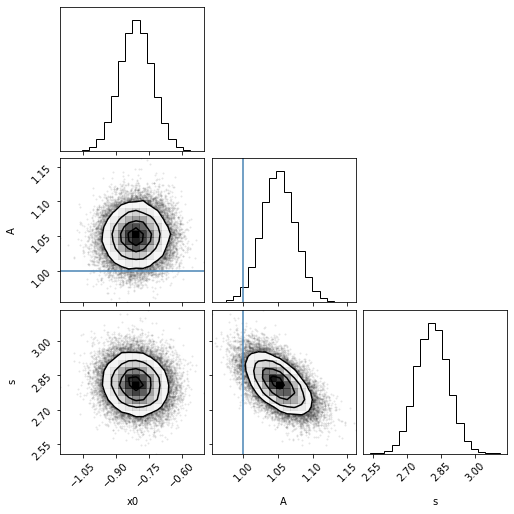

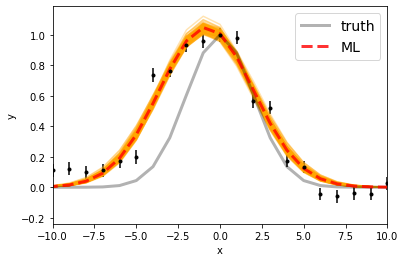

Maximum likelihood estimates:
x0 = -0.808
A = 1.051
s = 2.809


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.191111302061 [0.07360358 0.0733161 ]
A  =  6.882914750929605e-17 [1.56115220e-18 1.59483825e-18]
s  =  2.8117762588811375 [0.06886695 0.06960555]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


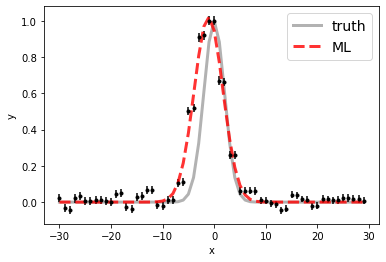

100%|██████████| 15000/15000 [00:18<00:00, 833.25it/s]


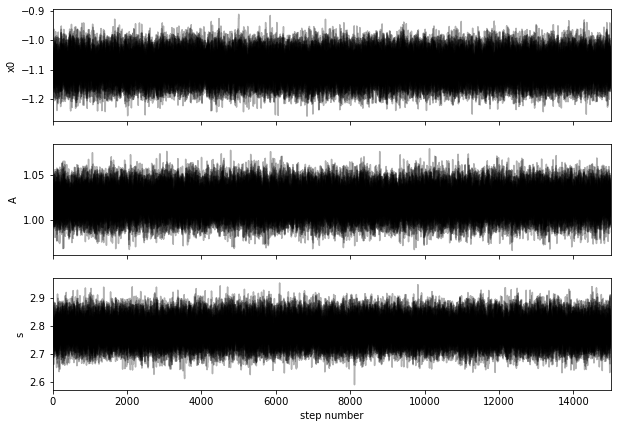

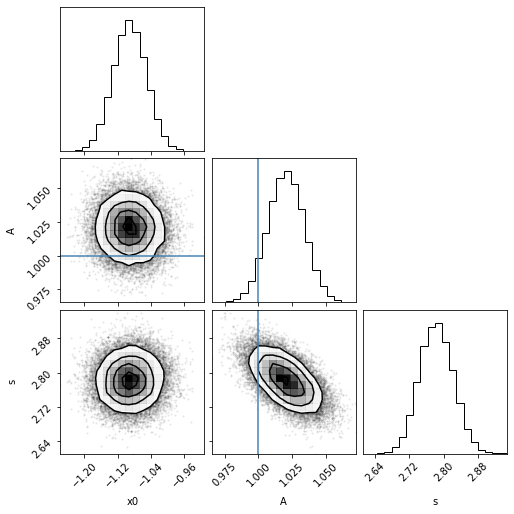

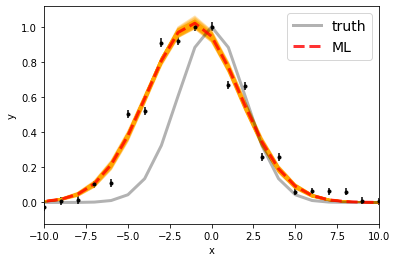

Maximum likelihood estimates:
x0 = -1.091
A = 1.021
s = 2.782


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5005.908573608369 [0.03975016 0.04024651]
A  =  1.160756159126116e-16 [1.53225091e-18 1.52157601e-18]
s  =  2.7822395650983855 [0.0384433  0.03959227]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


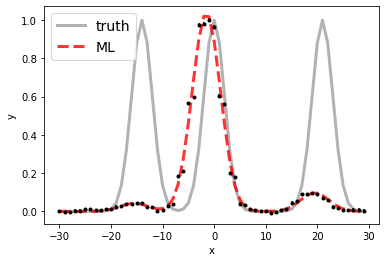

100%|██████████| 15000/15000 [00:25<00:00, 578.89it/s]


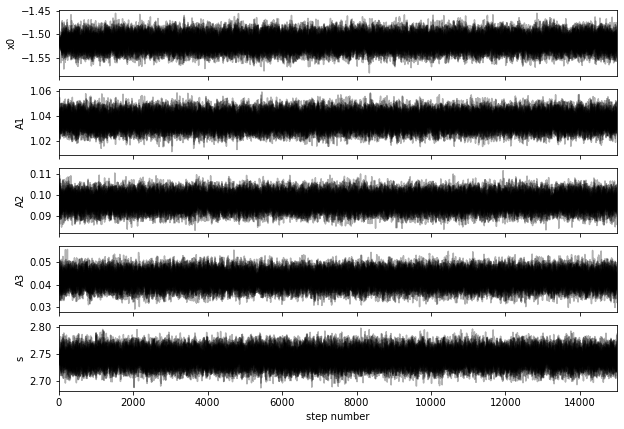

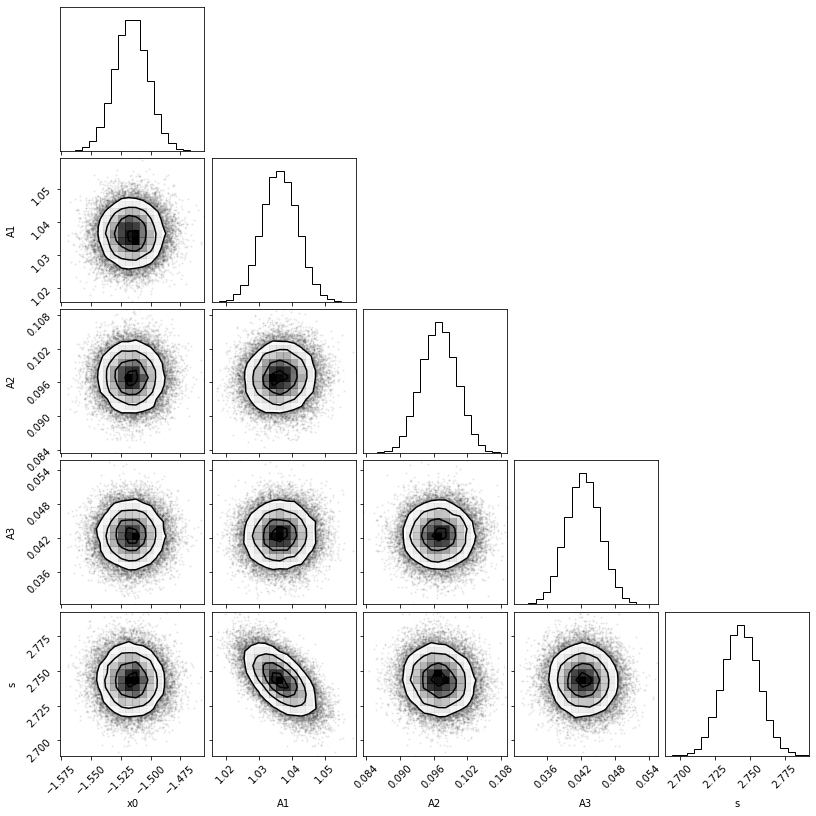

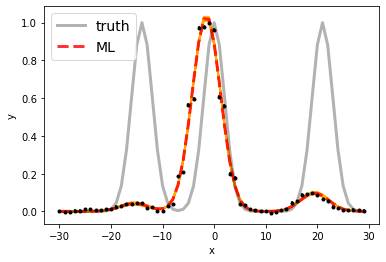

Maximum likelihood estimates:
x0 = -1.516
A1 = 1.036
A2 = 0.097
A3 = 0.042
s = 2.744


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.483678507237 6582.483678507237 [0.0138309  0.01382877]
A1, A2   =  1.9116455828258404e-16 1.7876007934699966e-17 [9.85349822e-19 9.87688029e-19] [5.84110812e-19 5.87082149e-19]
s  =  2.74335766593556 [0.01282303 0.01299241]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 7

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


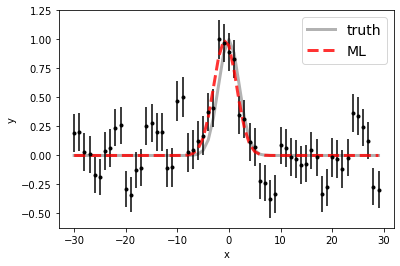

100%|██████████| 15000/15000 [00:17<00:00, 860.54it/s] 


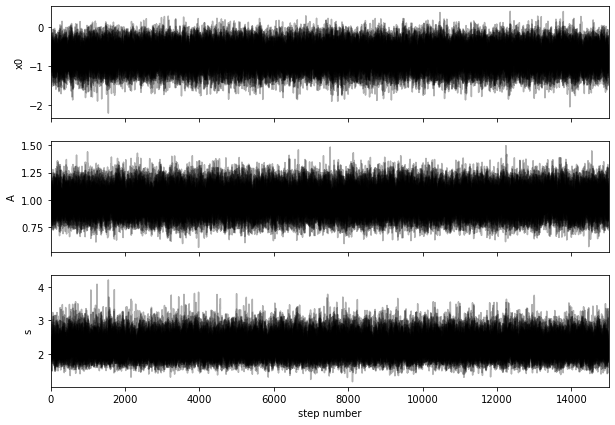

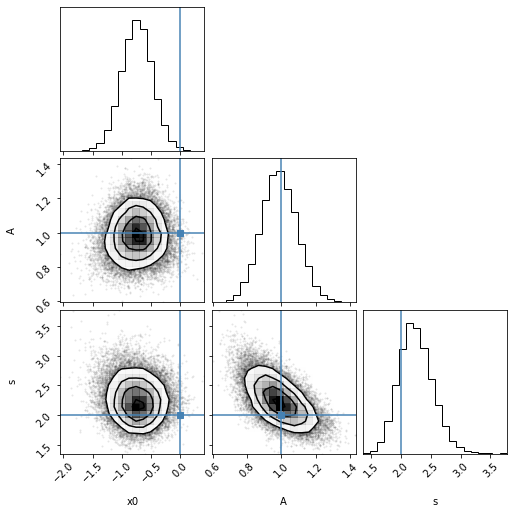

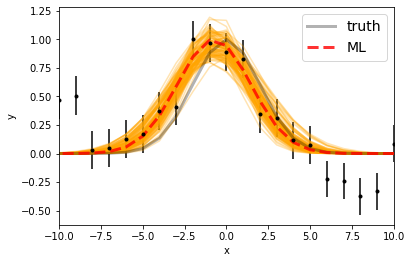

Maximum likelihood estimates:
x0 = -0.733
A = 1.001
s = 2.196


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.260203778975 [0.26635584 0.25844018]
A  =  1.5843120271413438e-17 [1.61305961e-18 1.71352987e-18]
s  =  2.2273013835852877 [0.26008931 0.29787555]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


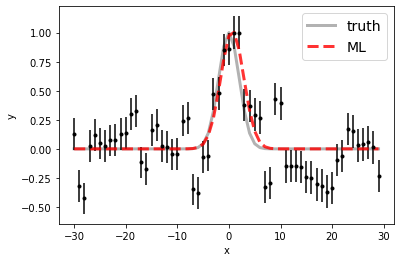

100%|██████████| 15000/15000 [00:16<00:00, 916.71it/s]


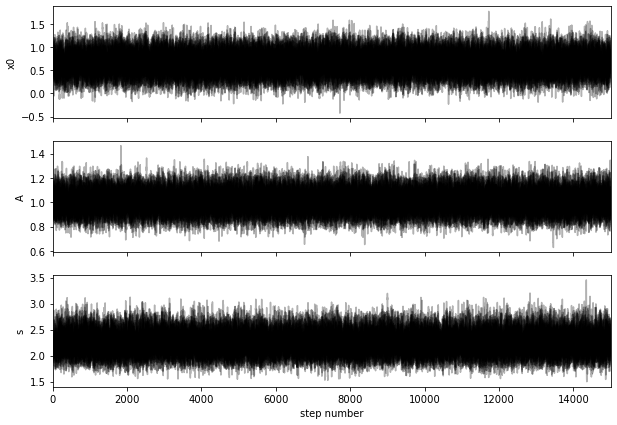

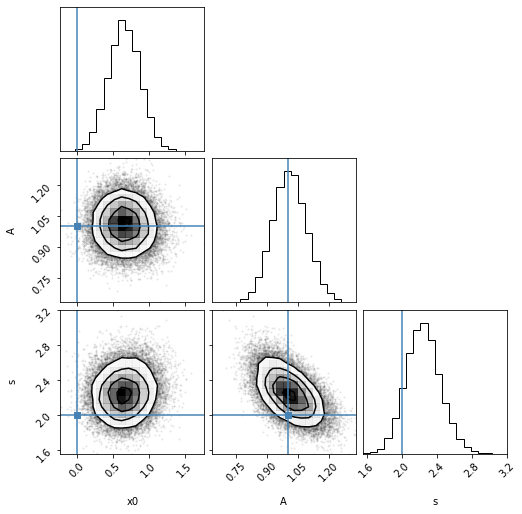

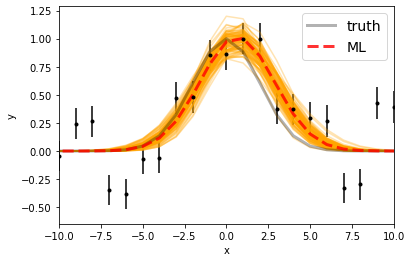

Maximum likelihood estimates:
x0 = 0.651
A = 1.015
s = 2.233


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5007.6558694877185 [0.21947728 0.2194678 ]
A  =  1.7546104461350467e-17 [1.43443225e-18 1.45608602e-18]
s  =  2.2402289029918734 [0.18821748 0.19957998]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


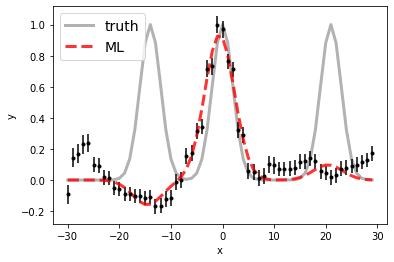

100%|██████████| 15000/15000 [00:28<00:00, 526.39it/s]


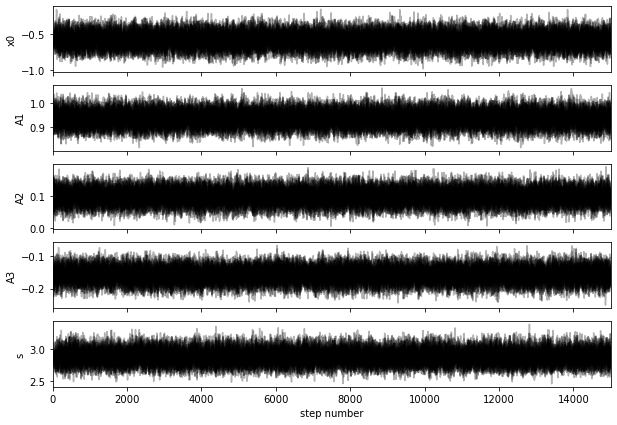

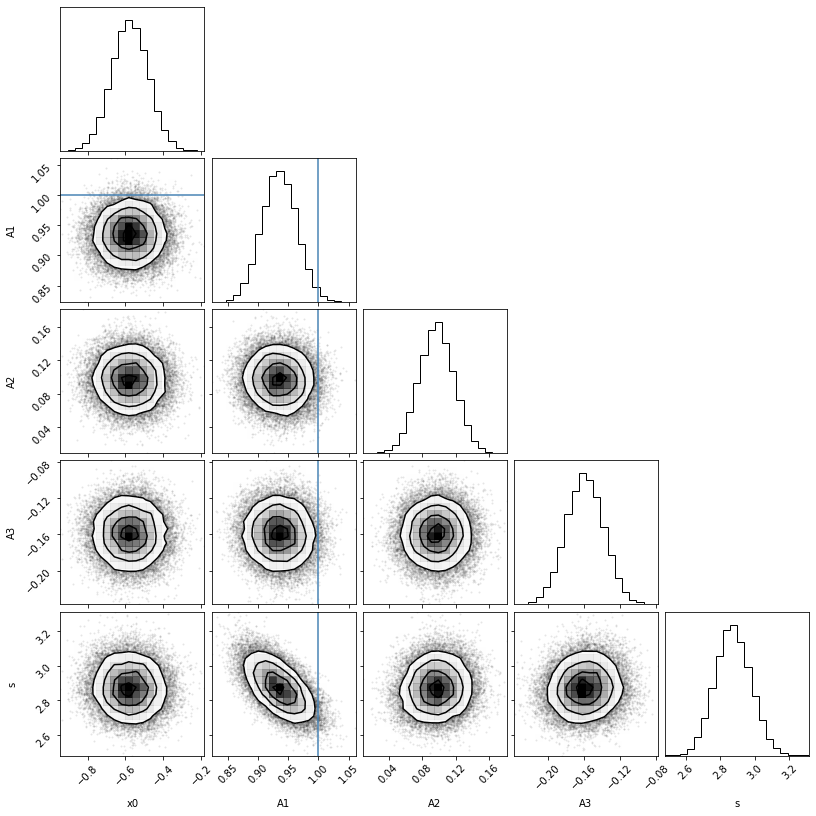

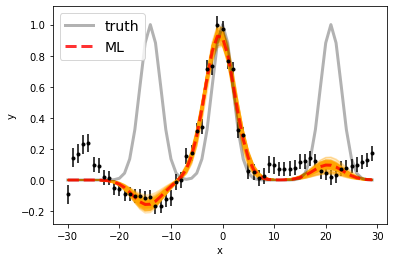

Maximum likelihood estimates:
x0 = -0.578
A1 = 0.936
A2 = 0.097
A3 = -0.159
s = 2.872


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.422526228173 6583.422526228173 [0.09542011 0.09567335]
A1, A2   =  2.5557160029647324e-17 2.649460665024935e-18 [7.97467022e-19 7.91339000e-19] [5.70460063e-19 5.71152995e-19]
s  =  2.8712040887061816 [0.09997505 0.10574119]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 8

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


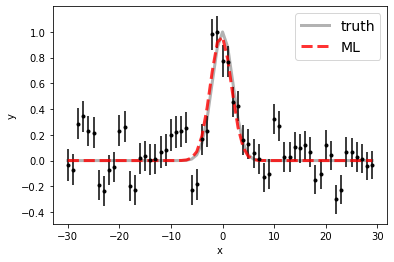

100%|██████████| 15000/15000 [00:16<00:00, 897.33it/s]


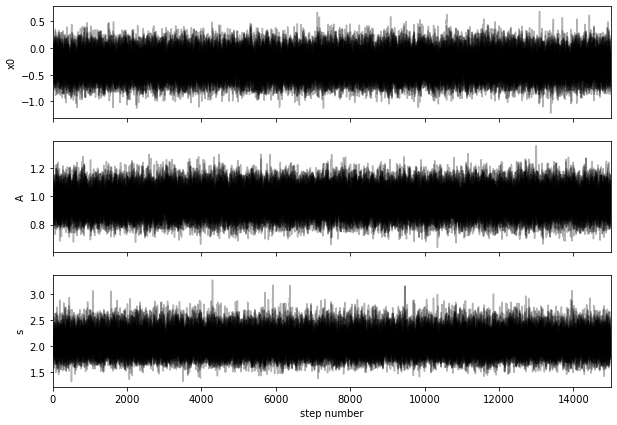

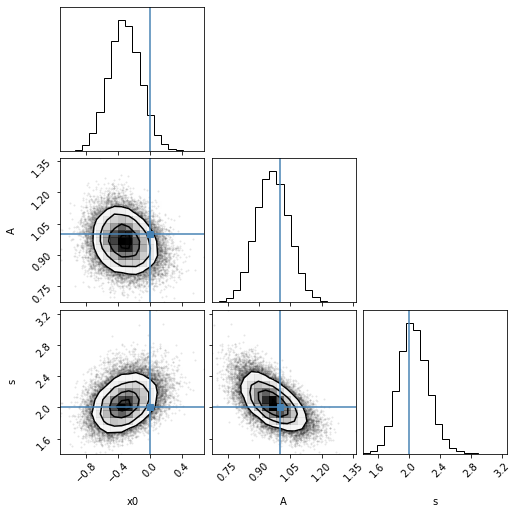

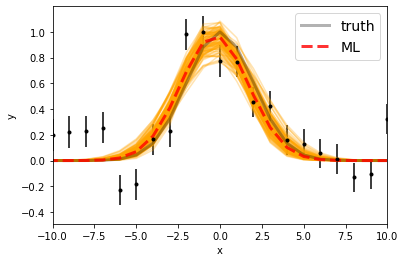

Maximum likelihood estimates:
x0 = -0.320
A = 0.973
s = 2.036


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.680668499435 [0.19484604 0.20455367]
A  =  1.9466323854783647e-17 [1.56842637e-18 1.61432550e-18]
s  =  2.0532022345580514 [0.17759059 0.19381304]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


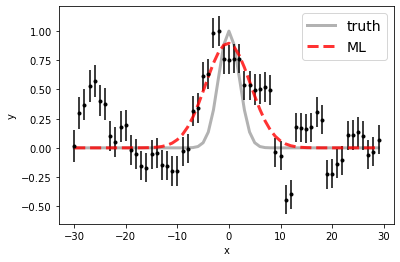

100%|██████████| 15000/15000 [00:16<00:00, 901.25it/s] 


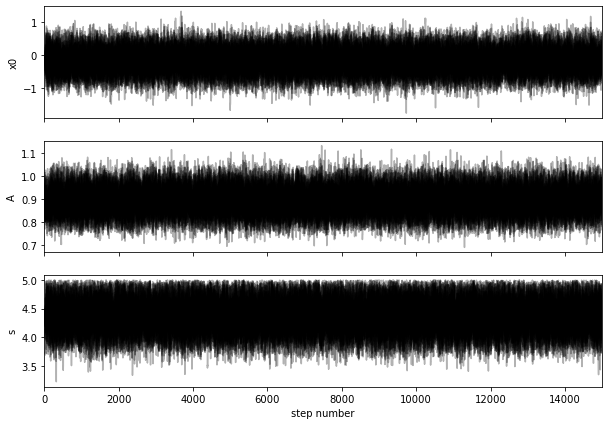

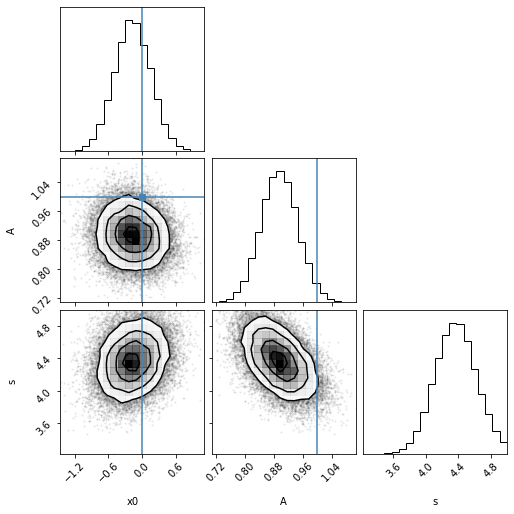

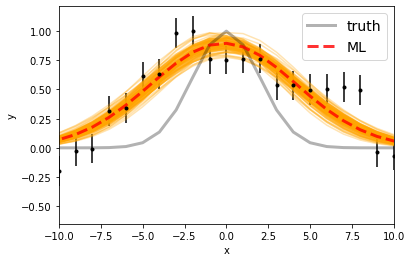

Maximum likelihood estimates:
x0 = -0.166
A = 0.897
s = 4.356


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.8289579603415 [0.3209682  0.32545149]
A  =  1.498949853063729e-17 [8.45045256e-19 8.62688719e-19]
s  =  4.365846115326818 [0.25405776 0.25542837]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


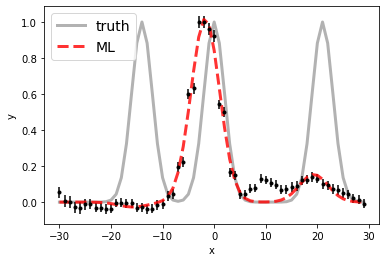

100%|██████████| 15000/15000 [00:25<00:00, 580.25it/s]


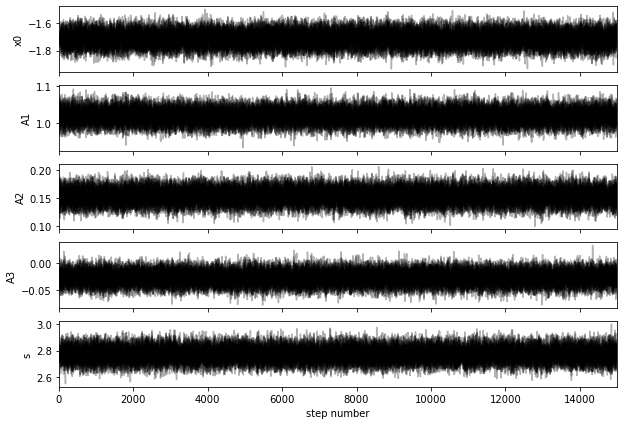

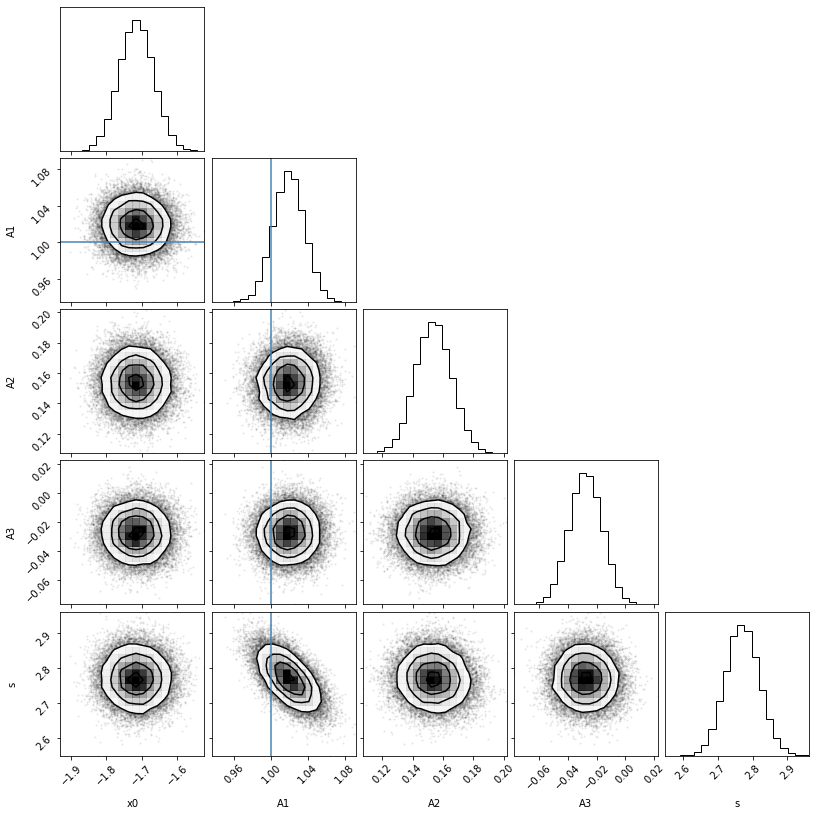

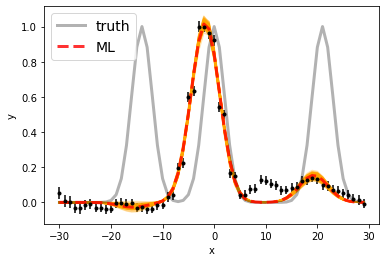

Maximum likelihood estimates:
x0 = -1.716
A1 = 1.020
A2 = 0.154
A3 = -0.027
s = 2.770


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.284321640303 6582.284321640303 [0.04799126 0.0485431 ]
A1, A2   =  4.7190414855161596e-17 7.115714442271712e-18 [7.90482607e-19 7.93016402e-19] [5.48978232e-19 5.49960570e-19]
s  =  2.7700504838678857 [0.04795679 0.04916105]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 9

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


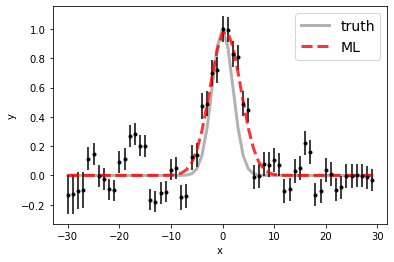

100%|██████████| 15000/15000 [00:45<00:00, 330.22it/s]


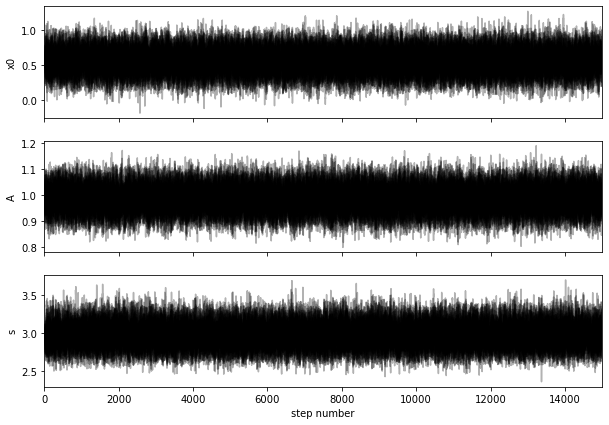

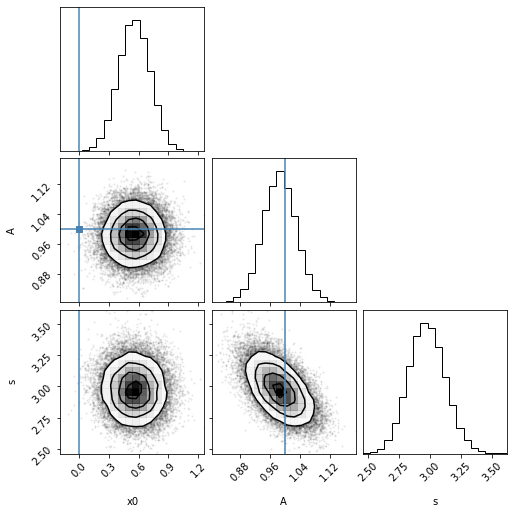

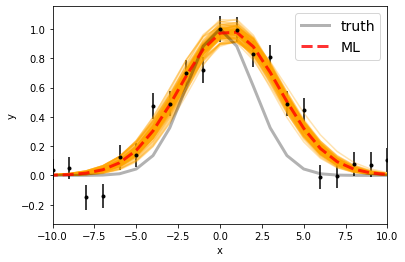

Maximum likelihood estimates:
x0 = 0.555
A = 0.988
s = 2.967


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.556896659752 [0.1589322 0.1571036]
A  =  3.100974046026462e-17 [1.39593801e-18 1.40733092e-18]
s  =  2.9726456346710703 [0.1439641  0.15017779]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


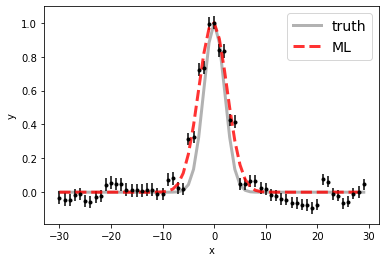

100%|██████████| 15000/15000 [00:45<00:00, 332.32it/s]


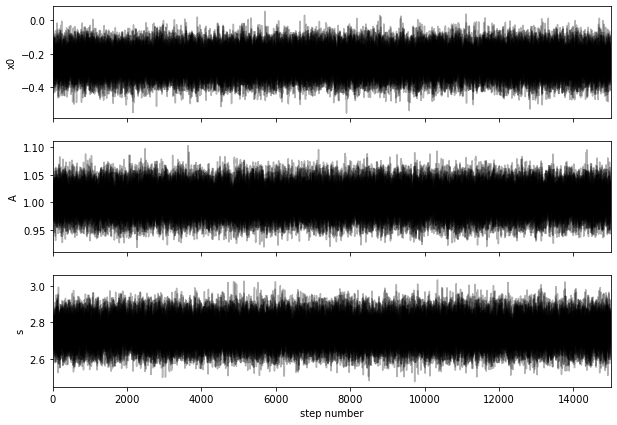

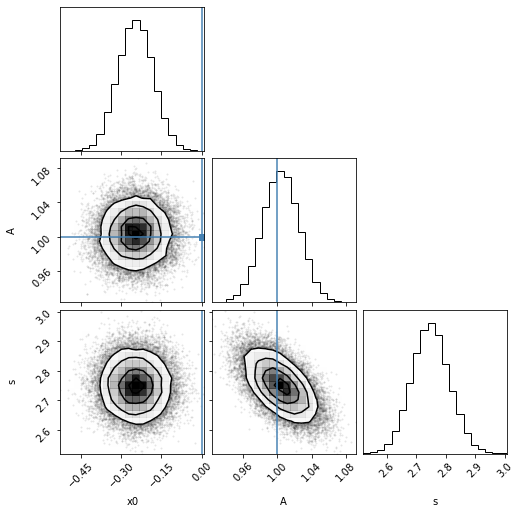

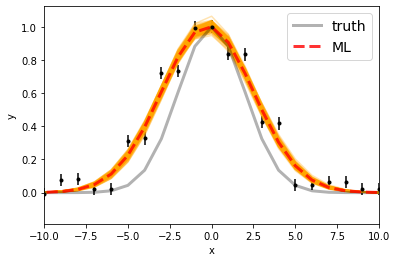

Maximum likelihood estimates:
x0 = -0.248
A = 1.004
s = 2.747


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.753163146635 [0.0661926  0.06509121]
A  =  6.54810601376027e-17 [1.38726398e-18 1.41013008e-18]
s  =  2.7481125522451704 [0.06262537 0.06446701]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


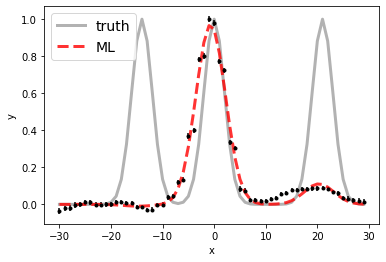

100%|██████████| 15000/15000 [01:09<00:00, 215.88it/s]


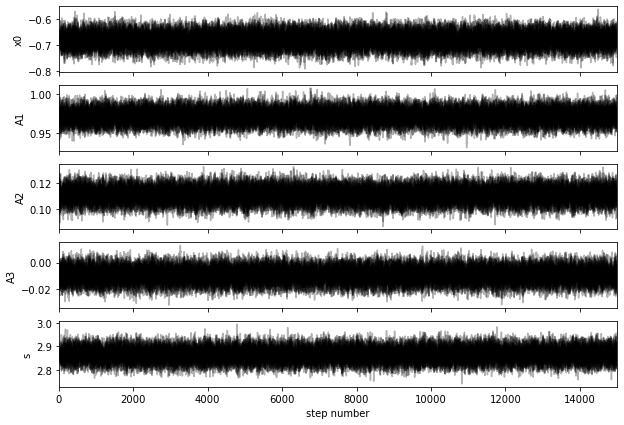

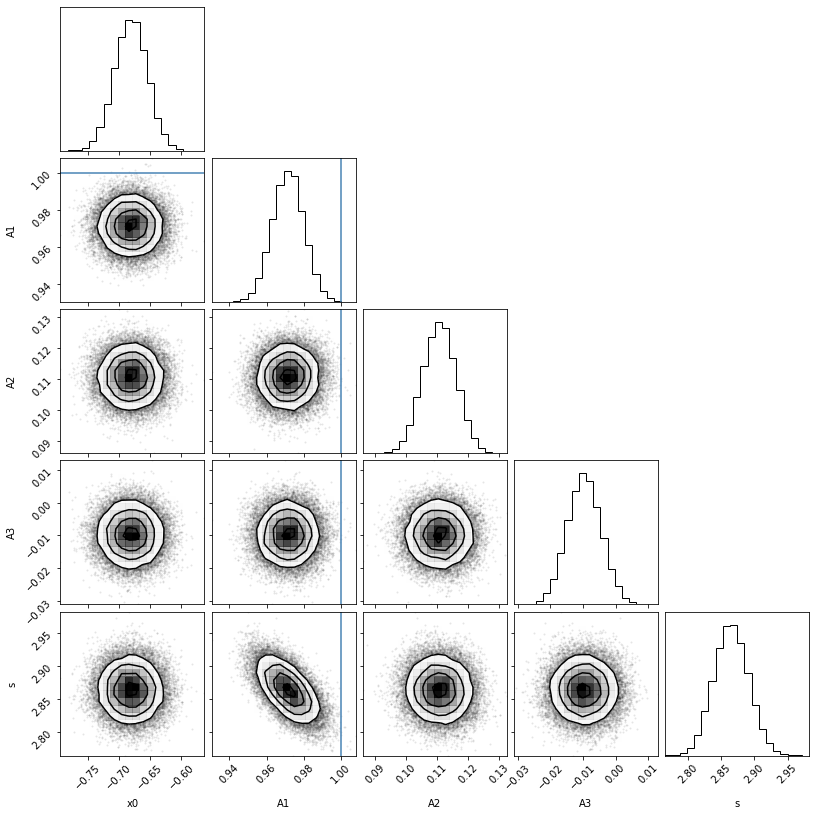

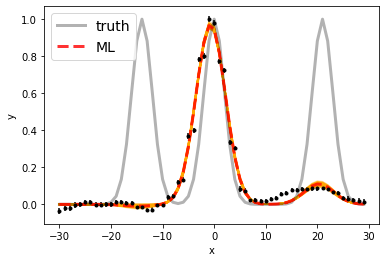

Maximum likelihood estimates:
x0 = -0.681
A1 = 0.971
A2 = 0.111
A3 = -0.010
s = 2.864


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.319197193957 6583.319197193957 [0.02614275 0.02577529]
A1, A2   =  9.716468374420707e-17 1.1081999135438032e-17 [8.51243303e-19 8.38855729e-19] [5.43190504e-19 5.33348624e-19]
s  =  2.8643157215853337 [0.02581692 0.02632208]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 10

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


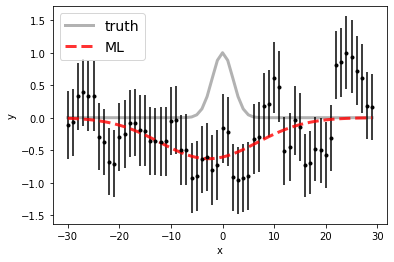

  0%|          | 0/15000 [00:00<?, ?it/s]C:\Users\saruk\anaconda3\lib\site-packages\emcee\moves\red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|██████████| 15000/15000 [00:22<00:00, 659.96it/s]


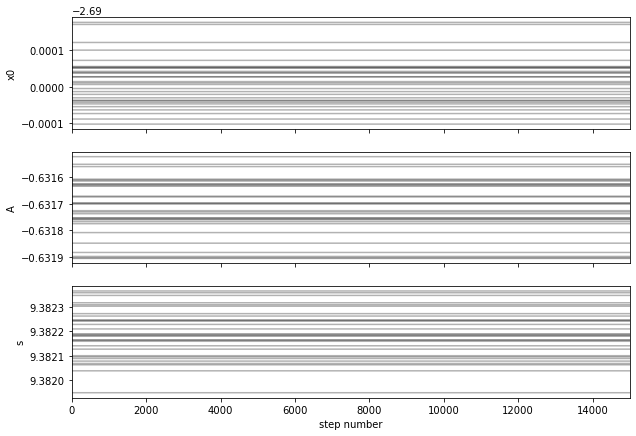

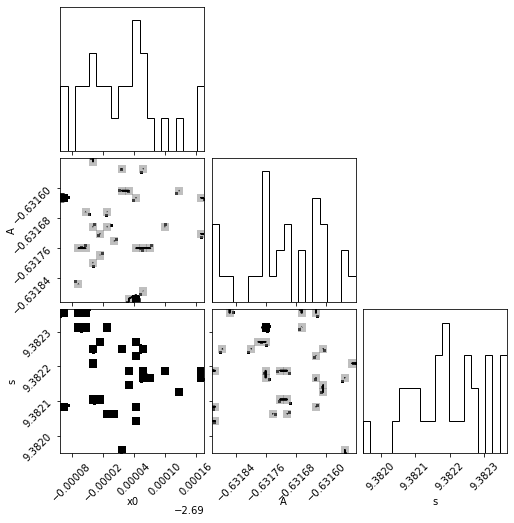

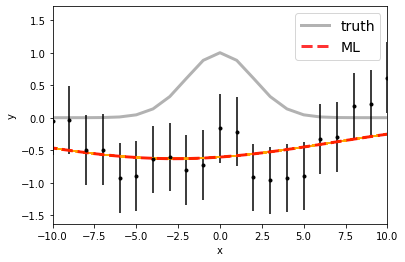

Maximum likelihood estimates:
x0 = -2.690
A = -0.632
s = 9.382


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4858.310012101452 [6.65926128e-05 5.96478124e-05]
A  =  -1.1197724595400246e-18 [2.39874720e-22 1.82171711e-22]
s  =  9.382184538371483 [0.00010653 0.00012385]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


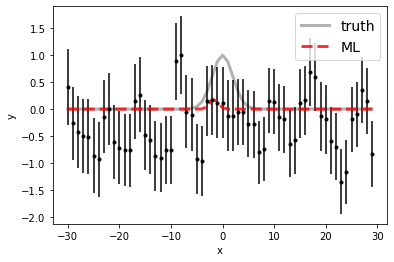

100%|██████████| 15000/15000 [00:37<00:00, 399.39it/s]


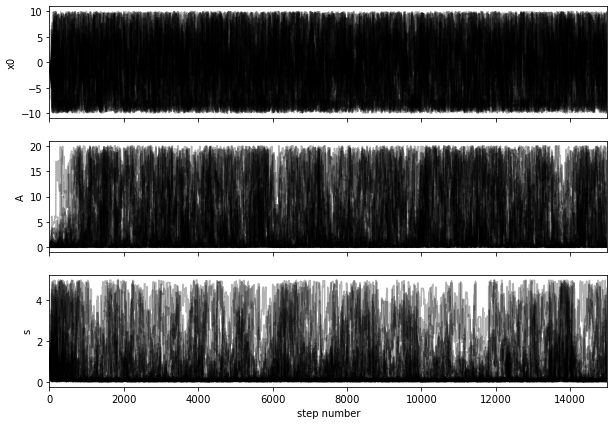

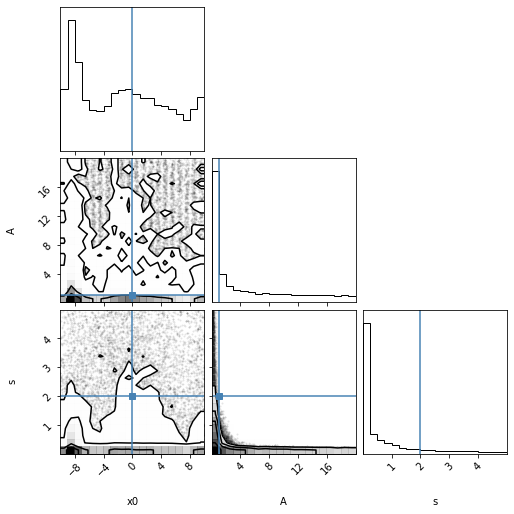

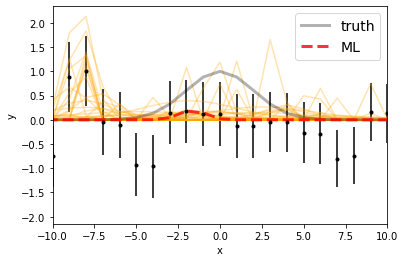

Maximum likelihood estimates:
x0 = -1.644
A = 0.199
s = 0.780


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5005.5192359380935 [6.68694182 7.12456221]
A  =  2.4789164404212967e-18 [2.27464327e-18 1.39006878e-17]
s  =  0.16992835962355402 [0.13233001 1.47501636]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


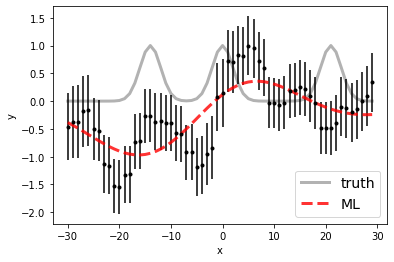

  0%|          | 0/15000 [00:00<?, ?it/s]C:\Users\saruk\anaconda3\lib\site-packages\emcee\moves\red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|██████████| 15000/15000 [00:23<00:00, 642.07it/s]


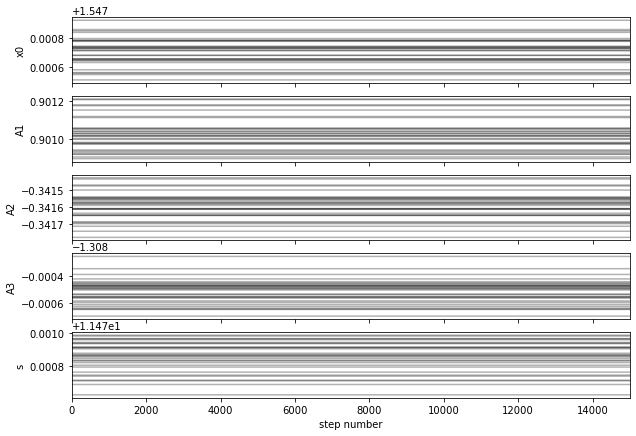

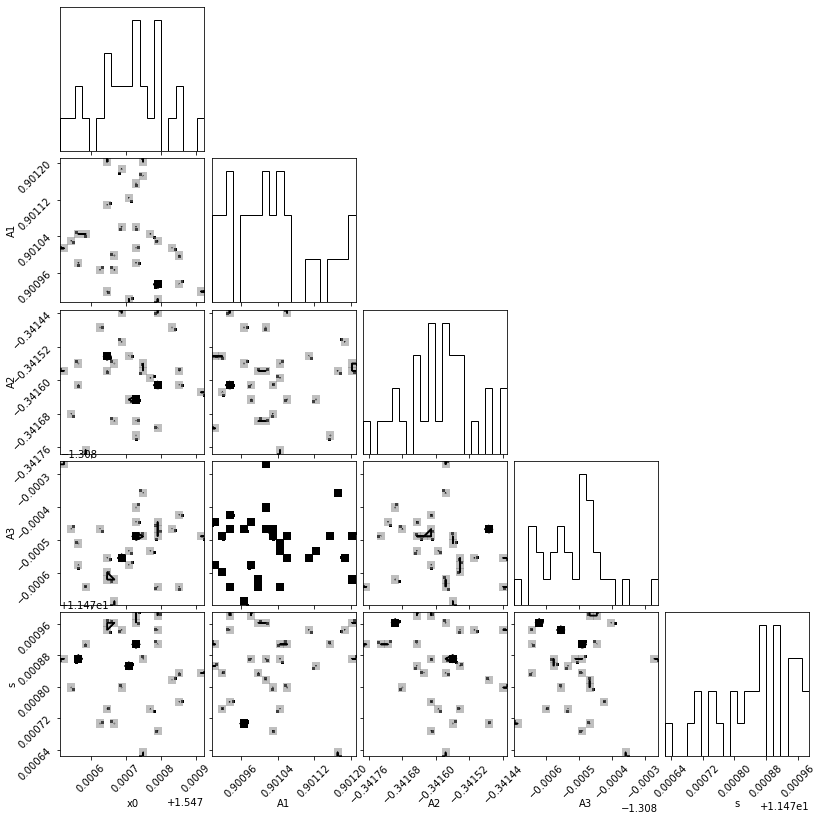

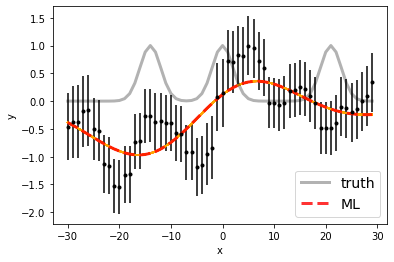

Maximum likelihood estimates:
x0 = 1.548
A1 = 0.901
A2 = -0.342
A3 = -1.309
s = 11.471


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6564.547722296721 6585.547722296721 [1.39003491e-04 7.62088857e-05]
A1, A2   =  8.217720416019178e-19 -3.1154337124937113e-19 [8.01485317e-23 1.22009832e-22] [9.39955461e-23 7.69013880e-23]
s  =  11.470865058155585 [1.26504794e-04 9.65407082e-05]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 11

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


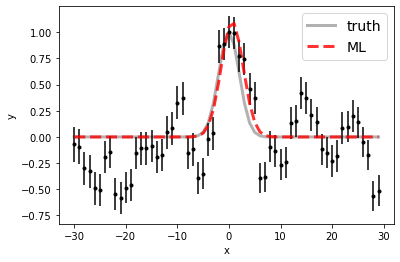

100%|██████████| 15000/15000 [00:46<00:00, 325.61it/s]


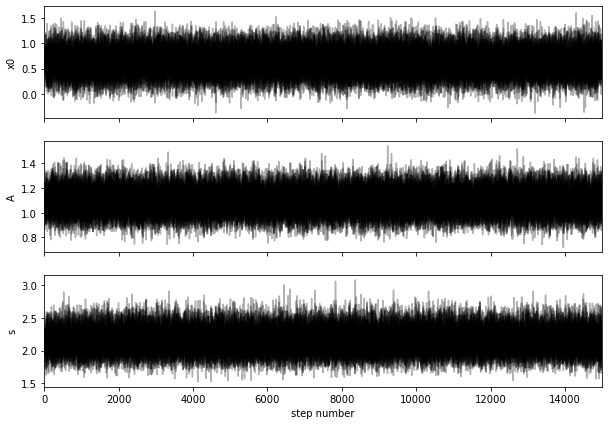

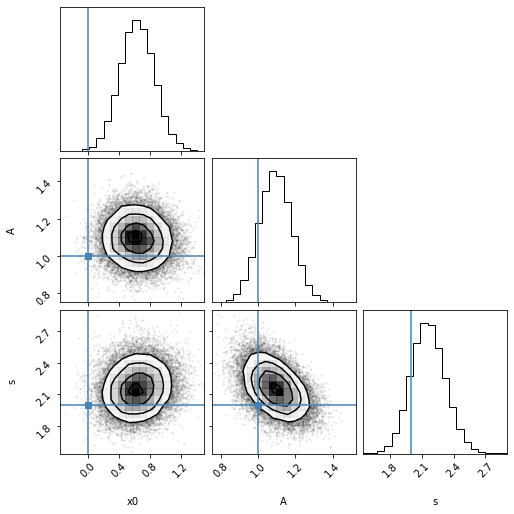

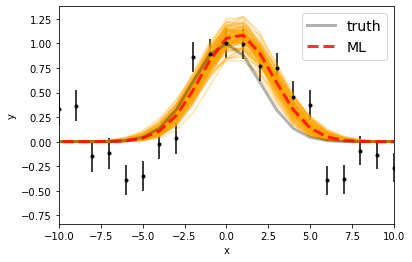

Maximum likelihood estimates:
x0 = 0.634
A = 1.100
s = 2.153


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.633395778412 [0.22085281 0.2234627 ]
A  =  1.804053007752831e-17 [1.42688798e-18 1.45586653e-18]
s  =  2.154845186633066 [0.15718604 0.16501919]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


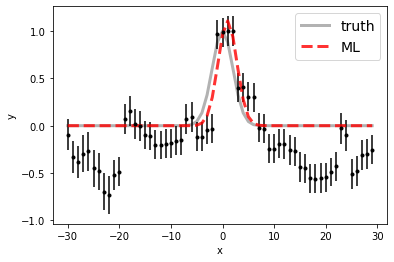

100%|██████████| 15000/15000 [00:45<00:00, 331.12it/s]


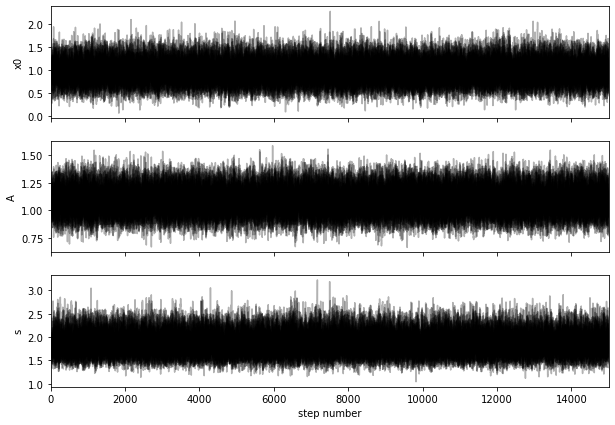

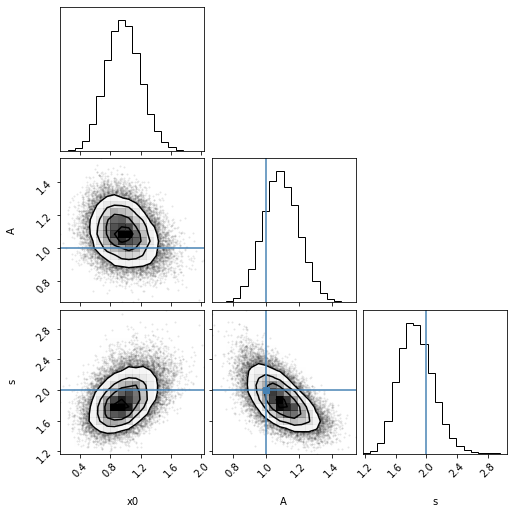

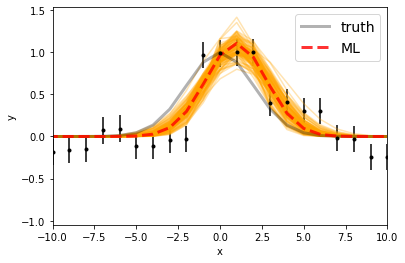

Maximum likelihood estimates:
x0 = 0.959
A = 1.107
s = 1.826


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5007.9704199685275 [0.21898099 0.2298224 ]
A  =  1.60543216626739e-17 [1.56870999e-18 1.65427393e-18]
s  =  1.8516538699569551 [0.20562414 0.23505884]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


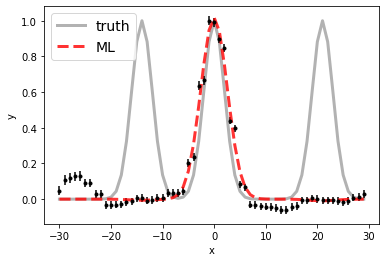

100%|██████████| 15000/15000 [01:10<00:00, 214.12it/s]


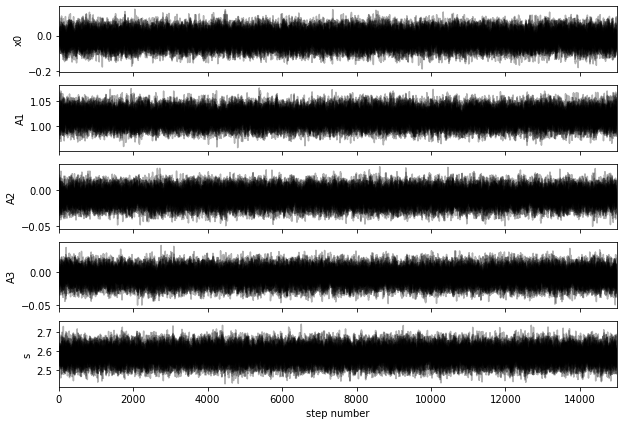

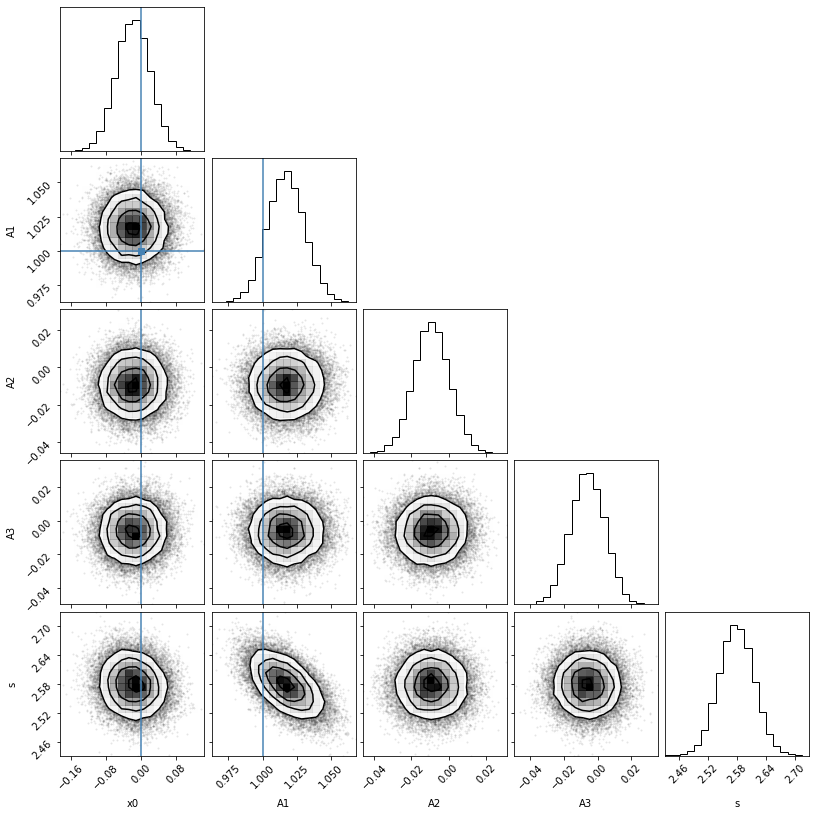

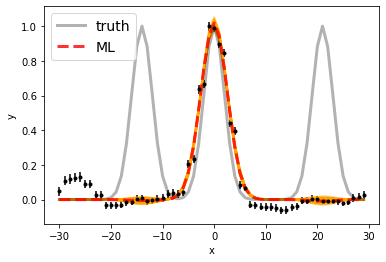

Maximum likelihood estimates:
x0 = -0.017
A1 = 1.018
A2 = -0.009
A3 = -0.006
s = 2.578


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.982498656386 6583.982498656386 [0.03827498 0.0386513 ]
A1, A2   =  6.238617295010994e-17 -5.669307587901896e-19 [8.20755390e-19 8.34297453e-19] [5.78521560e-19 5.93784902e-19]
s  =  2.578496941049453 [0.03589528 0.03590499]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 12

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


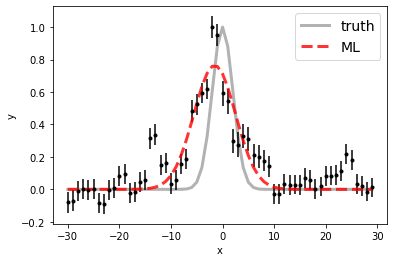

100%|██████████| 15000/15000 [00:45<00:00, 328.11it/s]


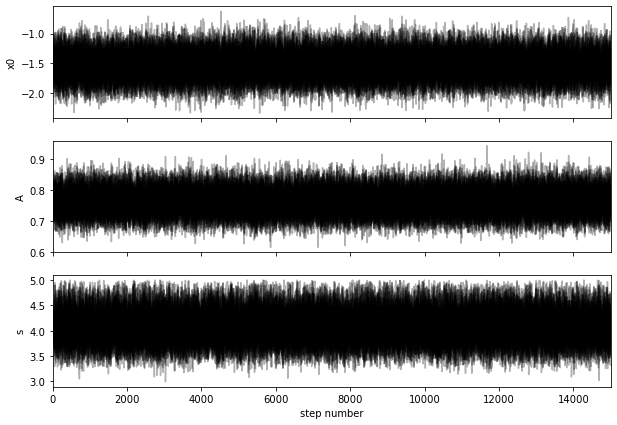

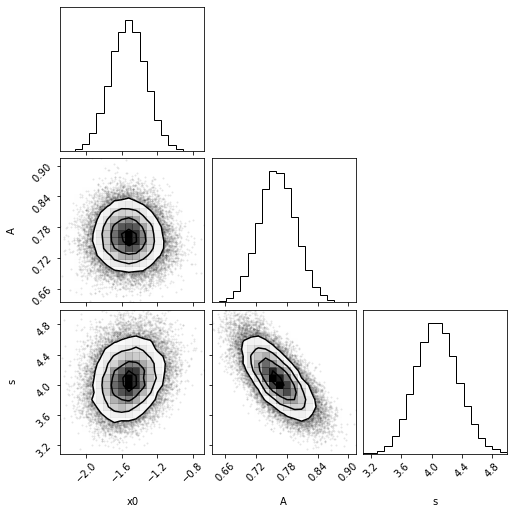

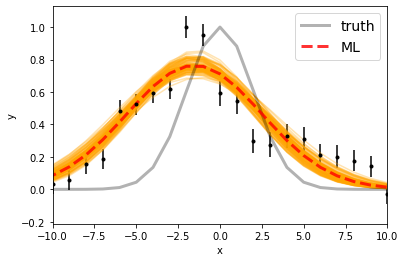

Maximum likelihood estimates:
x0 = -1.526
A = 0.764
s = 4.048


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4859.471346056608 [0.19660551 0.19854386]
A  =  3.260461595020914e-17 [1.51189711e-18 1.55949705e-18]
s  =  4.068923255450752 [0.27341553 0.28652763]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


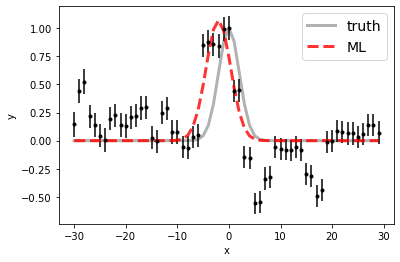

100%|██████████| 15000/15000 [00:46<00:00, 324.17it/s]


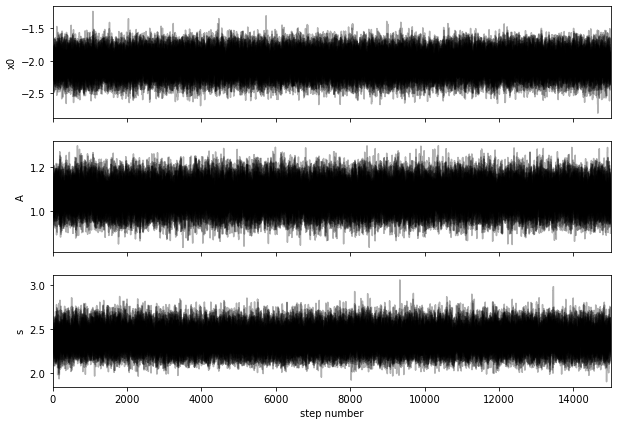

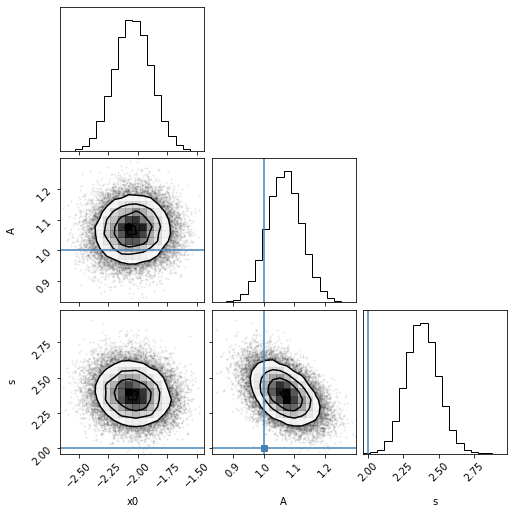

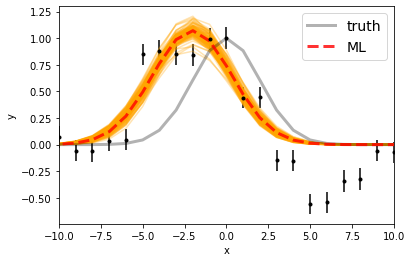

Maximum likelihood estimates:
x0 = -2.040
A = 1.070
s = 2.378


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5004.956312658763 [0.15770592 0.15845788]
A  =  2.534036862003908e-17 [1.32196981e-18 1.33122666e-18]
s  =  2.3821932879338124 [0.11209847 0.11767101]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


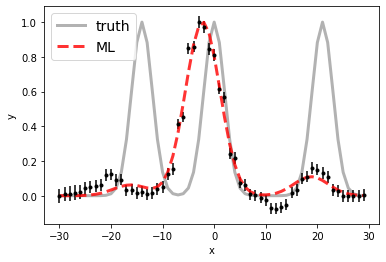

100%|██████████| 15000/15000 [01:10<00:00, 213.71it/s]


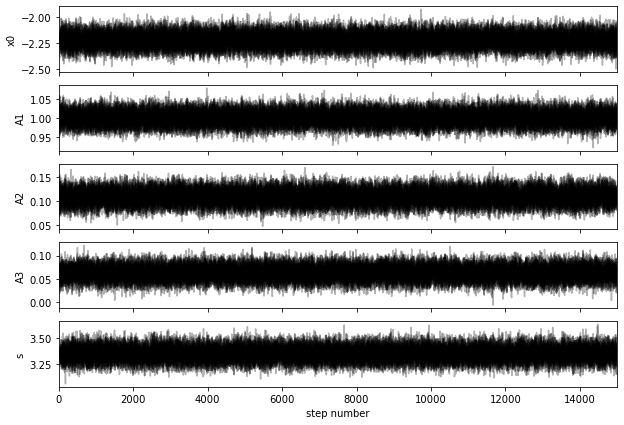

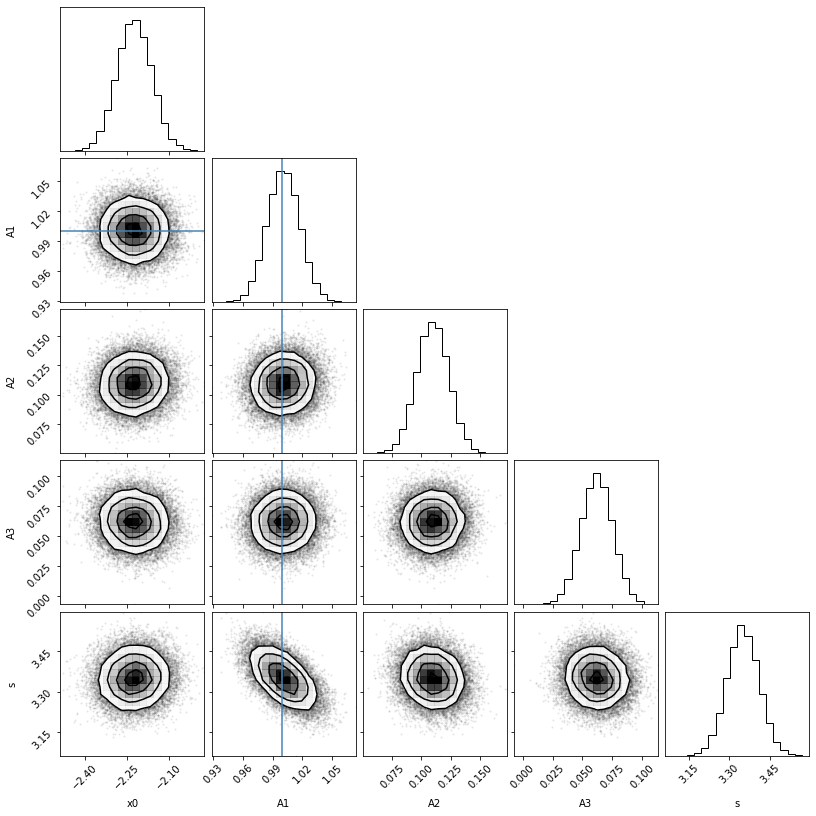

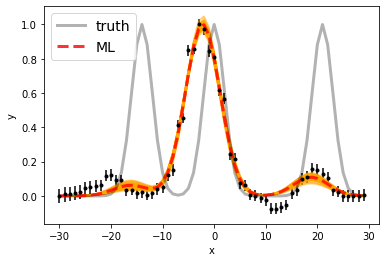

Maximum likelihood estimates:
x0 = -2.222
A1 = 1.001
A2 = 0.109
A3 = 0.062
s = 3.351


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6560.776173975842 6581.776173975842 [0.06148279 0.06228433]
A1, A2   =  4.0428059022470784e-17 4.4187400510757414e-18 [6.59233348e-19 6.64791470e-19] [5.49077764e-19 5.51032550e-19]
s  =  3.350382583721205 [0.05796946 0.05901567]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 13

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


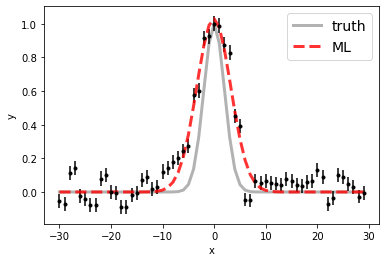

100%|██████████| 15000/15000 [00:46<00:00, 324.84it/s]


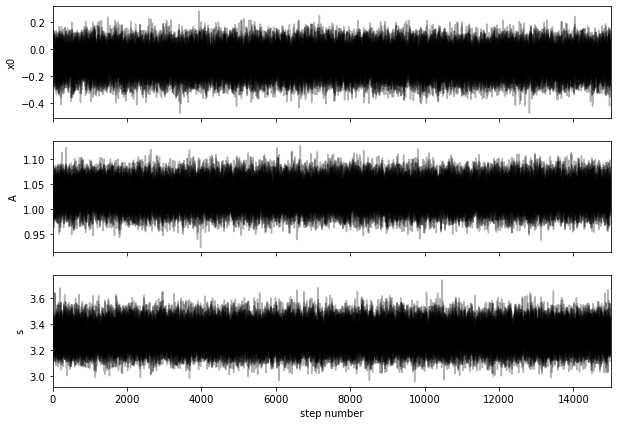

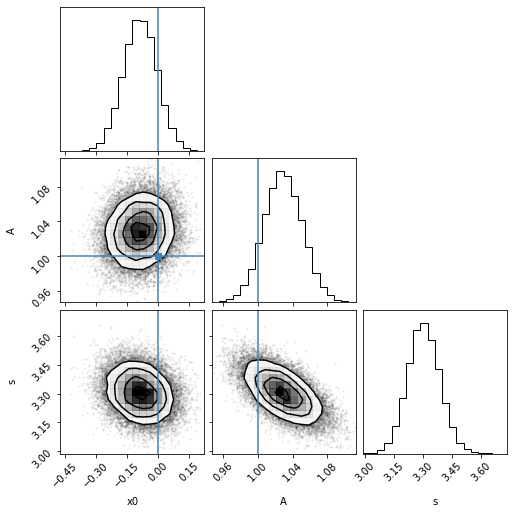

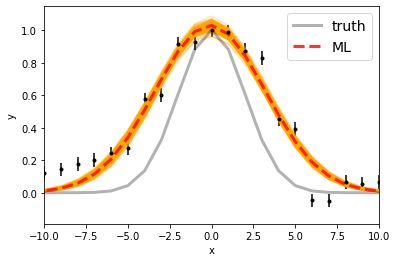

Maximum likelihood estimates:
x0 = -0.085
A = 1.030
s = 3.301


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.914238203706 [0.08232265 0.08187566]
A  =  7.134906461714355e-17 [1.51410571e-18 1.56355837e-18]
s  =  3.3026063887768657 [0.08082005 0.08434866]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


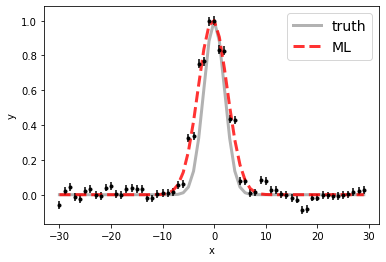

100%|██████████| 15000/15000 [00:30<00:00, 484.82it/s] 


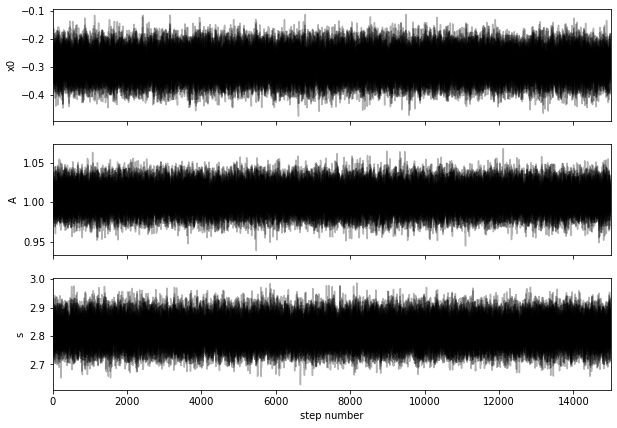

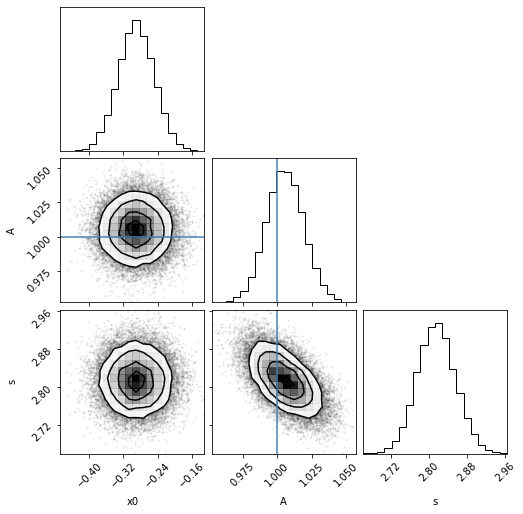

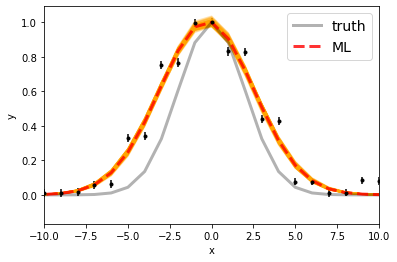

Maximum likelihood estimates:
x0 = -0.290
A = 1.006
s = 2.814


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.709427069065 [0.04166813 0.04271632]
A  =  1.1927960960847027e-16 [1.59477765e-18 1.62297007e-18]
s  =  2.814184632410842 [0.03924336 0.04044463]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


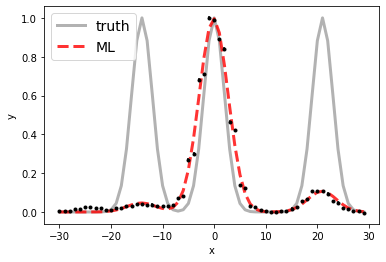

100%|██████████| 15000/15000 [00:25<00:00, 595.80it/s]


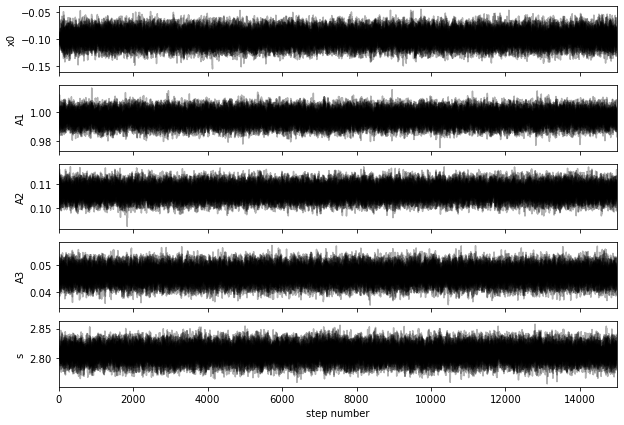

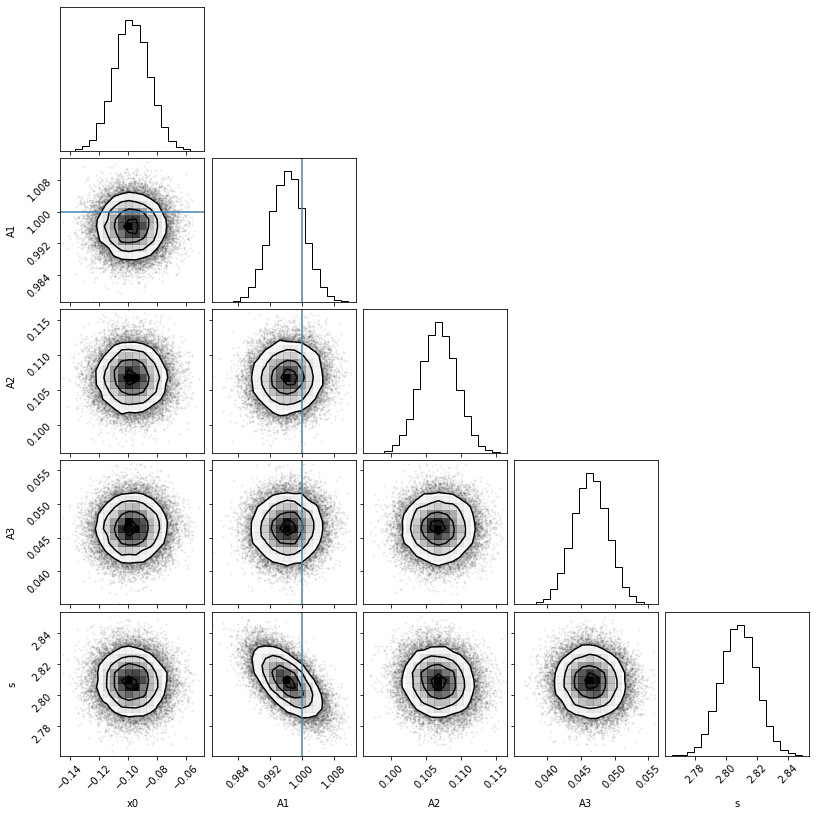

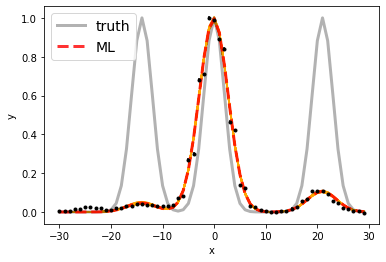

Maximum likelihood estimates:
x0 = -0.098
A1 = 0.996
A2 = 0.107
A3 = 0.046
s = 2.808


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.9023353585235 6583.9023353585235 [0.01184172 0.01216883]
A1, A2   =  2.2941390968159976e-16 2.4589948519798696e-17 [9.89779534e-19 9.71876430e-19] [5.89249453e-19 5.88224430e-19]
s  =  2.8083004087853096 [0.01147895 0.01132302]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 14

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


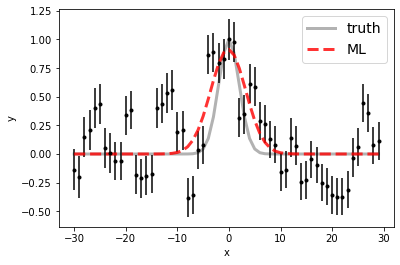

100%|██████████| 15000/15000 [00:15<00:00, 973.75it/s]


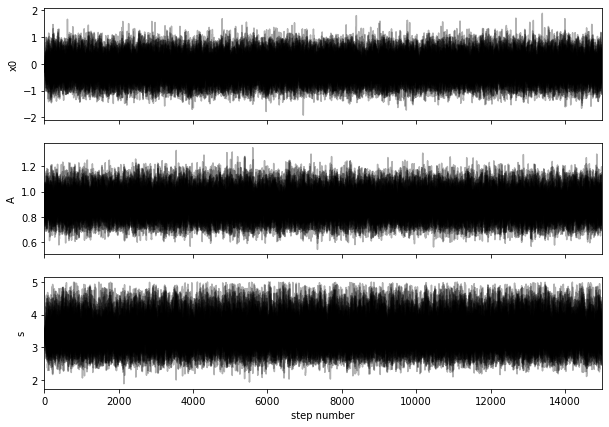

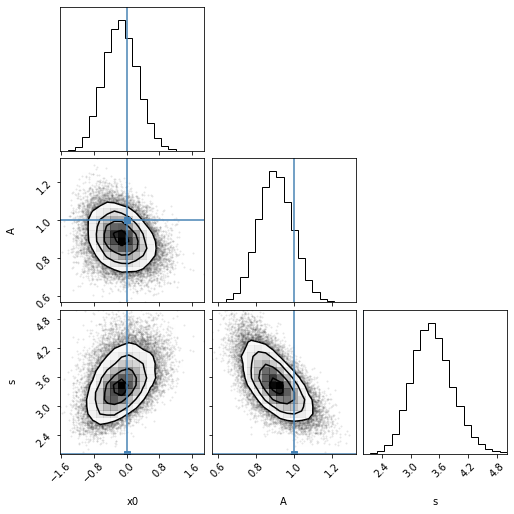

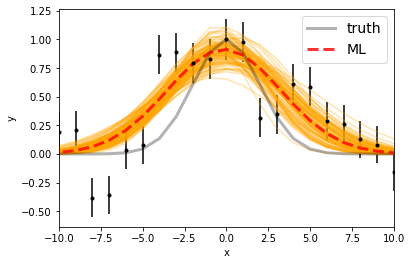

Maximum likelihood estimates:
x0 = -0.143
A = 0.913
s = 3.402


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.849509920912 [0.39799881 0.41342665]
A  =  1.3348623559928882e-17 [1.30509183e-18 1.38498901e-18]
s  =  3.432850496219904 [0.38396043 0.44111978]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


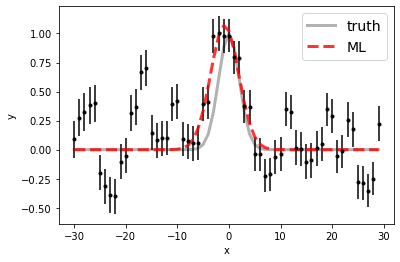

100%|██████████| 15000/15000 [00:15<00:00, 986.71it/s] 


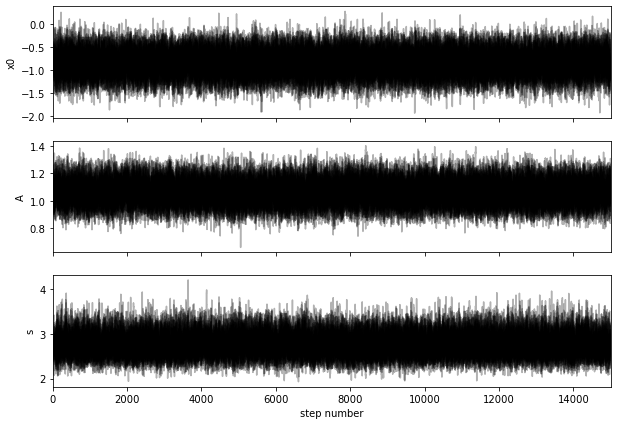

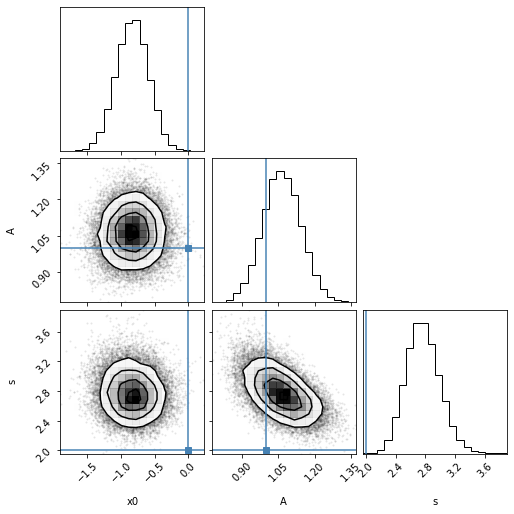

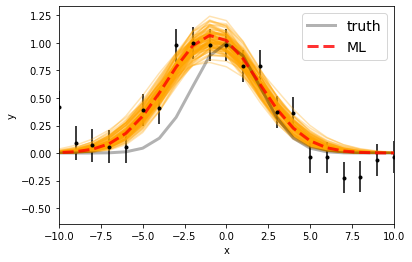

Maximum likelihood estimates:
x0 = -0.828
A = 1.071
s = 2.737


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.165997286965 [0.24343338 0.23889996]
A  =  1.623855091611489e-17 [1.19477473e-18 1.21153643e-18]
s  =  2.755497562814061 [0.21418118 0.23692463]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


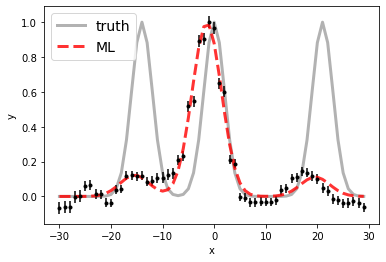

100%|██████████| 15000/15000 [00:23<00:00, 633.59it/s]


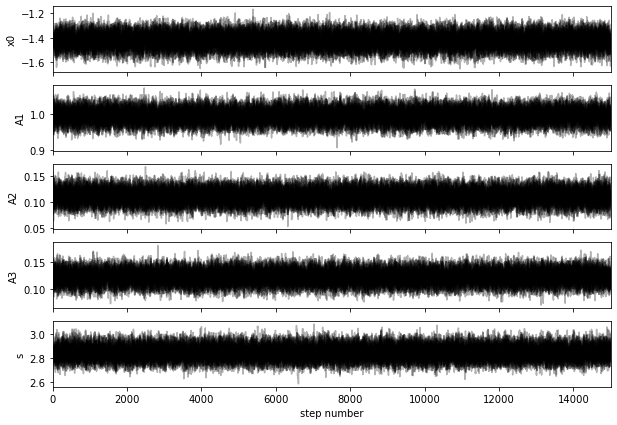

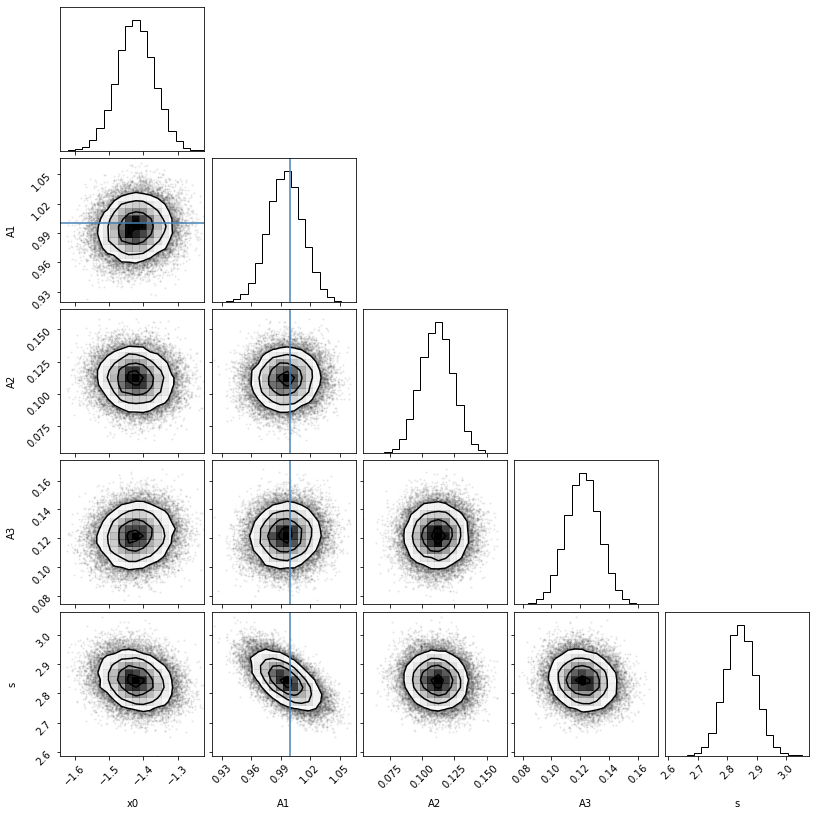

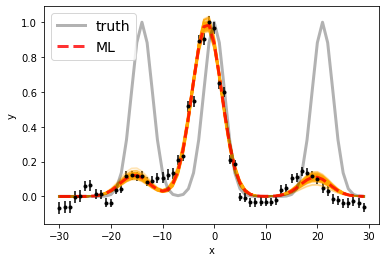

Maximum likelihood estimates:
x0 = -1.423
A1 = 0.995
A2 = 0.111
A3 = 0.122
s = 2.845


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.576614213948 6582.576614213948 [0.05344855 0.05431184]
A1, A2   =  4.4435715680253e-17 4.9691372424432224e-18 [7.86361843e-19 7.95416711e-19] [5.65304806e-19 5.58247446e-19]
s  =  2.8436594501154207 [0.05130078 0.05221527]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 15

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


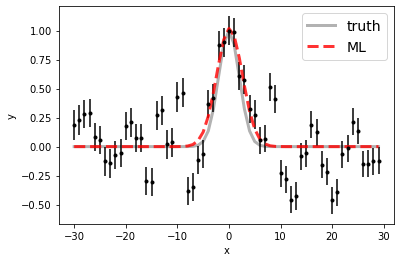

100%|██████████| 15000/15000 [00:15<00:00, 977.35it/s] 


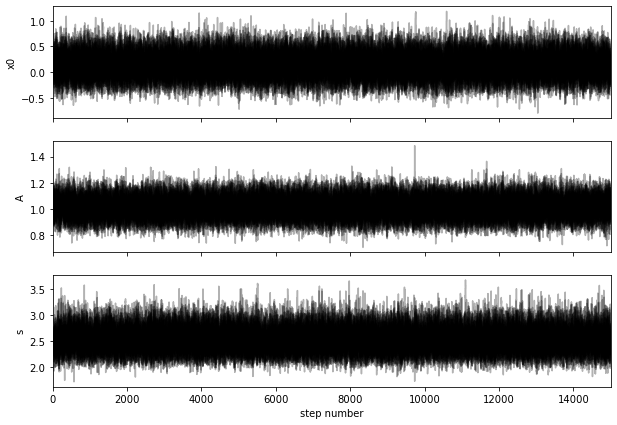

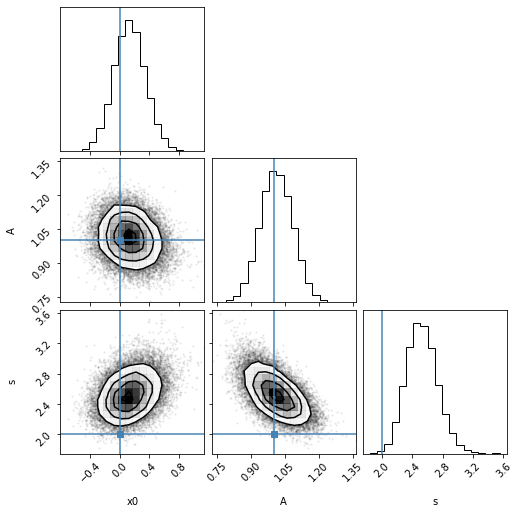

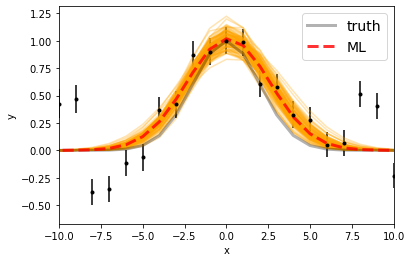

Maximum likelihood estimates:
x0 = 0.119
A = 1.019
s = 2.498


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.133528400324 [0.20809385 0.21377717]
A  =  2.4927470913184683e-17 [1.74115507e-18 1.80257866e-18]
s  =  2.5136227689599187 [0.195178   0.21321528]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


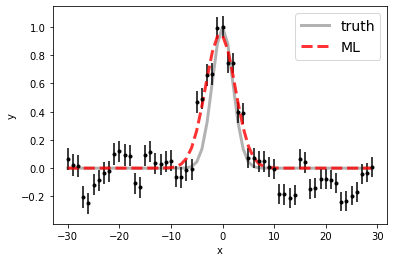

100%|██████████| 15000/15000 [00:15<00:00, 961.92it/s]


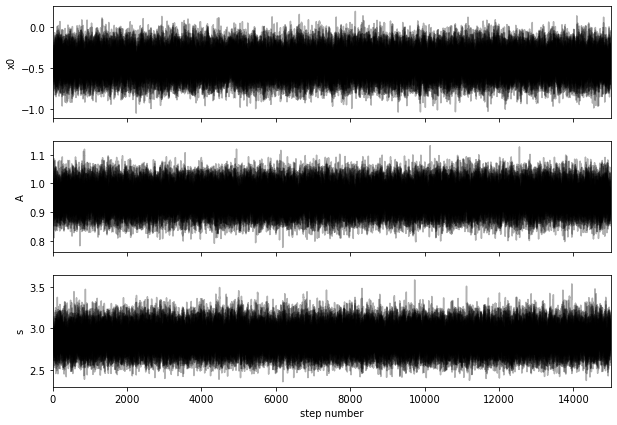

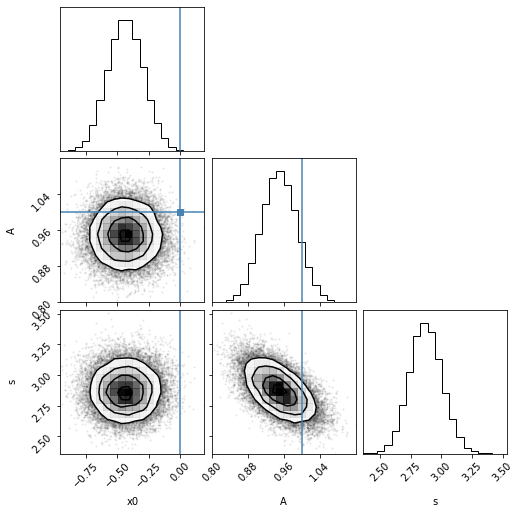

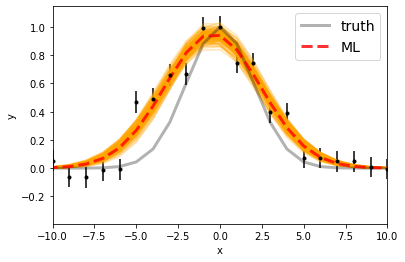

Maximum likelihood estimates:
x0 = -0.438
A = 0.952
s = 2.864


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.56467120462 [0.14157798 0.14338906]
A  =  3.586914667781273e-17 [1.48342749e-18 1.52279662e-18]
s  =  2.8702124084297225 [0.12977722 0.13518951]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


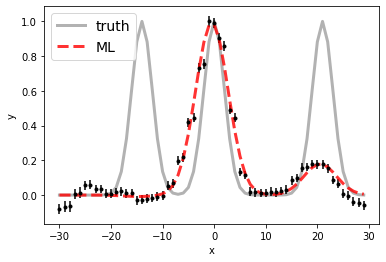

100%|██████████| 15000/15000 [00:24<00:00, 623.82it/s]


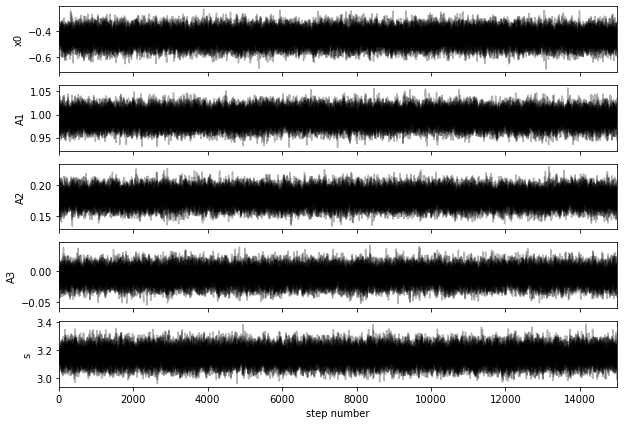

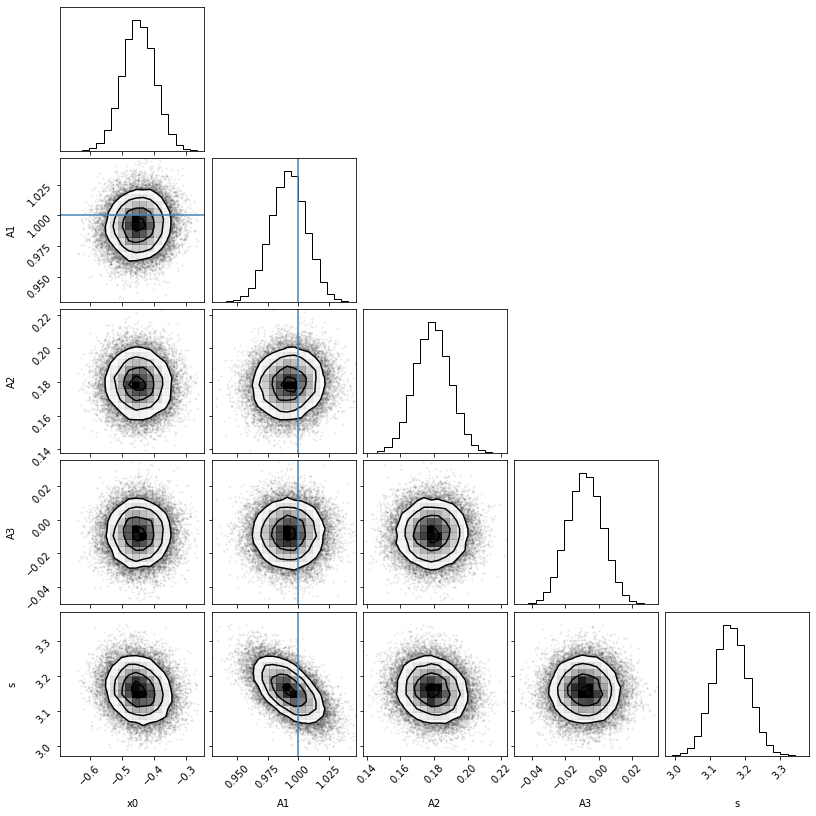

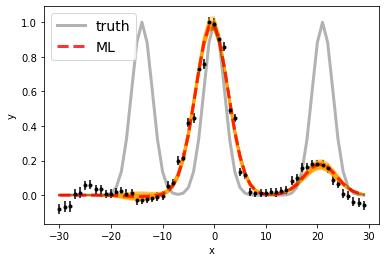

Maximum likelihood estimates:
x0 = -0.448
A1 = 0.992
A2 = 0.179
A3 = -0.008
s = 3.160


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.55258766598 6583.55258766598 [0.04972797 0.04992604]
A1, A2   =  5.5237106482347685e-17 9.964403420296991e-18 [8.07151221e-19 8.02983601e-19] [5.86244950e-19 5.91918623e-19]
s  =  3.158883319366173 [0.04748977 0.04916611]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 16

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


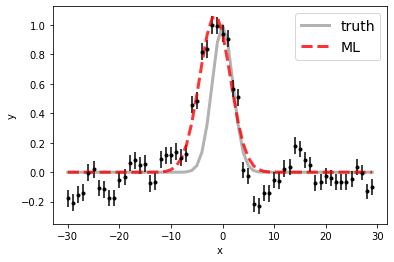

100%|██████████| 15000/15000 [00:15<00:00, 969.34it/s] 


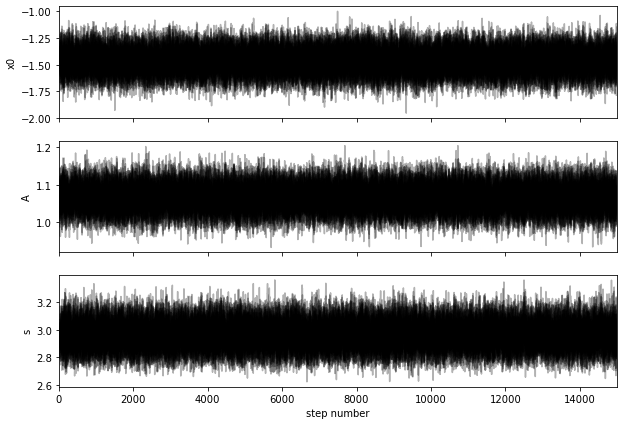

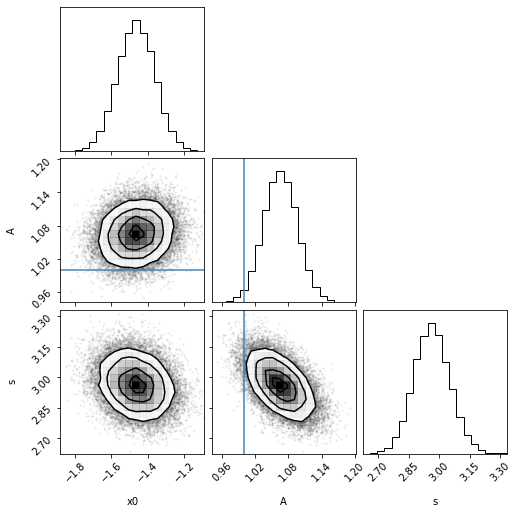

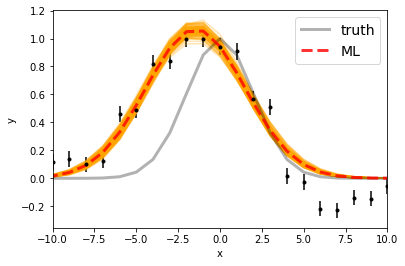

Maximum likelihood estimates:
x0 = -1.462
A = 1.066
s = 2.960


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4859.537660669112 [0.103133   0.10112647]
A  =  5.311318144996054e-17 [1.51543112e-18 1.51655586e-18]
s  =  2.962914457145686 [0.0865846  0.08875671]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


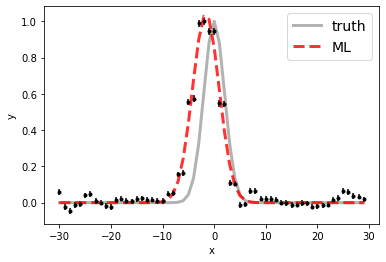

100%|██████████| 15000/15000 [00:15<00:00, 964.35it/s] 


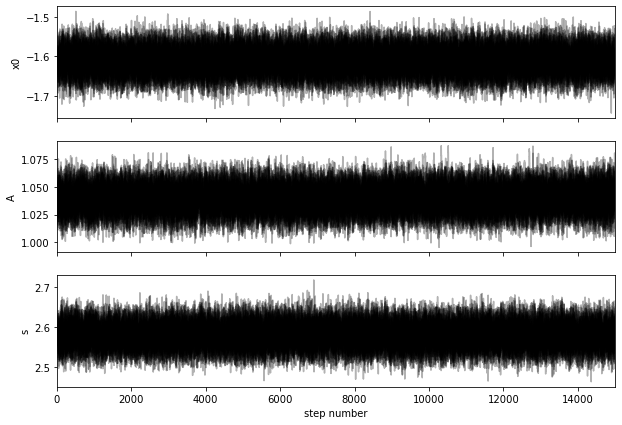

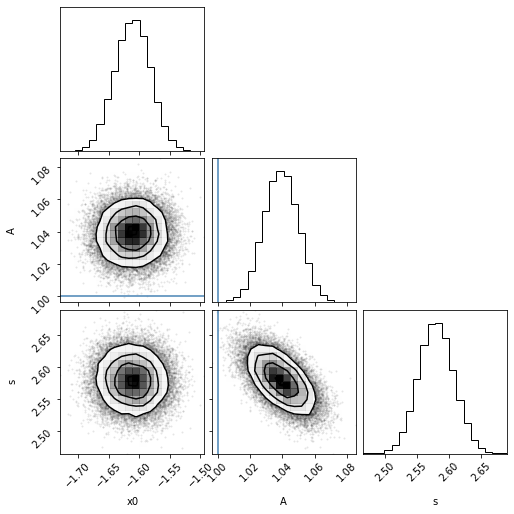

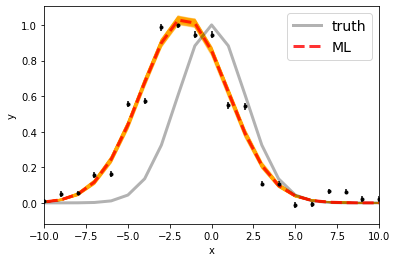

Maximum likelihood estimates:
x0 = -1.611
A = 1.039
s = 2.580


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5005.38921051959 [0.02947917 0.02861216]
A  =  1.7391209102950233e-16 [1.78704850e-18 1.81319202e-18]
s  =  2.5795292345399004 [0.02704247 0.02799969]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


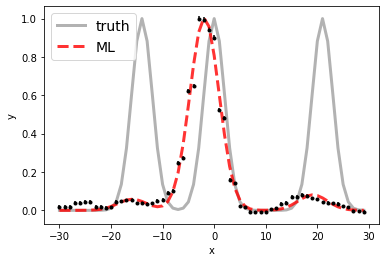

100%|██████████| 15000/15000 [00:23<00:00, 642.63it/s]


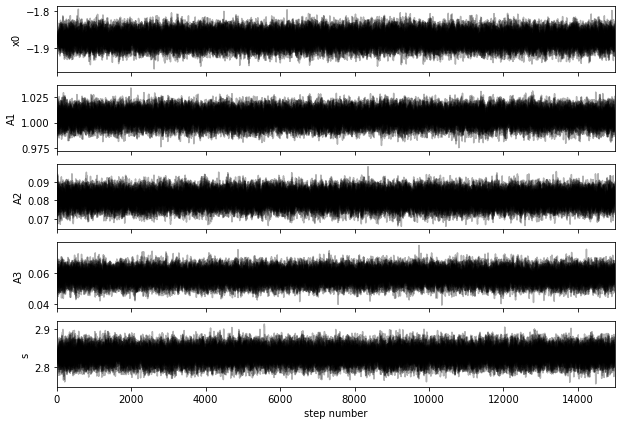

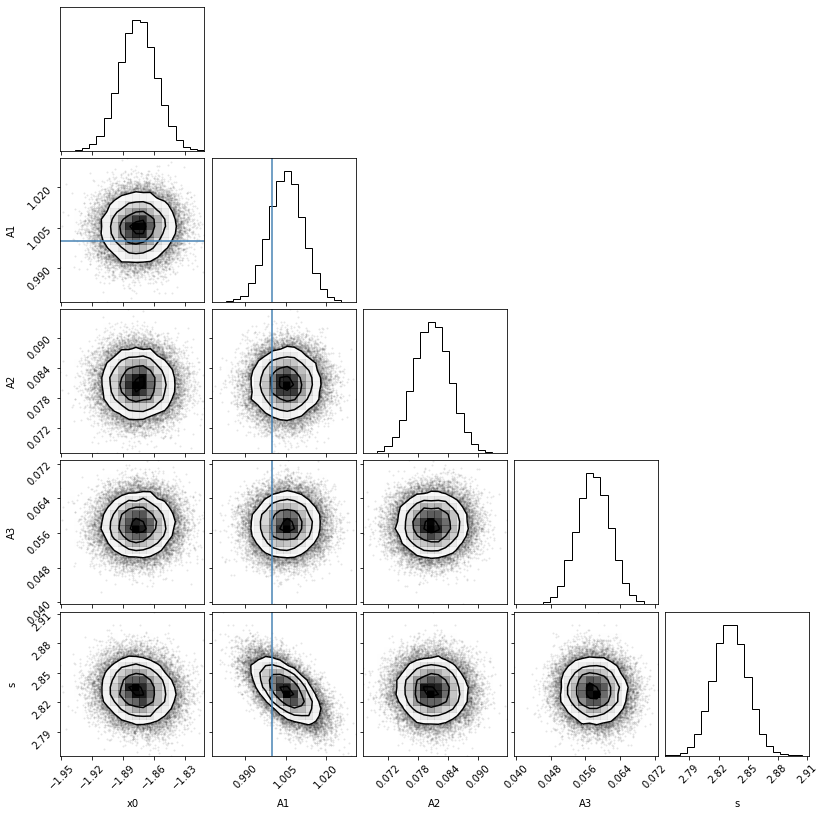

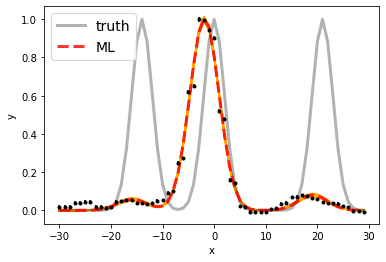

Maximum likelihood estimates:
x0 = -1.876
A1 = 1.005
A2 = 0.081
A3 = 0.058
s = 2.832


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.124386707433 6582.124386707433 [0.01743154 0.01772212]
A1, A2   =  1.5431833164417037e-16 1.2406887658996942e-17 [9.80399251e-19 9.65310663e-19] [5.45575132e-19 5.47889760e-19]
s  =  2.831857959426931 [0.01691198 0.01719854]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 17

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


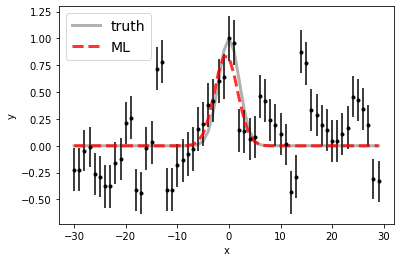

100%|██████████| 15000/15000 [00:15<00:00, 958.75it/s] 


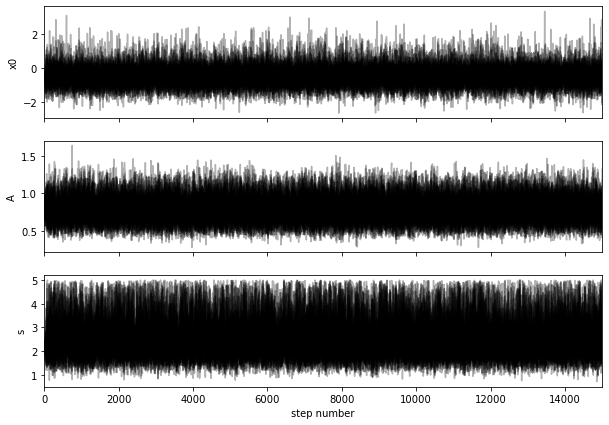

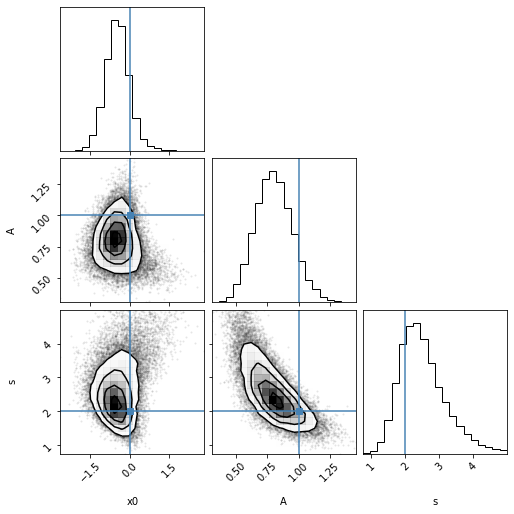

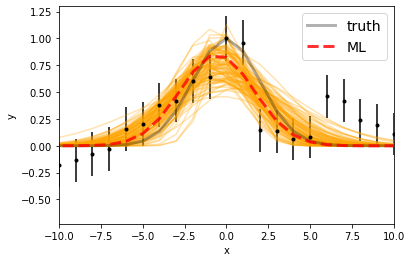

Maximum likelihood estimates:
x0 = -0.556
A = 0.851
s = 2.210


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.527897077557 [0.43693894 0.44338582]
A  =  1.1787919701724123e-17 [2.15487306e-18 2.27674531e-18]
s  =  2.416763722372708 [0.53525491 0.76619614]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


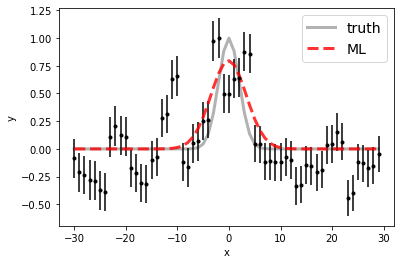

100%|██████████| 15000/15000 [00:16<00:00, 892.42it/s]


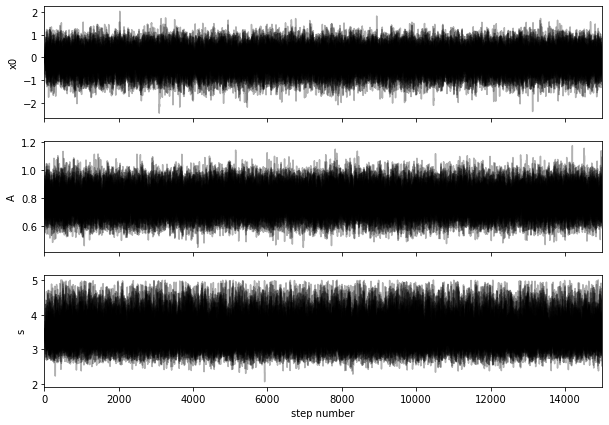

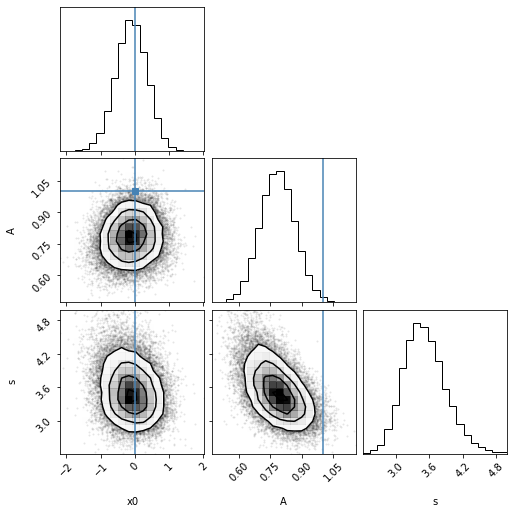

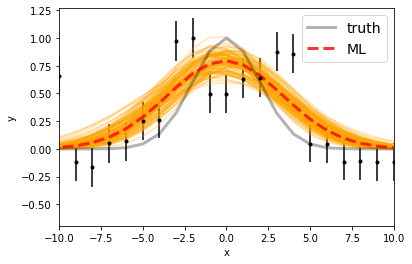

Maximum likelihood estimates:
x0 = -0.072
A = 0.796
s = 3.444


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.899748344002 [0.45987071 0.45447352]
A  =  1.2318430965981488e-17 [1.29608742e-18 1.31248810e-18]
s  =  3.4900155016785455 [0.33742104 0.40341509]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


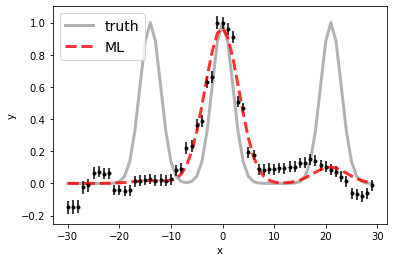

100%|██████████| 15000/15000 [00:26<00:00, 574.32it/s]


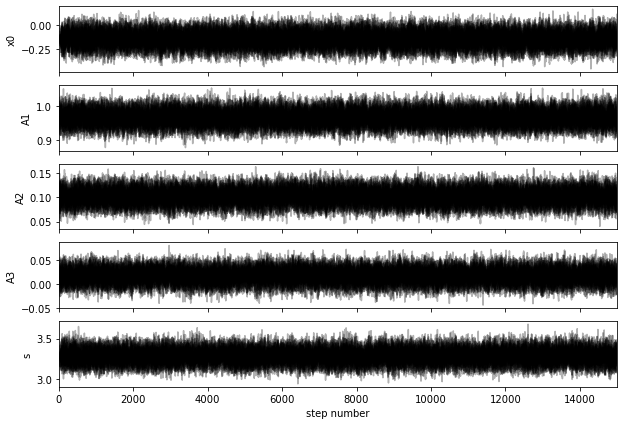

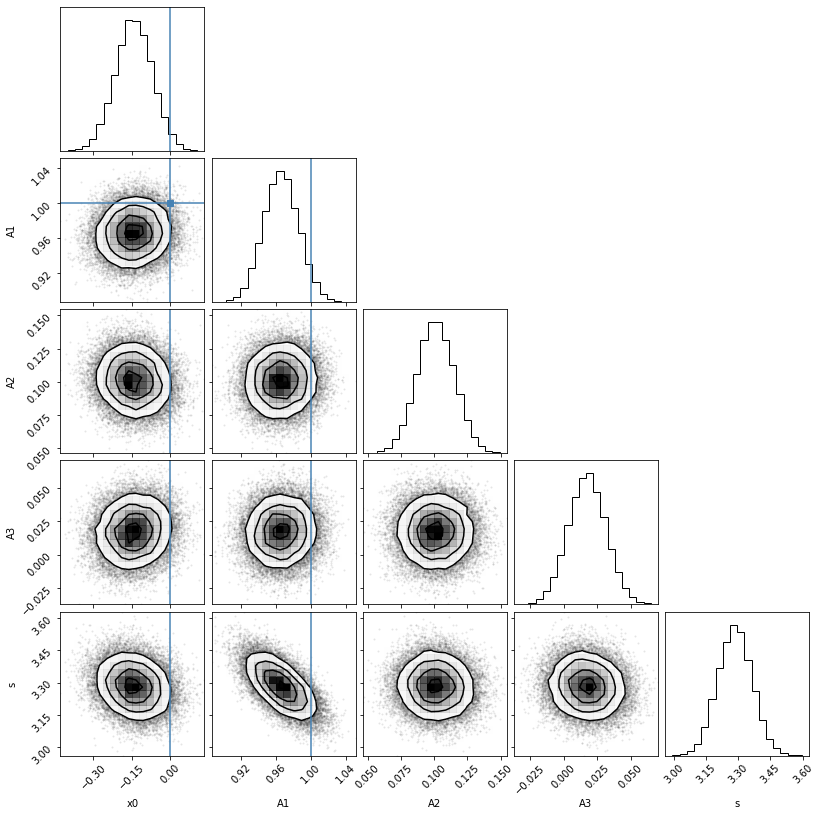

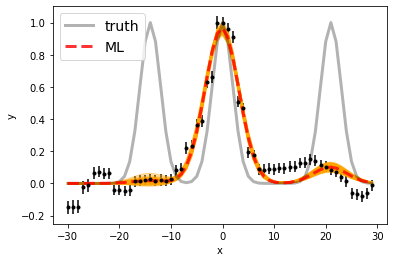

Maximum likelihood estimates:
x0 = -0.140
A1 = 0.966
A2 = 0.101
A3 = 0.017
s = 3.281


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.858640964655 6583.858640964655 [0.07242129 0.07217095]
A1, A2   =  3.8393254136552986e-17 4.019766683592657e-18 [7.95443867e-19 8.15730903e-19] [5.51472395e-19 5.64735700e-19]
s  =  3.2837491908720455 [0.07927244 0.07950071]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 18

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


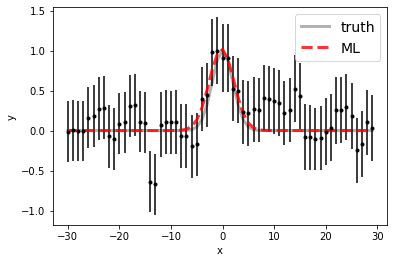

100%|██████████| 15000/15000 [00:16<00:00, 915.96it/s] 


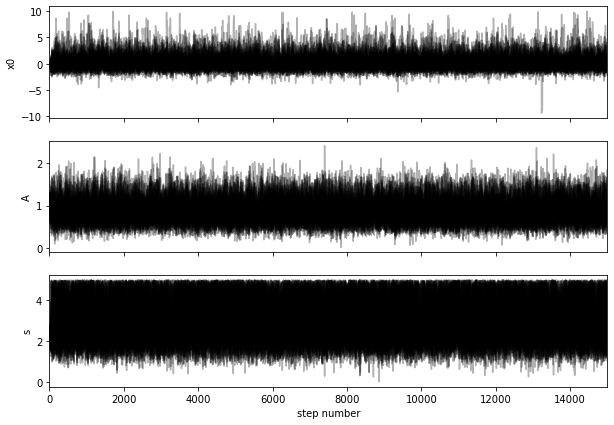

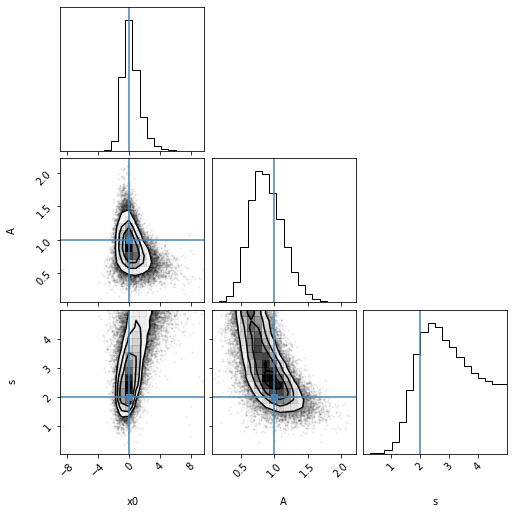

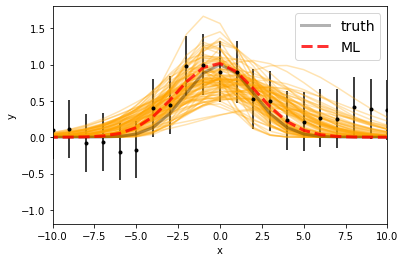

Maximum likelihood estimates:
x0 = -0.187
A = 1.018
s = 2.383


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.138901320921 [0.8710347  1.22689077]
A  =  1.4733631001571568e-18 [3.73414243e-19 4.58236877e-19]
s  =  2.967389022616751 [0.92873353 1.26808964]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


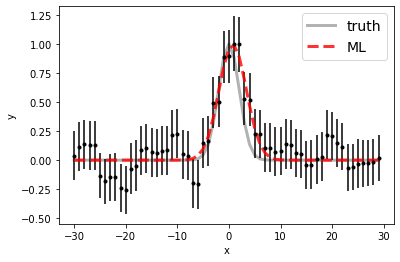

100%|██████████| 15000/15000 [00:15<00:00, 944.43it/s] 


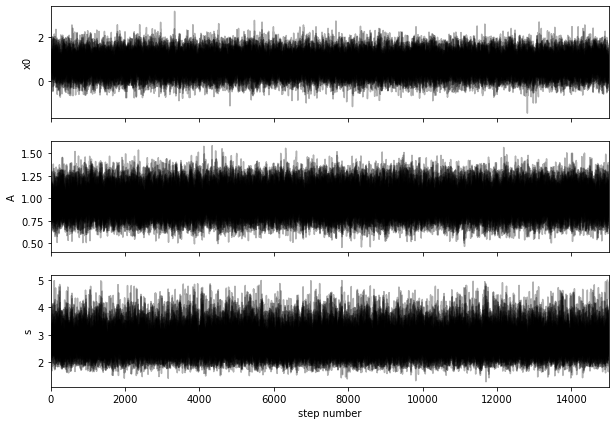

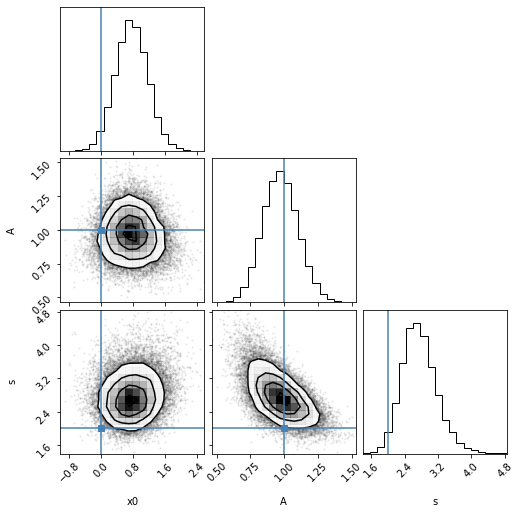

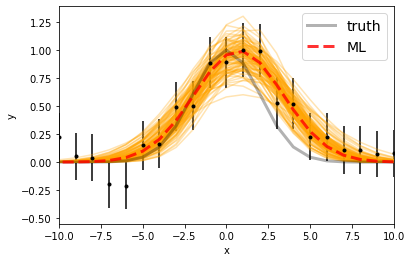

Maximum likelihood estimates:
x0 = 0.733
A = 0.994
s = 2.660


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5007.7547156298815 [0.40141865 0.41002687]
A  =  2.9062754717461706e-18 [3.84366741e-19 4.01381513e-19]
s  =  2.7192542050391153 [0.37254018 0.4364011 ]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


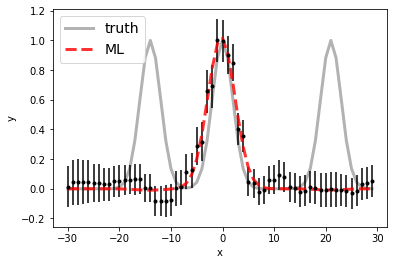

100%|██████████| 15000/15000 [00:24<00:00, 624.11it/s]


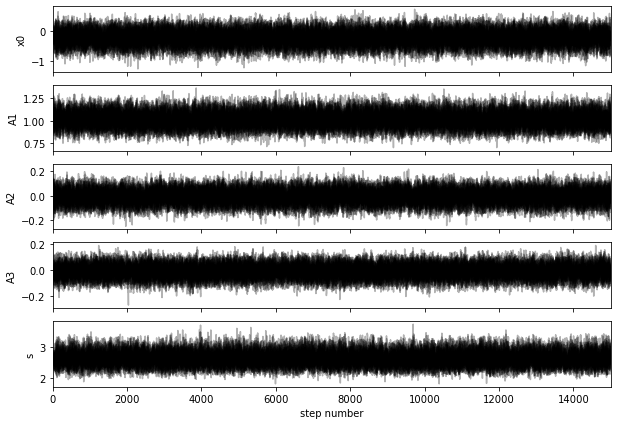

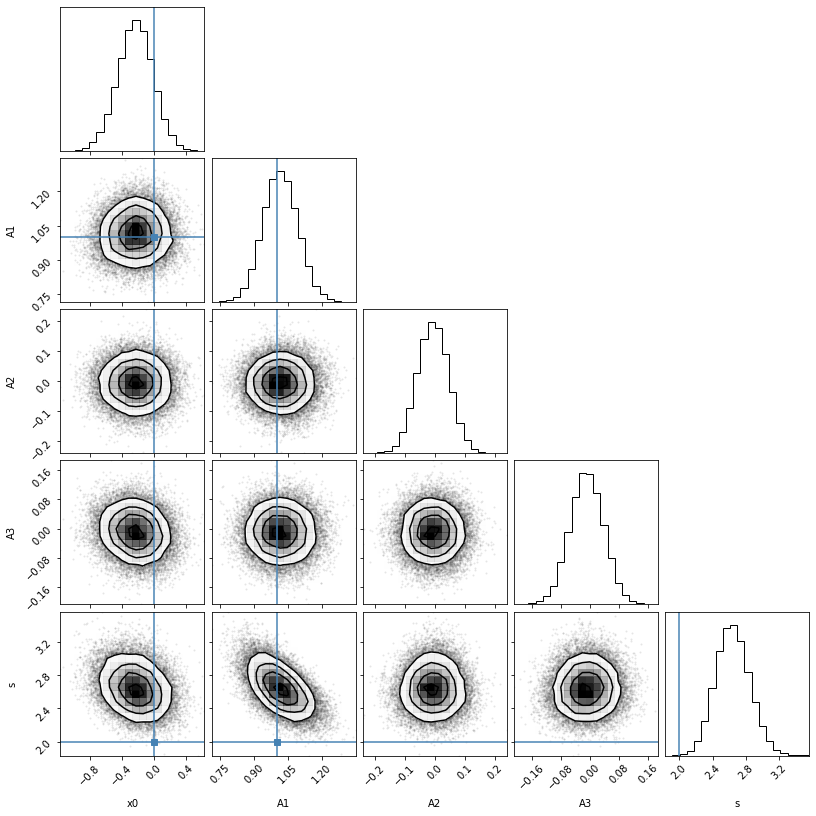

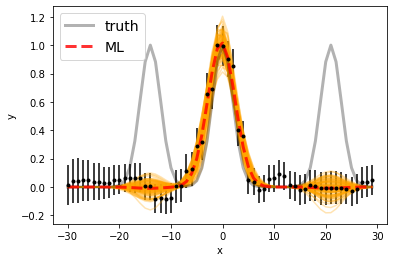

Maximum likelihood estimates:
x0 = -0.233
A1 = 1.019
A2 = -0.008
A3 = -0.009
s = 2.643


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.769680228697 6583.769680228697 [0.22124265 0.21658175]
A1, A2   =  3.2450680311696835e-18 -2.2526193877699948e-20 [2.38441510e-19 2.48471668e-19] [1.67387713e-19 1.65626999e-19]
s  =  2.6352574692105843 [0.19457975 0.20966786]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 19

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


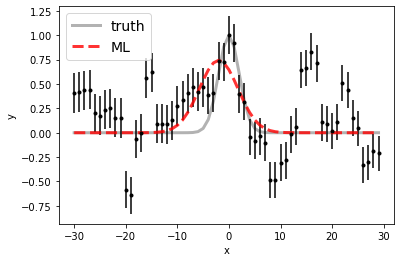

100%|██████████| 15000/15000 [00:14<00:00, 1007.24it/s]


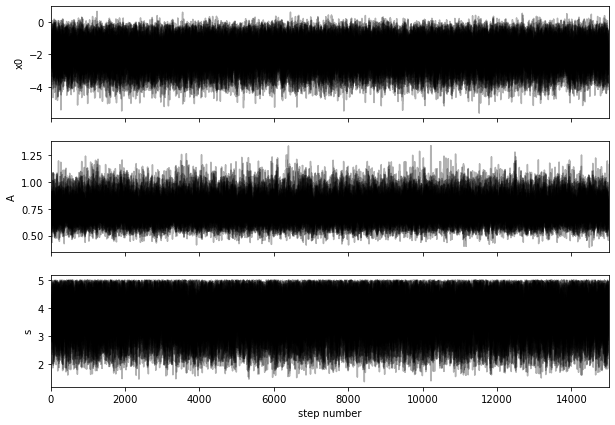

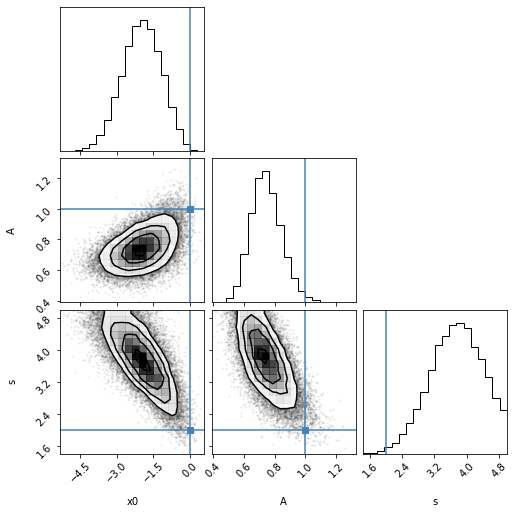

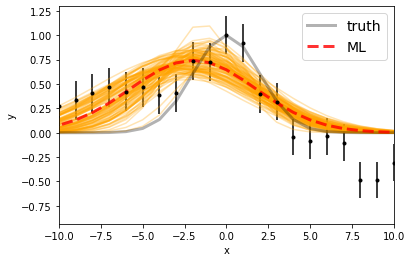

Maximum likelihood estimates:
x0 = -1.987
A = 0.743
s = 3.756


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4859.029311184044 [0.82233699 0.8017281 ]
A  =  9.091682970842594e-18 [1.13052925e-18 1.28353798e-18]
s  =  3.7575292643381024 [0.67575522 0.65772209]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


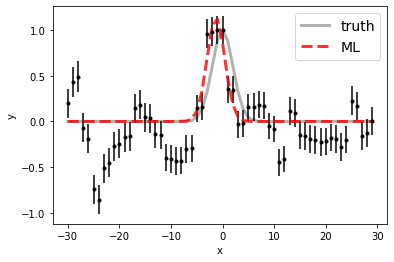

100%|██████████| 15000/15000 [00:15<00:00, 965.20it/s] 


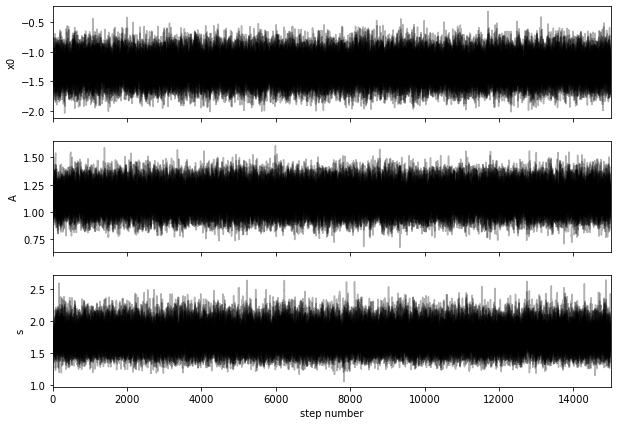

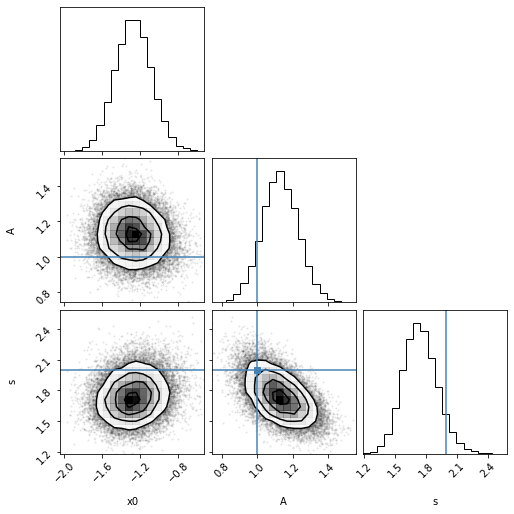

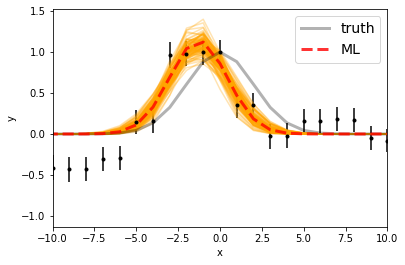

Maximum likelihood estimates:
x0 = -1.285
A = 1.136
s = 1.723


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5005.723048013375 [0.18970601 0.19013155]
A  =  1.5315528509687456e-17 [1.36428446e-18 1.41845647e-18]
s  =  1.7359156227036565 [0.15637972 0.17211369]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


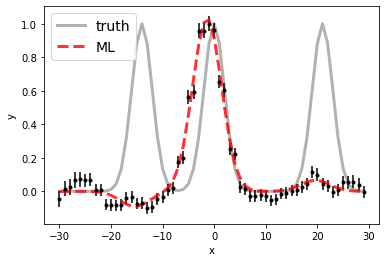

100%|██████████| 15000/15000 [00:24<00:00, 621.57it/s]


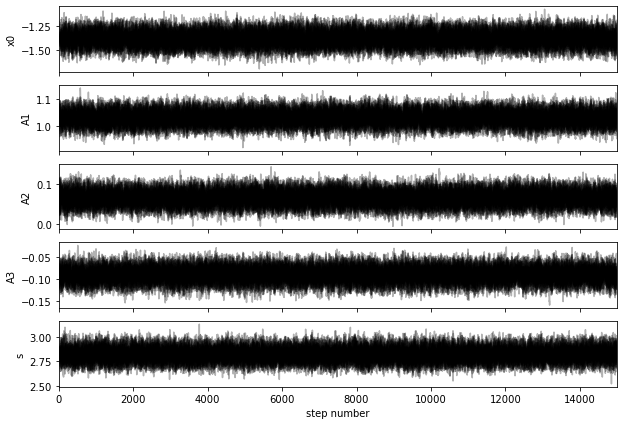

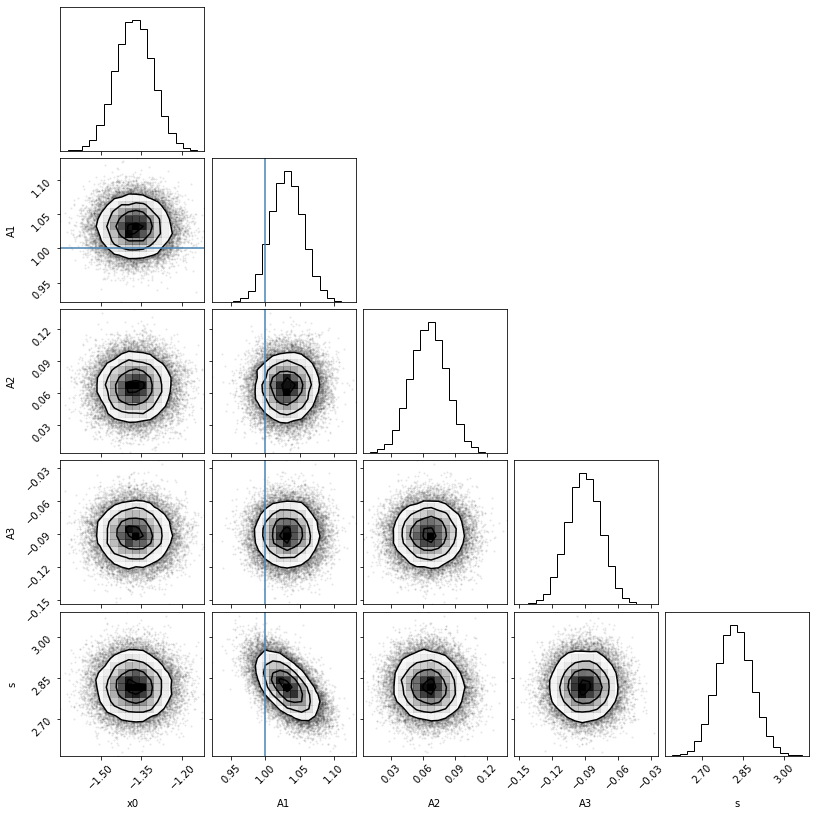

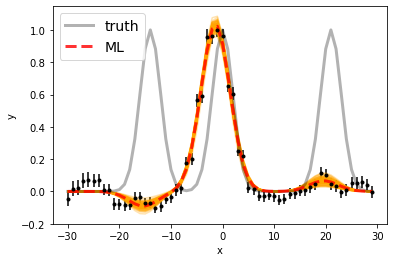

Maximum likelihood estimates:
x0 = -1.376
A1 = 1.032
A2 = 0.066
A3 = -0.091
s = 2.821


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.6228688468 6582.6228688468 [0.06800369 0.06851744]
A1, A2   =  3.3302060194094436e-17 2.118978241669258e-18 [7.62426859e-19 7.62653285e-19] [5.40054889e-19 5.25981005e-19]
s  =  2.8196947427890118 [0.06352242 0.06463504]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 20

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


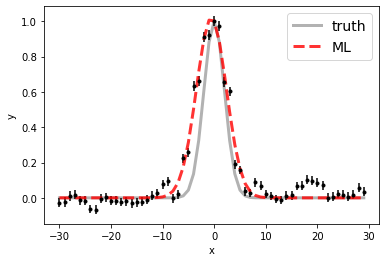

100%|██████████| 15000/15000 [00:15<00:00, 952.64it/s]


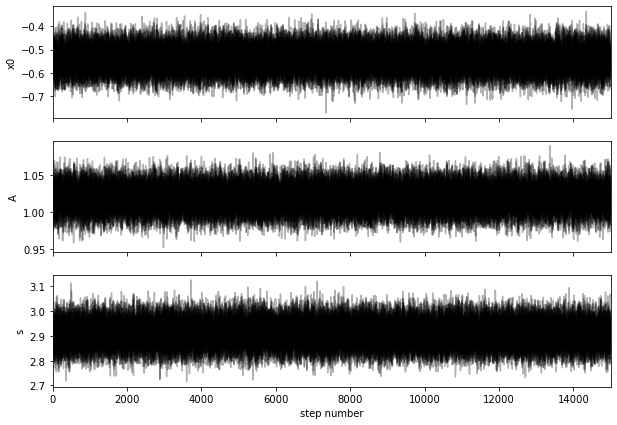

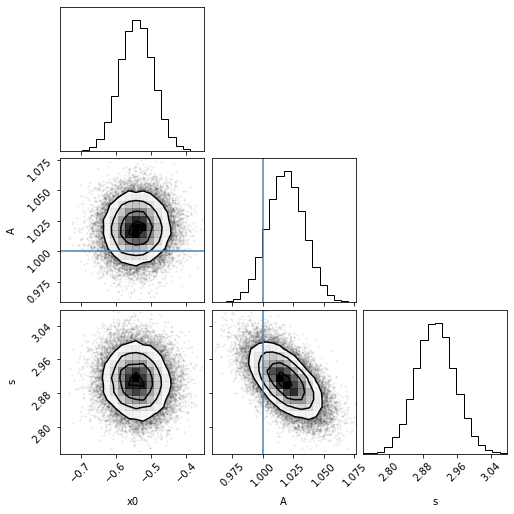

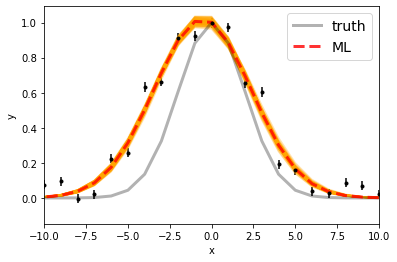

Maximum likelihood estimates:
x0 = -0.541
A = 1.019
s = 2.907


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.458479131168 [0.04679193 0.04772974]
A  =  1.2679769840412825e-16 [1.86773226e-18 1.88807217e-18]
s  =  2.9086953418162294 [0.04475289 0.045638  ]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


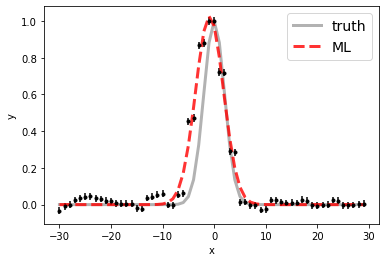

100%|██████████| 15000/15000 [00:17<00:00, 881.47it/s]


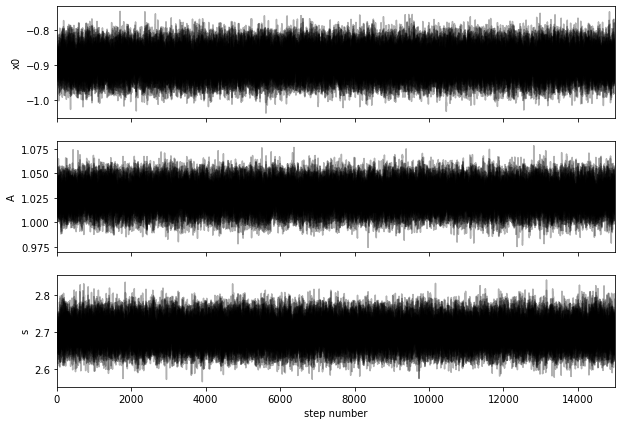

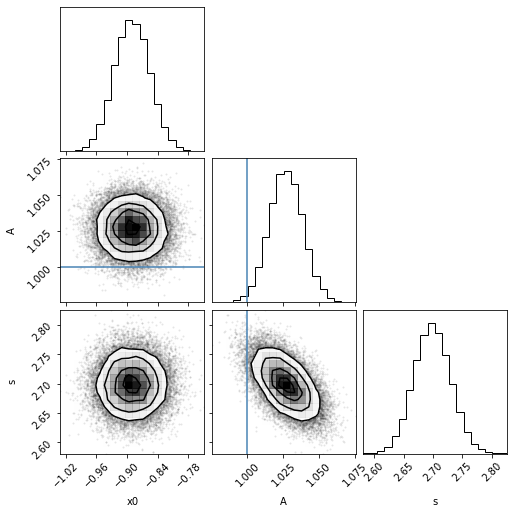

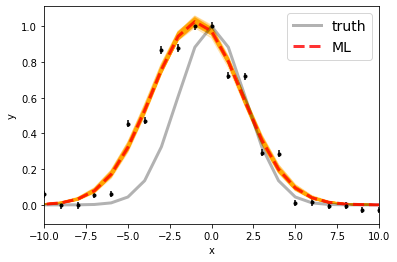

Maximum likelihood estimates:
x0 = -0.890
A = 1.027
s = 2.698


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.109262180125 [0.0343285  0.03464955]
A  =  1.6747827759679129e-16 [1.88349912e-18 1.90155330e-18]
s  =  2.698390628893407 [0.03067752 0.03142298]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


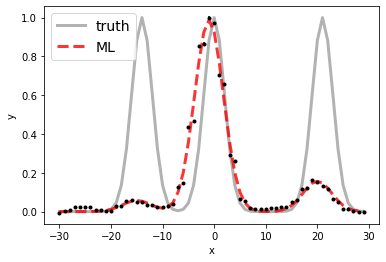

100%|██████████| 15000/15000 [00:25<00:00, 582.83it/s]


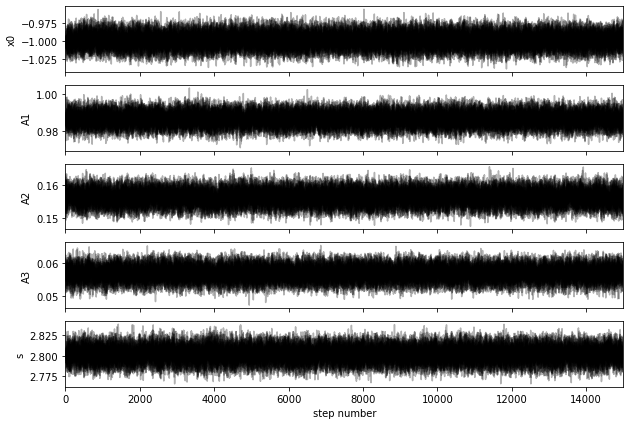

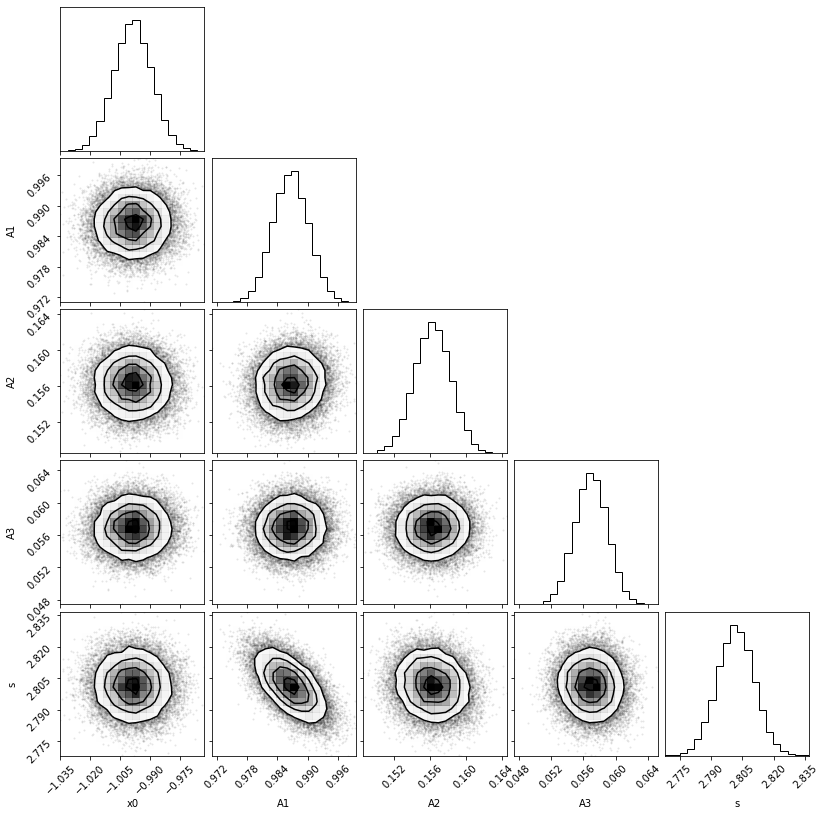

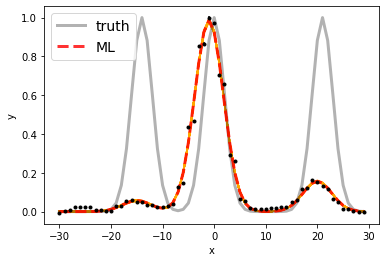

Maximum likelihood estimates:
x0 = -0.999
A1 = 0.987
A2 = 0.156
A3 = 0.057
s = 2.802


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.001268956186 6583.001268956186 [0.00948308 0.00948231]
A1, A2   =  3.307178066643198e-16 5.2381100758576836e-17 [1.16768300e-18 1.16784101e-18] [6.88011622e-19 6.79043344e-19]
s  =  2.8017265224545076 [0.00874895 0.00871012]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 21

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


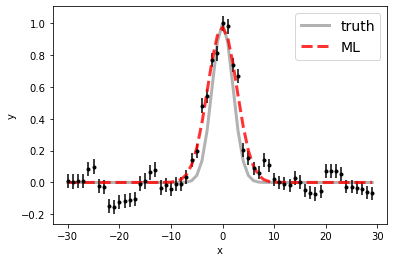

100%|██████████| 15000/15000 [00:16<00:00, 896.83it/s]


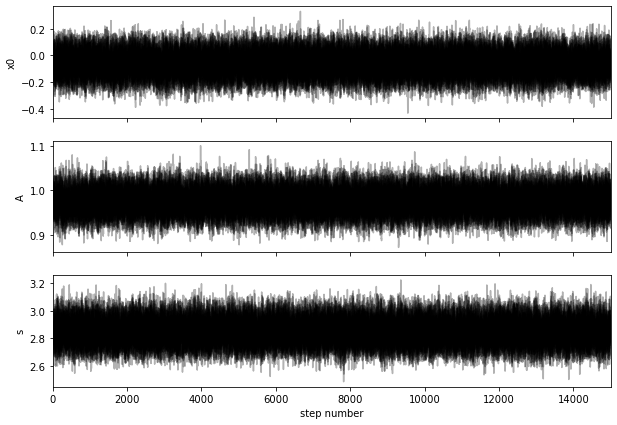

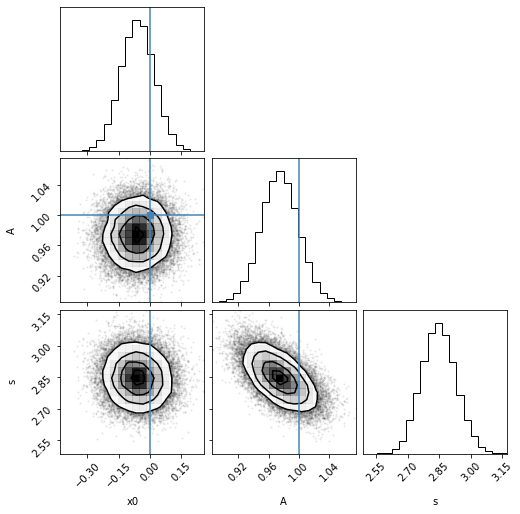

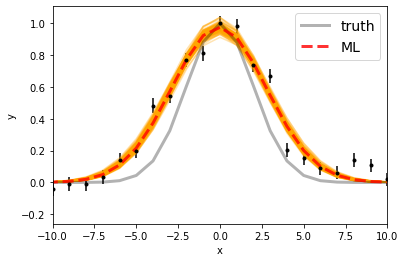

Maximum likelihood estimates:
x0 = -0.058
A = 0.976
s = 2.845


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.941168452943 [0.08110875 0.08019703]
A  =  6.041540534789496e-17 [1.50880244e-18 1.52506556e-18]
s  =  2.847269829364385 [0.08051426 0.0830981 ]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


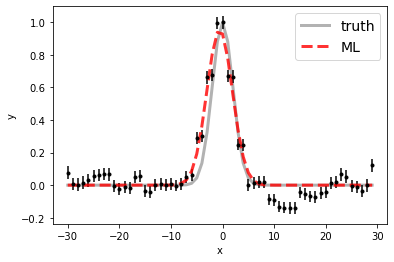

100%|██████████| 15000/15000 [00:17<00:00, 870.03it/s]


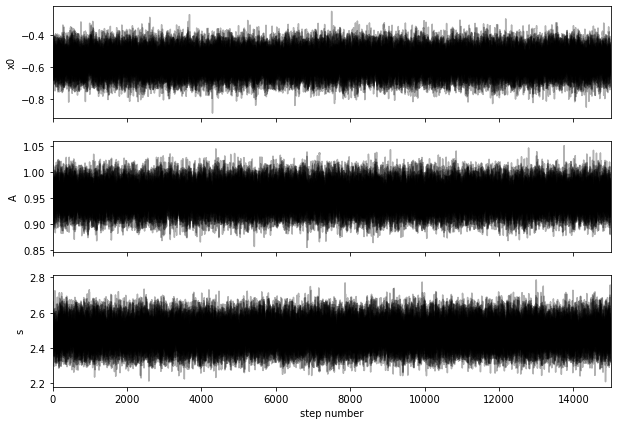

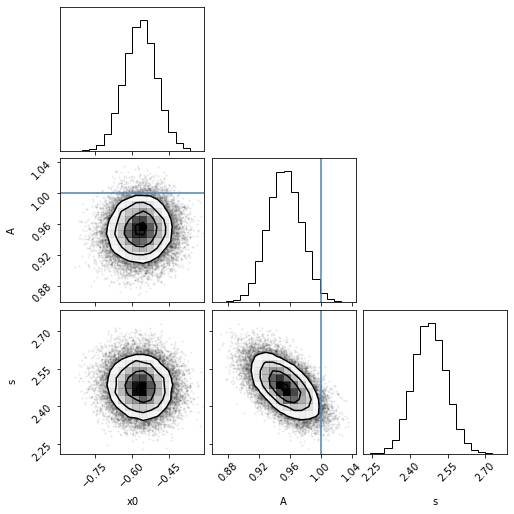

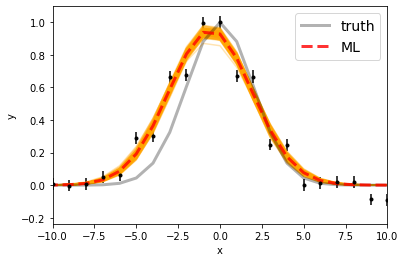

Maximum likelihood estimates:
x0 = -0.566
A = 0.954
s = 2.477


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.434571703191 [0.06604552 0.06385376]
A  =  6.292770466143326e-17 [1.43312186e-18 1.45706564e-18]
s  =  2.4781905077733946 [0.06341186 0.06591587]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


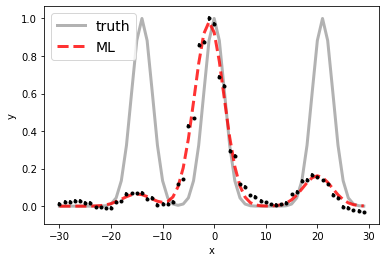

100%|██████████| 15000/15000 [00:26<00:00, 575.00it/s]


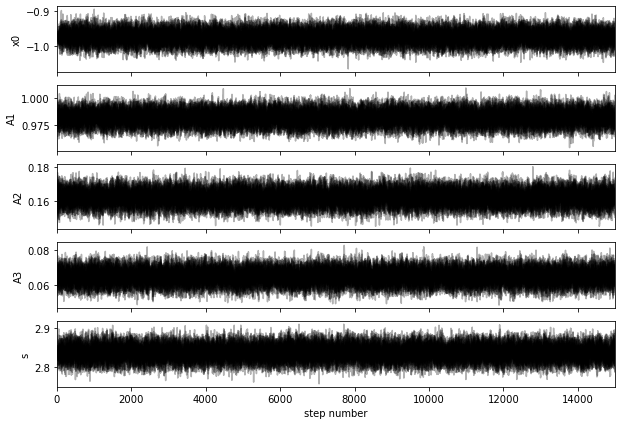

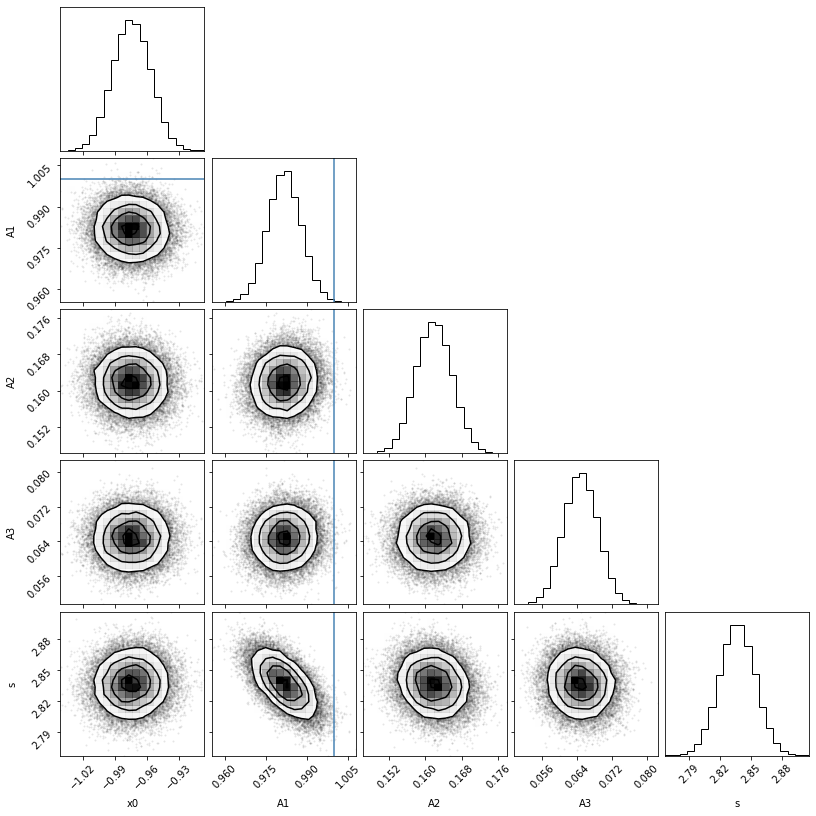

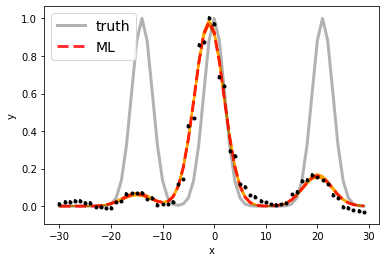

Maximum likelihood estimates:
x0 = -0.974
A1 = 0.982
A2 = 0.162
A3 = 0.065
s = 2.837


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.0256698355415 6583.0256698355415 [0.01756256 0.01787388]
A1, A2   =  1.554014203335483e-16 2.561807335329126e-17 [9.59181536e-19 9.62001688e-19] [6.31453833e-19 6.32155340e-19]
s  =  2.8367035244327488 [0.01712671 0.01728709]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 22

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


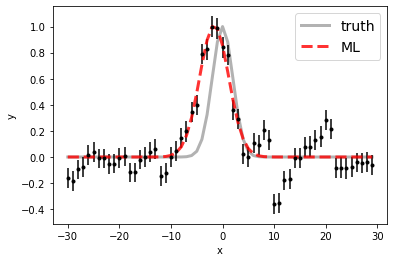

100%|██████████| 15000/15000 [00:16<00:00, 885.08it/s]


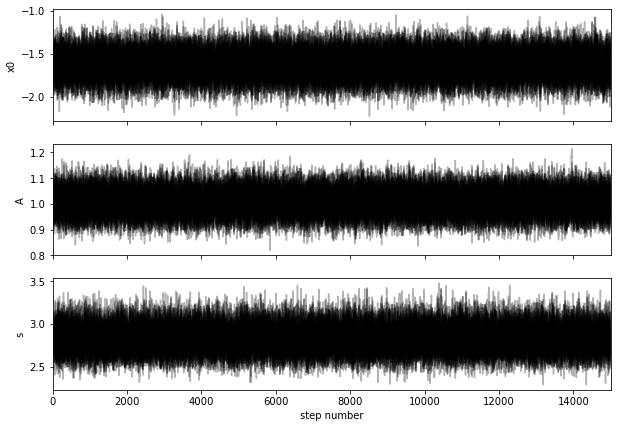

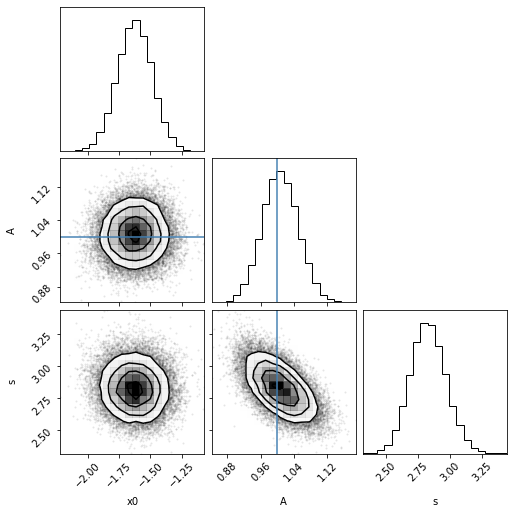

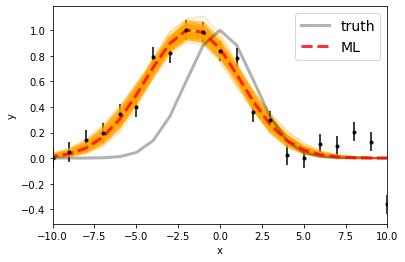

Maximum likelihood estimates:
x0 = -1.624
A = 1.009
s = 2.820


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4859.375303547006 [0.13935588 0.1367384 ]
A  =  3.8025792846541053e-17 [1.61106200e-18 1.64268316e-18]
s  =  2.8260618456531503 [0.13487464 0.14134101]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


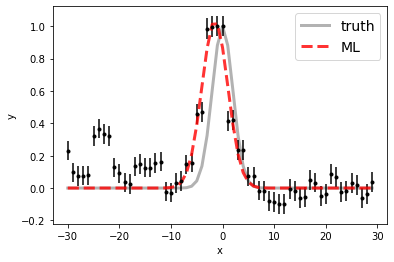

100%|██████████| 15000/15000 [00:25<00:00, 587.13it/s]


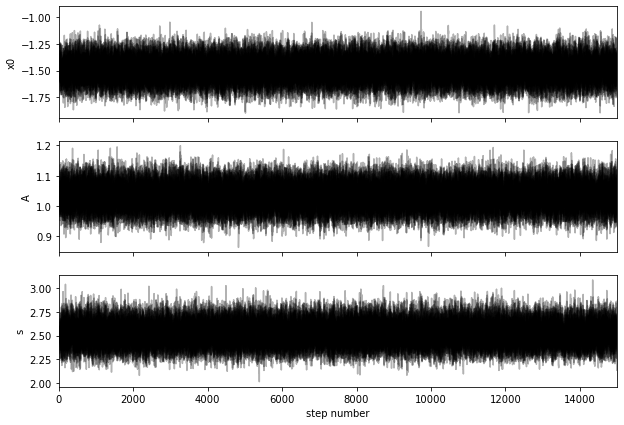

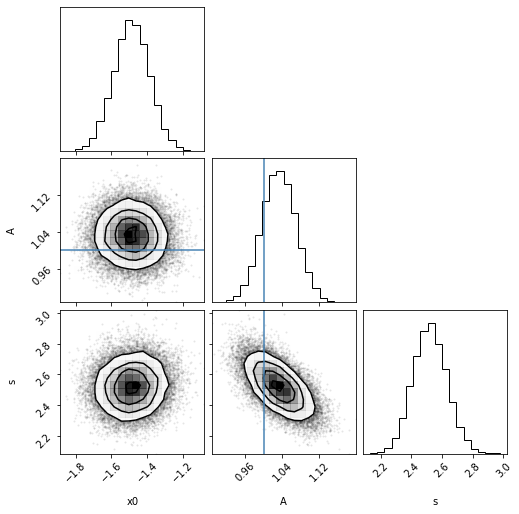

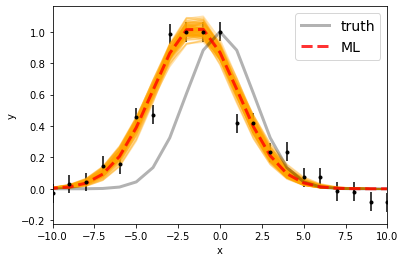

Maximum likelihood estimates:
x0 = -1.488
A = 1.034
s = 2.515


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5005.5125280592765 [0.10094357 0.09992108]
A  =  4.6853643396447065e-17 [1.65726449e-18 1.70498228e-18]
s  =  2.520102326536396 [0.10955558 0.11148033]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


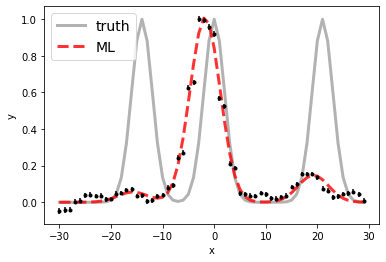

100%|██████████| 15000/15000 [00:36<00:00, 410.19it/s]


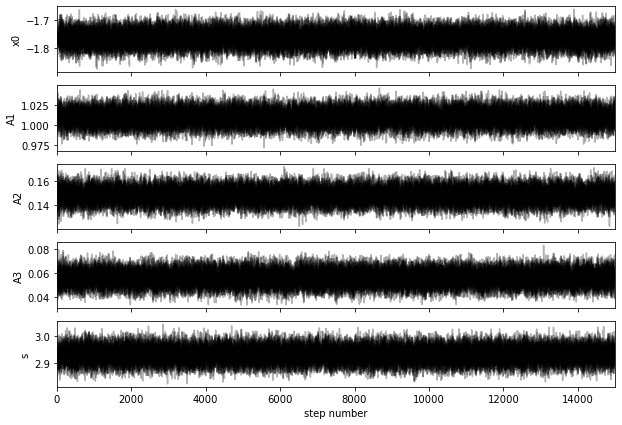

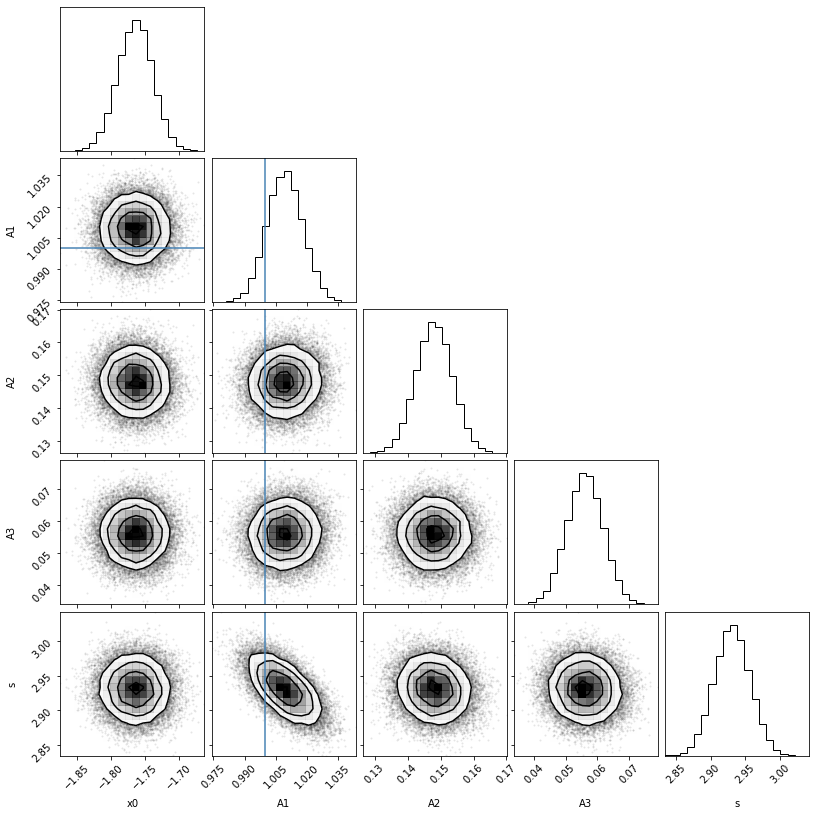

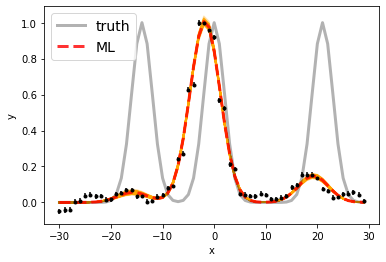

Maximum likelihood estimates:
x0 = -1.764
A1 = 1.009
A2 = 0.148
A3 = 0.056
s = 2.931


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6561.235924180096 6582.235924180096 [0.02608527 0.02483846]
A1, A2   =  1.0754146545281454e-16 1.577617560547047e-17 [9.11261288e-19 9.21397305e-19] [5.87454655e-19 5.89009010e-19]
s  =  2.93093719663222 [0.02560947 0.02534585]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 23

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


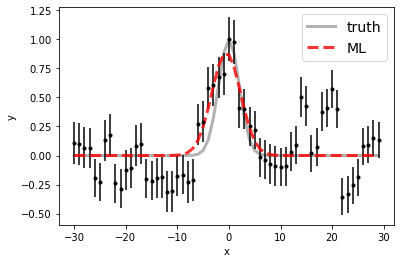

100%|██████████| 15000/15000 [00:23<00:00, 647.92it/s]


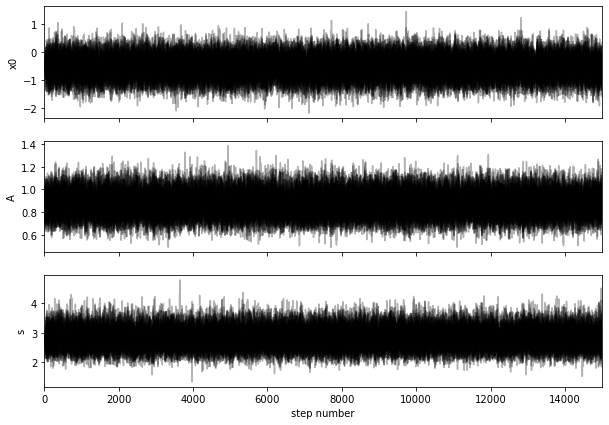

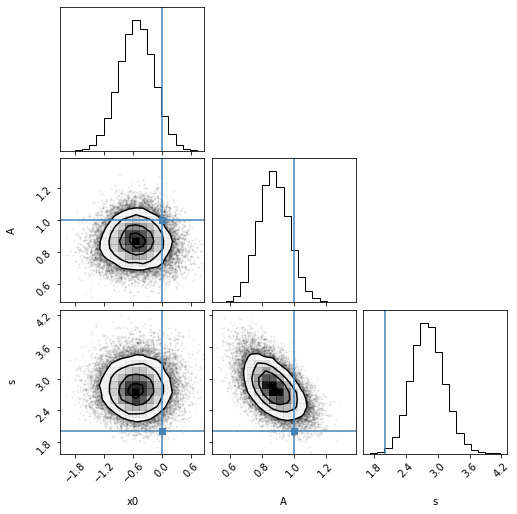

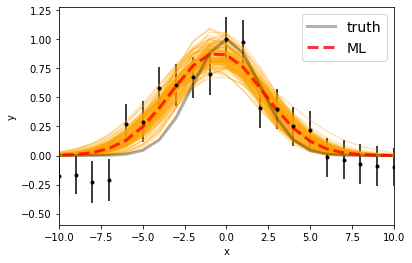

Maximum likelihood estimates:
x0 = -0.539
A = 0.884
s = 2.791


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.474528235806 [0.36124195 0.35865025]
A  =  8.4376742617992e-18 [9.04734217e-19 9.47753657e-19]
s  =  2.8087757393512716 [0.29519861 0.31723228]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


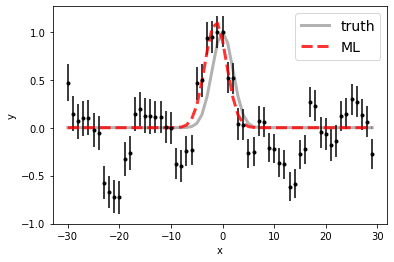

100%|██████████| 15000/15000 [00:25<00:00, 597.74it/s]


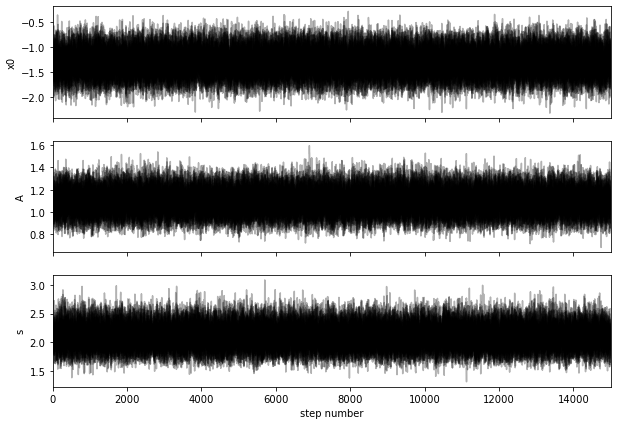

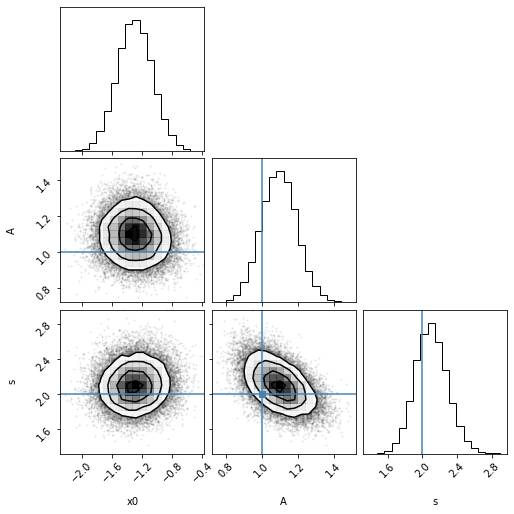

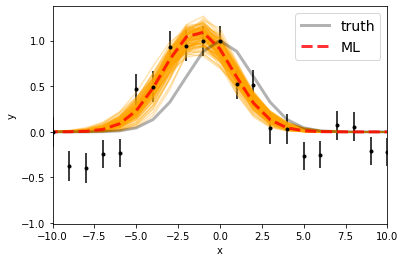

Maximum likelihood estimates:
x0 = -1.305
A = 1.102
s = 2.092


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5005.70198875447 [0.23106854 0.23504204]
A  =  9.431842891164086e-18 [8.45346112e-19 8.47438486e-19]
s  =  2.0972528515334674 [0.17788124 0.19018813]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


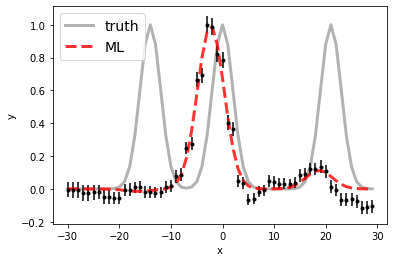

100%|██████████| 15000/15000 [00:31<00:00, 476.47it/s]


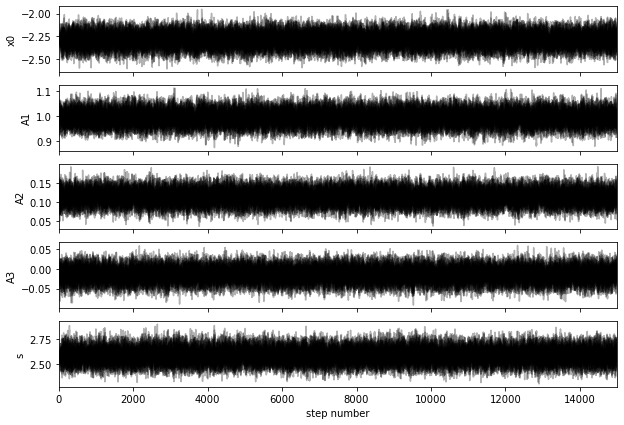

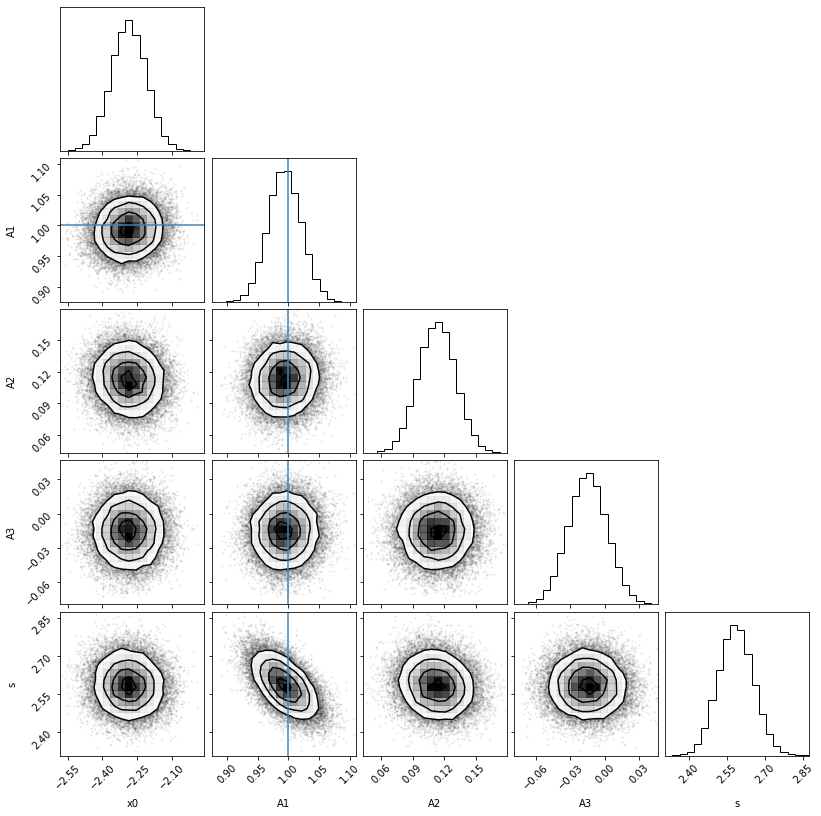

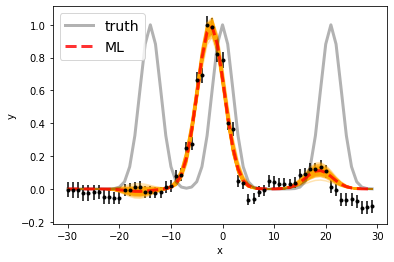

Maximum likelihood estimates:
x0 = -2.288
A1 = 0.994
A2 = 0.113
A3 = -0.015
s = 2.585


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6560.712393848567 6581.712393848567 [0.07414024 0.07538041]
A1, A2   =  1.8696403286791222e-17 2.125052138343448e-18 [5.03713357e-19 5.23150087e-19] [3.34175283e-19 3.27909453e-19]
s  =  2.5840960571572564 [0.06846859 0.06904638]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 24

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


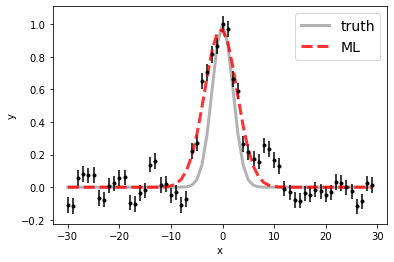

100%|██████████| 15000/15000 [00:17<00:00, 868.86it/s]


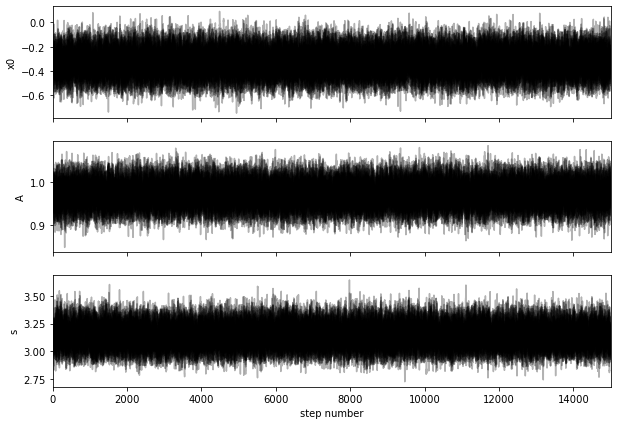

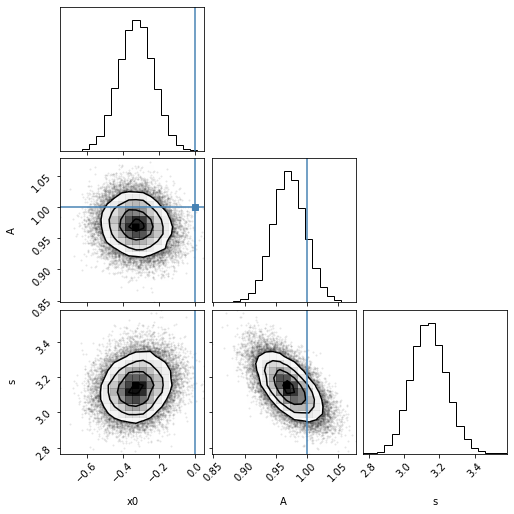

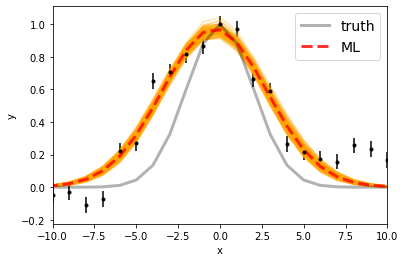

Maximum likelihood estimates:
x0 = -0.328
A = 0.973
s = 3.136


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.674734314167 [0.09756173 0.09666592]
A  =  5.414897986935865e-17 [1.43983169e-18 1.48346796e-18]
s  =  3.1401668655289177 [0.09643759 0.10105033]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


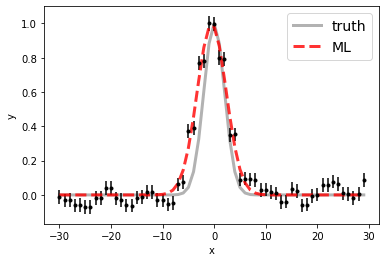

100%|██████████| 15000/15000 [00:17<00:00, 859.65it/s]


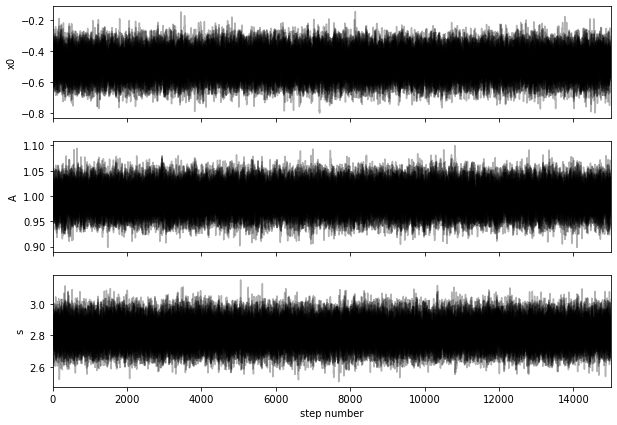

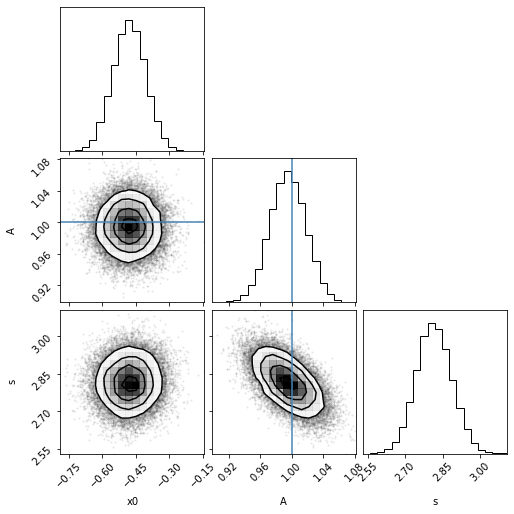

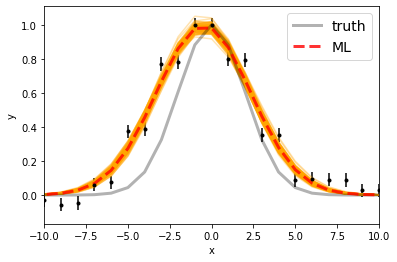

Maximum likelihood estimates:
x0 = -0.481
A = 0.996
s = 2.812


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.520189567511 [0.07394808 0.07151123]
A  =  6.211923007071036e-17 [1.41903967e-18 1.42182154e-18]
s  =  2.8143647434855046 [0.06881065 0.07257118]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


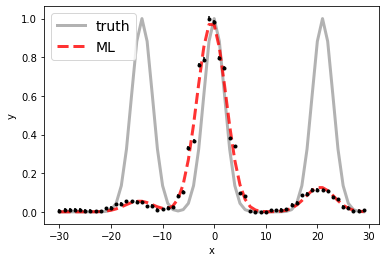

100%|██████████| 15000/15000 [00:28<00:00, 531.96it/s]


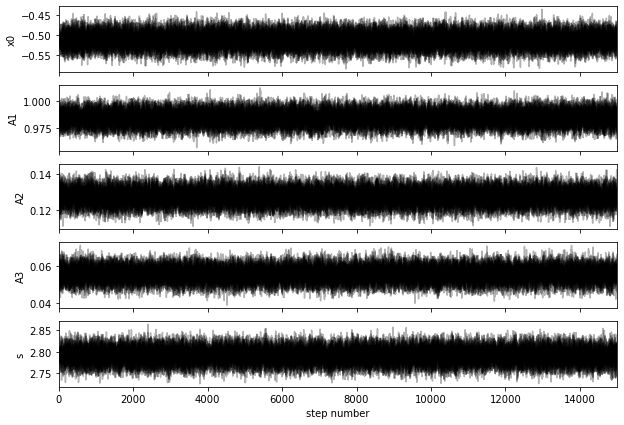

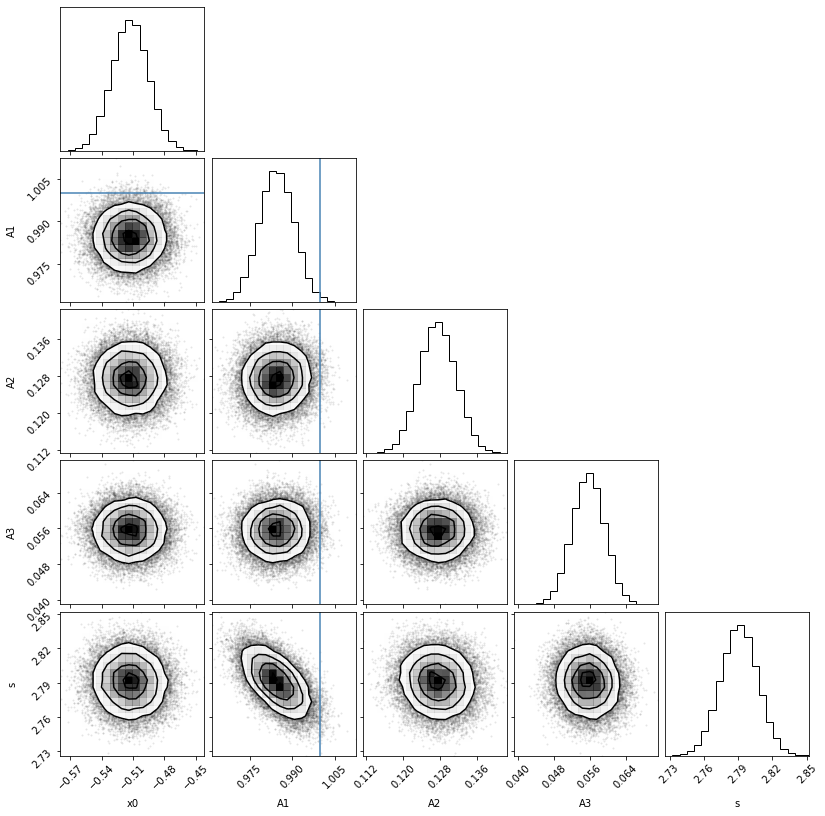

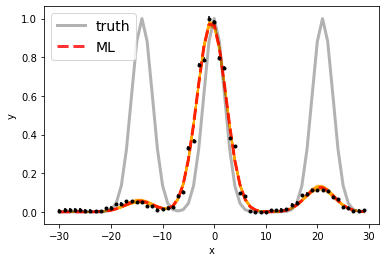

Maximum likelihood estimates:
x0 = -0.513
A1 = 0.984
A2 = 0.127
A3 = 0.056
s = 2.791


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.4870195666 6583.4870195666 [0.01733307 0.01728273]
A1, A2   =  1.499928249159892e-16 1.9404994488172927e-17 [9.28906929e-19 9.44452295e-19] [5.98528543e-19 6.05407792e-19]
s  =  2.79089379788884 [0.0163174  0.01592263]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 25

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


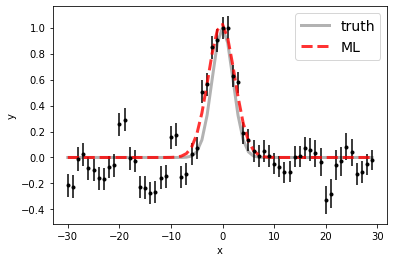

100%|██████████| 15000/15000 [00:18<00:00, 821.00it/s]


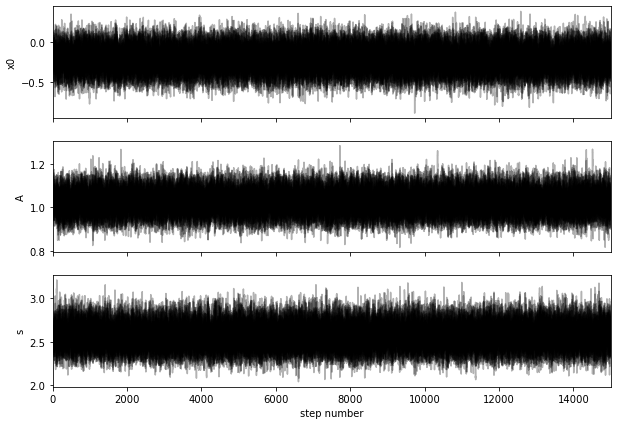

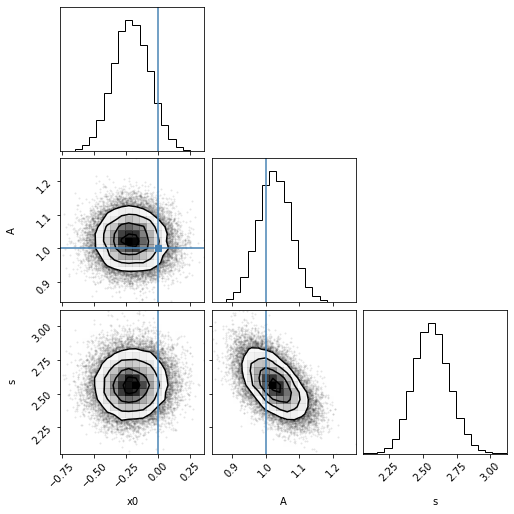

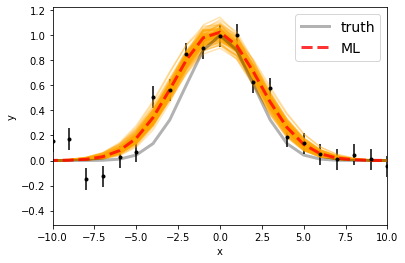

Maximum likelihood estimates:
x0 = -0.212
A = 1.029
s = 2.557


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4860.7876379470845 [0.13932557 0.14548382]
A  =  3.7891686269124123e-17 [1.80954182e-18 1.80384843e-18]
s  =  2.563373519139959 [0.12696148 0.13372198]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


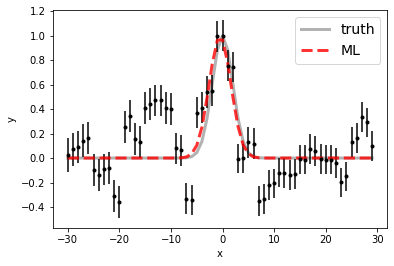

100%|██████████| 15000/15000 [00:17<00:00, 855.79it/s]


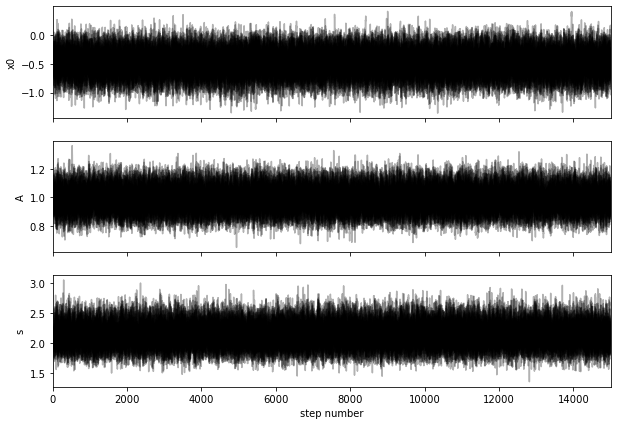

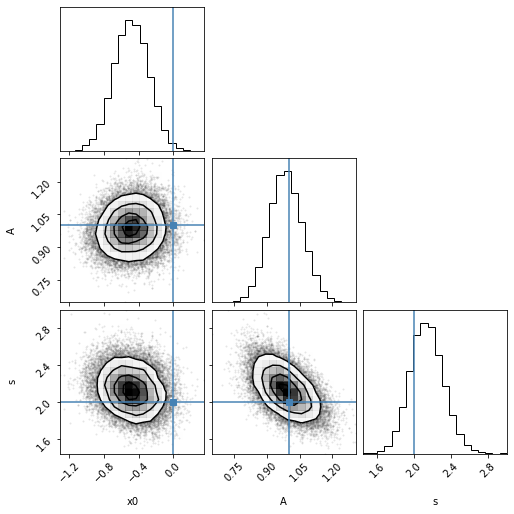

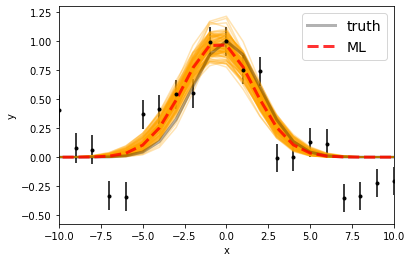

Maximum likelihood estimates:
x0 = -0.487
A = 0.991
s = 2.124


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.513897056643 [0.19958732 0.20182791]
A  =  2.2807519702362932e-17 [1.73959732e-18 1.80149686e-18]
s  =  2.1307266857824416 [0.17285378 0.18585887]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


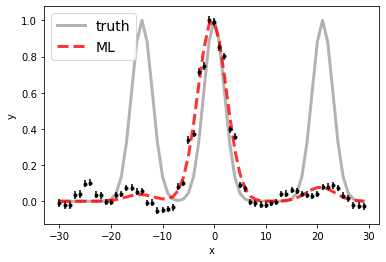

100%|██████████| 15000/15000 [00:26<00:00, 556.19it/s]


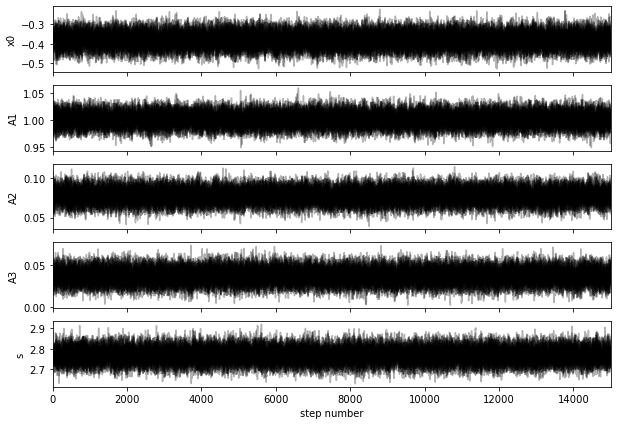

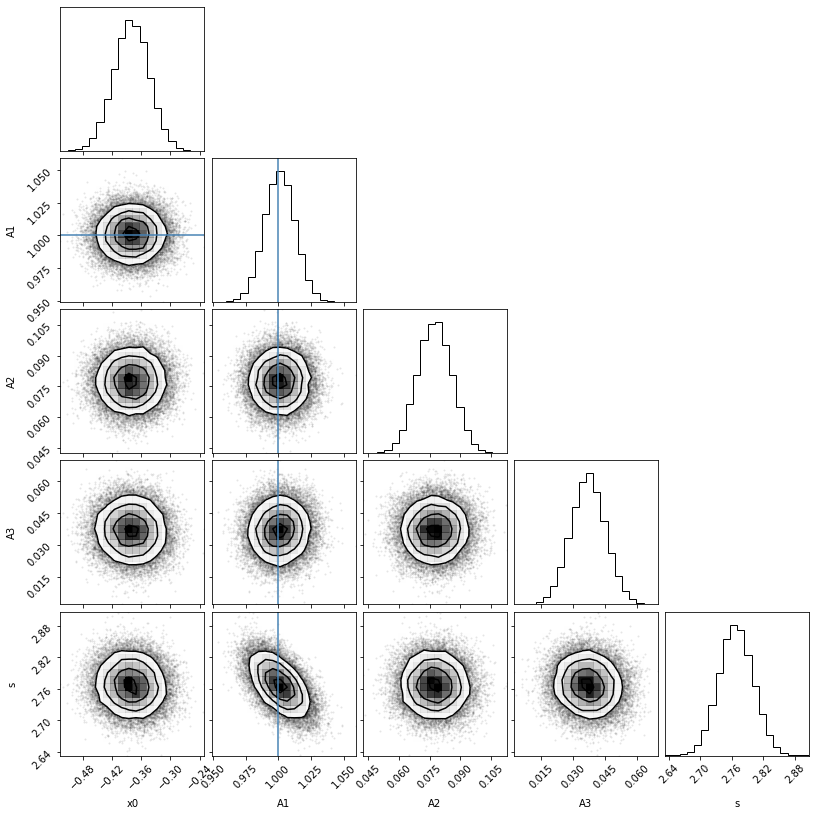

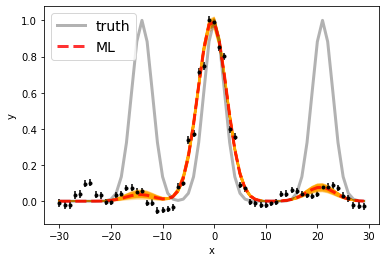

Maximum likelihood estimates:
x0 = -0.380
A1 = 1.001
A2 = 0.077
A3 = 0.037
s = 2.767


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.619606992136 6583.619606992136 [0.03575309 0.0358555 ]
A1, A2   =  7.91479290002076e-17 6.1187093019928795e-18 [9.30847683e-19 9.17029479e-19] [6.60171114e-19 6.62972337e-19]
s  =  2.7675045501422026 [0.03189487 0.03281869]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


AJUSTANDO ESPECTRO 26

Ajuste en 4861 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


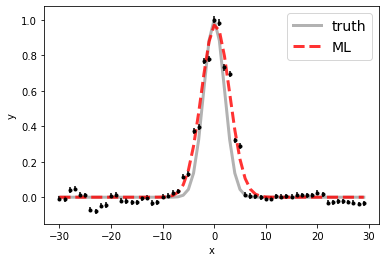

100%|██████████| 15000/15000 [00:17<00:00, 858.49it/s]


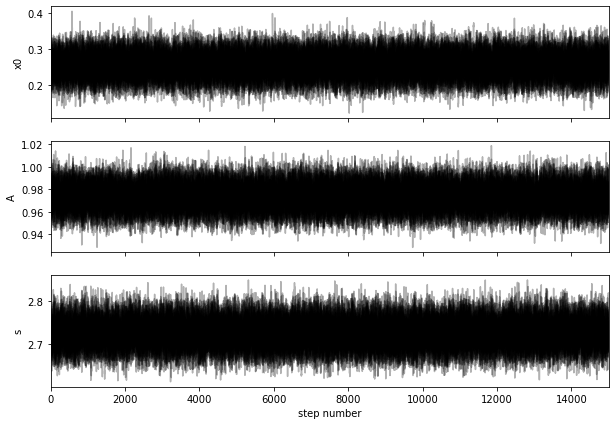

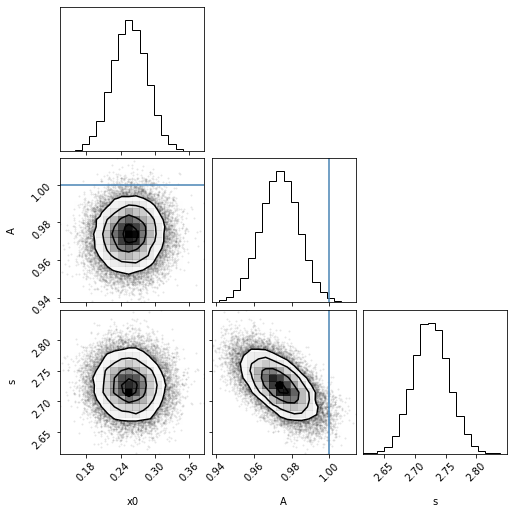

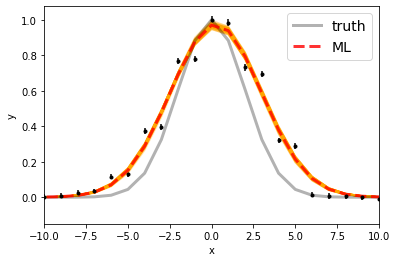

Maximum likelihood estimates:
x0 = 0.255
A = 0.974
s = 2.726


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  4861.255814625503 [0.03062207 0.03067389]
A  =  1.8743688461689603e-16 [1.97738303e-18 1.92766200e-18]
s  =  2.725799051214867 [0.02854192 0.029318  ]

-------------------------------------------------------------------------------------------

Ajuste en 5007 nm:

Parámetros reales:
1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


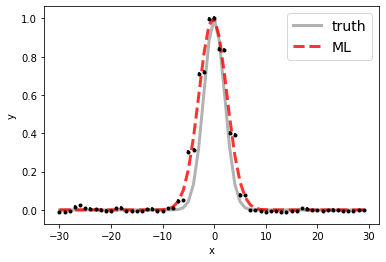

100%|██████████| 15000/15000 [00:18<00:00, 813.37it/s]


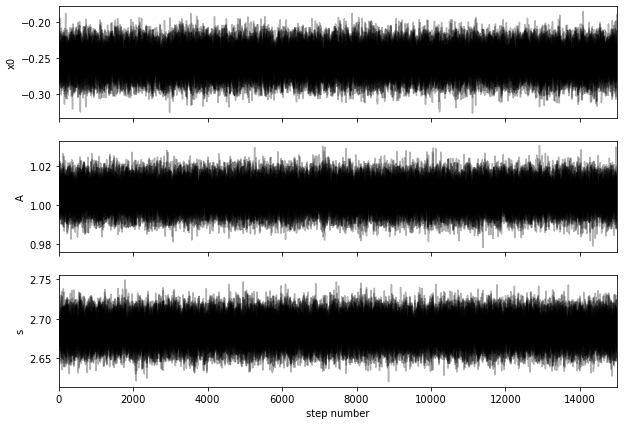

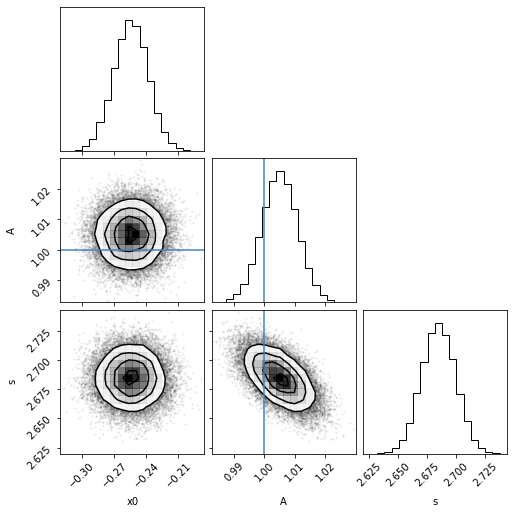

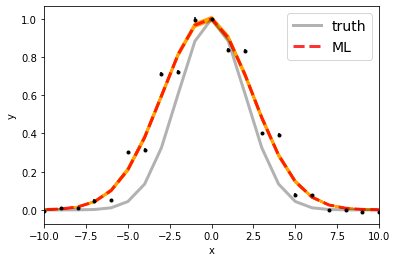

Maximum likelihood estimates:
x0 = -0.254
A = 1.005
s = 2.685


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x0 =  5006.745551253892 [0.01619761 0.01595099]
A  =  3.6898298377233446e-16 [2.15758488e-18 2.13499251e-18]
s  =  2.6848727584559997 [0.01460937 0.01448084]

-------------------------------------------------------------------------------------------

Ajuste en 6563 nm:

Parámetros reales:
1.0 1.0 1.0 0.0 2.0



C:\Users\saruk\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


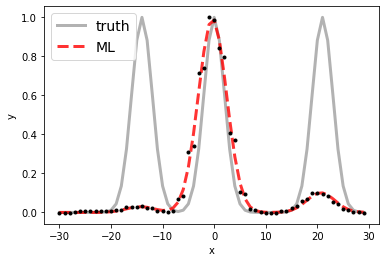

100%|██████████| 15000/15000 [00:25<00:00, 582.05it/s]


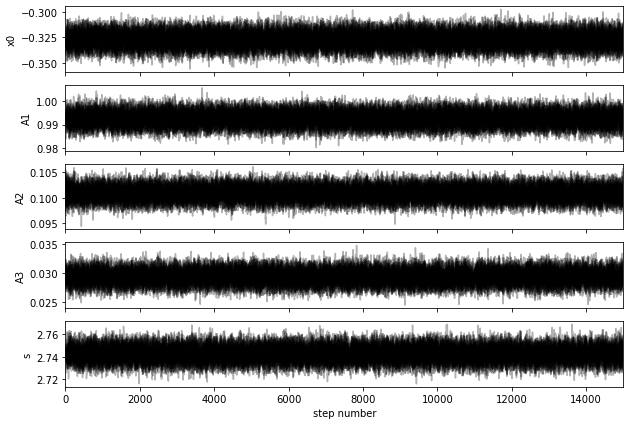

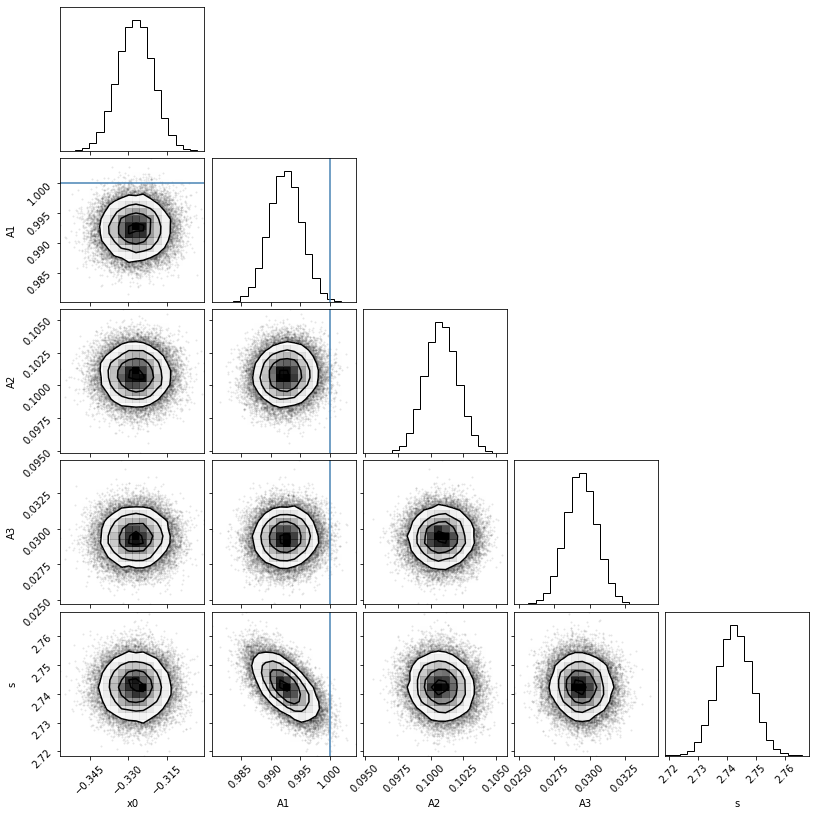

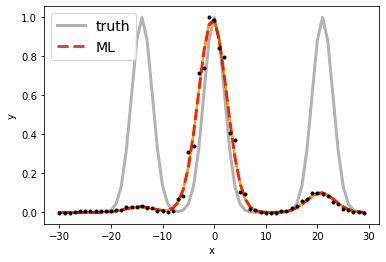

Maximum likelihood estimates:
x0 = -0.327
A1 = 0.992
A2 = 0.101
A3 = 0.029
s = 2.742


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>


Parámetros obtenidos:
x01, x02 =  6562.672726010746 6583.672726010746 [0.00682412 0.00672728]
A1, A2   =  5.485830511113909e-16 5.57151257189011e-17 [1.50497148e-18 1.50412774e-18] [6.77160219e-19 6.82735838e-19]
s  =  2.742460580317108 [0.00582441 0.00593131]

-------------------------------------------------------------------------------------------

///////////////////////////////////////////////////////////////////////////////////////////


El programa ha finalizado en 2320 s.


In [3]:
instanteInicial = datetime.now()

os.chdir(path+'\\adjusted_spectrum')    
os.getcwd()


Hbeta = 4861
OIII = 5007
Halfa = 6563
NII = 6583

lineas = np.array([Hbeta,OIII,Halfa,NII])
lineas_wave = np.array(np.where((l_obs==Hbeta)|(l_obs==OIII)|(l_obs==Halfa)|(l_obs==NII)))

for j in range(len(l_obs_todos[:,0])):
    l_obs = l_obs_todos[j,:]
    f_obs = f_obs_todos[j,:]
    f_syn = f_syn_todos[j,:]
    e_emit = e_emit_todos[j,:]
    
    print('AJUSTANDO ESPECTRO',j)
    print()
    
    
    ##################################### Hb y OIII
    x0_1 = []
    A_1 = []
    s_1 = []
    e_x0_1 = []
    e_A_1 = []
    e_s_1 = []
    lineas_1 = lineas[0:2]
    lineas_wave_1 = lineas_wave[0,0:2]
    for i in range(len(lineas_1)):
        lim_i=lineas_wave_1[i]-30; lim_i=int(lim_i)
        lim_f=lineas_wave_1[i]+30; lim_f=int(lim_f)
        
        # Choose the "true" parameters.
        data = f_obs-f_syn
        wave = l_obs[lim_i:lim_f]
        flux = data[lim_i:lim_f]
        ymax = np.max(flux)
        x = wave-lineas_1[i]
        y = flux/ymax
        yerr = e_emit[lim_i:lim_f]/ymax
        linea = lineas_1[i]
        
        def gaussian(x, a, x0, sigma):
            return a*np.exp(-(x-x0)**2/(2*sigma**2))
            
        popt, pcov = curve_fit(gaussian, wave, flux, p0=[1, 0, 2])
        
        A_true,x0_true,s_true=popt
        print('Ajuste en', lineas_1[i],'nm:')
        print()
        print('Parámetros reales:')
        print(A_true,x0_true,s_true)
        print()
        
        
        # Maximum likehood estimation:
        def log_likelihood(theta, x, y, yerr):
            x0, A, s = theta
            model = A * np.exp( -(x-x0)**2 / (2 * s**2) )
            sigma2 = yerr ** 2 #+ model ** 2 
            return -0.5 * np.sum((y - model) ** 2 / sigma2 )#+ np.log(sigma2))
        
        np.random.seed(42)
        nll = lambda *args: -log_likelihood(*args)
        initial = np.array([x0_true, A_true, s_true]) + 0.1 * np.random.randn(3)
        soln = minimize(nll, initial, args=(x, y, yerr))
        x0_ml, A_ml, s_ml = soln.x
        
        
        plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
        plt.plot(x, A_true * np.exp(-(x-x0_true)**2 / (2*s_true**2))  , "k", alpha=0.3, lw=3, label="truth")
        plt.plot(x, A_ml * np.exp(-(x-x0_ml)**2 / (2*s_ml**2))  , "--r", alpha=0.8, lw=3, label="ML")
        plt.legend(fontsize=14)
        #plt.xlim(-10, 10)
        plt.xlabel('x')
        plt.ylabel('y');
        plt.show()
        
        
        # Marginalization and uncertainty:
        def log_prior(theta):
            x0, A, s = theta
            if -10. < x0 < 10. and 0.0 < A < 20.0 and 0.0 < s < 5.0:
                return 0.0
            return -np.inf
        
        def log_probability(theta, x, y, yerr):
            lp = log_prior(theta)
            if not np.isfinite(lp):
                return -np.inf
            return lp + log_likelihood(theta, x, y, yerr)
        
        pos = soln.x + 1e-4 * np.random.randn(30, 3)
        nwalkers, ndim = pos.shape
        
        sampler = emcee.EnsembleSampler(nwalkers, ndim, log_probability, args=(x, y, yerr))
        sampler.run_mcmc(pos, 15000, progress=True);
        
        
        fig, axes = plt.subplots(3, figsize=(10, 7), sharex=True)
        samples = sampler.get_chain()
        labels = ["x0", "A", "s"]
        for i in range(ndim):
            ax = axes[i]
            ax.plot(samples[:, :, i], "k", alpha=0.3)
            ax.set_xlim(0, len(samples))
            ax.set_ylabel(labels[i])
        #    ax.yaxis.set_label_coords(-0.1, 0.5)
        
        axes[-1].set_xlabel("step number");
        plt.show()
        
        
        flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
        #print(flat_samples.shape)
        
        
        # Resultados
        fig = corner.corner(flat_samples, labels=labels, truths=[x0_true, A_true, s_true]);
        plt.show()
        
        inds = np.random.randint(len(flat_samples), size=100)
        plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
        for ind in inds:
            sample = flat_samples[ind]
            plt.plot(x, sample[1] * np.exp(-(x-sample[0])**2 / (2*sample[2]**2)) , color='orange', alpha=0.3)
        plt.plot(x, A_true * np.exp(-(x-x0_true)**2 / (2*s_true**2))  , "k", alpha=0.3, lw=3, label="truth")
        plt.plot(x, A_ml * np.exp(-(x-x0_ml)**2 / (2*s_ml**2))  , "--r", alpha=0.8, lw=3, label="ML")
        plt.legend(fontsize=14)
        plt.xlim(-10, 10)
        plt.xlabel('x')
        plt.ylabel('y');
        
        plt.show()
        
        print('Maximum likelihood estimates:')
        print("x0 = {0:.3f}".format(x0_ml))
        print("A = {0:.3f}".format(A_ml))
        print("s = {0:.3f}".format(s_ml))
        
        #
        datos = []
        errores = []
        for i in range(ndim):
            mcmc = np.percentile(flat_samples[:, i], [16, 50, 84])
            q = np.diff(mcmc)
            txt = "\mathrm{{{3}}} = {0:.3f}_{{-{1:.3f}}}^{{{2:.3f}}}"
            txt = txt.format(mcmc[1], q[0], q[1], labels[i])
            display(Math(txt))
            datos.append(mcmc[1])
            errores.append(q[:])
            
        datos = np.array(datos)
        errores = np.array(errores)
        x0 = datos[0]+linea
        A = datos[1]*ymax
        s = datos[2]
        e_x0 = errores[0]
        e_A = errores[1]*ymax
        e_s = errores[2]
        print('\nParámetros obtenidos:')
        print('x0 = ', x0, e_x0)
        print('A  = ', A, e_A)
        print('s  = ', s, e_s)
        print('\n-------------------------------------------------------------------------------------------')
        print()
        
        x0_1.append(x0)
        A_1.append(A)
        s_1.append(s)
        e_x0_1.append(e_x0)
        e_A_1.append(e_A)
        e_s_1.append(e_s)
    
    x0_1 = np.array(x0_1)
    A_1 = np.array(A_1)
    s_1 = np.array(s_1)
    e_x0_1 = np.array(e_x0_1)
    e_A_1 = np.array(e_A_1)
    e_s_1 = np.array(e_s_1)
    
        
    ##################################### Ha y NII
    
    d1 = 21
    d2 = 14
    
    x0_2 = []
    A1_2 = []
    A2_2 = []
    A3_2 = []
    s_2 = []
    e_x0_2 = []
    e_A1_2 = []
    e_A2_2 = []
    e_A3_2 = []
    e_s_2 = []
    lim_i = lineas_wave[0,2]-30; lim_i=int(lim_i)
    lim_f = lineas_wave[0,2]+30; lim_f=int(lim_f)
    
    # Choose the "true" parameters.
    data = f_obs-f_syn
    wave = l_obs[lim_i:lim_f]
    flux = data[lim_i:lim_f]
    ymax = np.max(flux)
    x = wave-lineas[2]
    y = flux/ymax
    yerr = e_emit[lim_i:lim_f]/ymax
    linea = lineas[2]
    
    def gaussian_2(x, a1 ,a2,a3, x0, sigma):
        return a1*np.exp(-(x-x0)**2/(2*sigma**2))+a2*np.exp(-(x-(x0+d1))**2/(2*sigma**2))+a3*np.exp(-(x-(x0-d2))**2/(2*sigma**2))
        
    popt, pcov = curve_fit(gaussian_2, wave, flux, p0=[1,1,1, 0, 2])
    
    A1_true,A2_true,A3_true,x0_true,s_true=popt
    print('Ajuste en', lineas[2],'nm:')
    print()
    print('Parámetros reales:')
    print(A1_true,A2_true,A3_true,x0_true,s_true)
    print()
    
    
    # Maximum likehood estimation:
    def log_likelihood(theta, x, y, yerr):
        x0, A1,A2,A3, s = theta
        model = A1 * np.exp( -(x-x0)**2 / (2 * s**2) )+A2 * np.exp( -(x-(x0+d1))**2 / (2 * s**2) )+A3 * np.exp( -(x-(x0-d2))**2 / (2 * s**2) )
        sigma2 = yerr ** 2 #+ model ** 2 
        return -0.5 * np.sum((y - model) ** 2 / sigma2 )#+ np.log(sigma2))
    
    np.random.seed(42)
    nll = lambda *args: -log_likelihood(*args)
    initial = np.array([x0_true, A1_true,A2_true,A3_true, s_true]) + 0.1 * np.random.randn(5)
    soln = minimize(nll, initial, args=(x, y, yerr))
    x0_ml, A1_ml,A2_ml,A3_ml, s_ml = soln.x
    
    
    plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
    plt.plot(x, A1_true * np.exp(-(x-x0_true)**2 / (2*s_true**2))+ A2_true * np.exp(-(x-(x0_true+d1))**2 / (2*s_true**2))+ A3_true * np.exp(-(x-(x0_true-d2))**2 / (2*s_true**2))    , "k", alpha=0.3, lw=3, label="truth")
    plt.plot(x, A1_ml * np.exp(-(x-x0_ml)**2 / (2*s_ml**2))+A2_ml * np.exp(-(x-(x0_ml+d1))**2 / (2*s_ml**2))+A3_ml * np.exp(-(x-(x0_ml-d2))**2 / (2*s_ml**2))  , "--r", alpha=0.8, lw=3, label="ML")
    plt.legend(fontsize=14)
    #plt.xlim(-10, 10)
    plt.xlabel('x')
    plt.ylabel('y');
    plt.show()
    
    
    # Marginalization and uncertainty:
    def log_prior(theta):
        x0, A1,A2,A3, s = theta
        if -10. < x0 < 10. and 0.0 < A1 < 20.0 and 0.0 < s < 5.0:
            return 0.0
        return -np.inf
        if -10. < x0 < 10. and 0.0 < A2 < 20.0 and 0.0 < s < 5.0:
            return 0.0
        return -np.inf
        if -10. < x0 < 10. and 0.0 < A3 < 20.0 and 0.0 < s < 5.0:
            return 0.0
        return -np.inf
    
    def log_probability(theta, x, y, yerr):
        lp = log_prior(theta)
        if not np.isfinite(lp):
            return -np.inf
        return lp + log_likelihood(theta, x, y, yerr)
    
    pos = soln.x + 1e-4 * np.random.randn(30, 5)
    nwalkers, ndim = pos.shape
    
    sampler = emcee.EnsembleSampler(nwalkers, ndim, log_probability, args=(x, y, yerr))
    sampler.run_mcmc(pos, 15000, progress=True);
    
    
    fig, axes = plt.subplots(5, figsize=(10, 7), sharex=True)
    samples = sampler.get_chain()
    labels = ["x0", "A1","A2","A3", "s"]
    for i in range(ndim):
        ax = axes[i]
        ax.plot(samples[:, :, i], "k", alpha=0.3)
        ax.set_xlim(0, len(samples))
        ax.set_ylabel(labels[i])
    #    ax.yaxis.set_label_coords(-0.1, 0.5)
    
    axes[-1].set_xlabel("step number");
    plt.show()
    
    
    flat_samples = sampler.get_chain(discard=100, thin=15, flat=True)
    #print(flat_samples.shape)
    
    
    # Resultados
    fig = corner.corner(flat_samples, labels=labels, truths=[x0_true, A1_true, A2_true, A3_true, s_true]);
    plt.show()
    
    inds = np.random.randint(len(flat_samples), size=100)
    plt.errorbar(x, y, yerr=yerr, fmt=".k", capsize=0)
    for ind in inds:
        sample = flat_samples[ind]
        plt.plot(x, sample[1] * np.exp(-(x-sample[0])**2 / (2*sample[4]**2))+sample[2] * np.exp(-(x-(sample[0]+d1))**2 / (2*sample[4]**2))+sample[3] * np.exp(-(x-(sample[0]-d2))**2 / (2*sample[4]**2)) , color='orange', alpha=0.3)
    plt.plot(x, A1_true * np.exp(-(x-x0_true)**2 / (2*s_true**2))+ A2_true * np.exp(-(x-(x0_true+d1))**2 / (2*s_true**2))+ A3_true * np.exp(-(x-(x0_true-d2))**2 / (2*s_true**2))  , "k", alpha=0.3, lw=3, label="truth")
    plt.plot(x, A1_ml * np.exp(-(x-x0_ml)**2 / (2*s_ml**2))+A2_ml * np.exp(-(x-(x0_ml+d1))**2 / (2*s_ml**2))+A3_ml * np.exp(-(x-(x0_ml-d2))**2 / (2*s_ml**2))   , "--r", alpha=0.8, lw=3, label="ML")
    plt.legend(fontsize=14)
  #  plt.xlim(-10, 10)
    plt.xlabel('x')
    plt.ylabel('y');
    
    plt.show()
    
    print('Maximum likelihood estimates:')
    print("x0 = {0:.3f}".format(x0_ml))
    print("A1 = {0:.3f}".format(A1_ml))
    print("A2 = {0:.3f}".format(A2_ml))
    print("A3 = {0:.3f}".format(A3_ml))
    print("s = {0:.3f}".format(s_ml))
    
    #
    datos = []
    errores = []
    for i in range(ndim):
        mcmc = np.percentile(flat_samples[:, i], [16, 50, 84])
        q = np.diff(mcmc)
        txt = "\mathrm{{{3}}} = {0:.3f}_{{-{1:.3f}}}^{{{2:.3f}}}"
        txt = txt.format(mcmc[1], q[0], q[1], labels[i])
        display(Math(txt))
        datos.append(mcmc[1])
        errores.append(q[:])
        
    datos = np.array(datos)
    errores = np.array(errores)
    x0 = datos[0]+linea
    A1 = datos[1]*ymax
    A2 = datos[2]*ymax
    A3 = datos[3]*ymax
    s = datos[4]
    e_x0 = errores[0]
    e_A1 = errores[1]*ymax
    e_A2 = errores[2]*ymax
    e_A3 = errores[3]*ymax
    e_s = errores[4]
    print('\nParámetros obtenidos:')
    print('x01, x02 = ', x0, x0+d1, e_x0)
    print('A1, A2   = ', A1, A2, e_A1, e_A2)
    print('s  = ', s, e_s)
    print('\n-------------------------------------------------------------------------------------------')
    print()
    
    x0_2.append(x0)
    A1_2.append(A1)
    A2_2.append(A2)
    A3_2.append(A3)
    s_2.append(s)
    e_x0_2.append(e_x0)
    e_A1_2.append(e_A1)
    e_A2_2.append(e_A2)
    e_A3_2.append(e_A3)
    e_s_2.append(e_s)
    
    x0_2 = np.array(x0_2)
    A1_2 = np.array(A1_2) # Ha
    A2_2 = np.array(A2_2) # NII
    A3_2 = np.array(A3_2) # El otro N
    s_2 = np.array(s_2)
    e_x0_2 = np.array(e_x0_2)
    e_A1_2 = np.array(e_A1_2)
    e_A2_2 = np.array(e_A2_2)
    e_A3_2 = np.array(e_A3_2)
    e_s_2 = np.array(e_s_2)
    
    
    ####
    
    
    x0_t = np.concatenate((x0_1,x0_2,(x0_2+d1)),axis=0)
    e_x0_t = np.concatenate((e_x0_1,e_x0_2,e_x0_2),axis=0)
    A_t = np.concatenate((A_1,A1_2,A2_2),axis=0)
    e_A_t = np.concatenate((e_A_1,e_A1_2,e_A2_2),axis=0)
    s_t = np.concatenate((s_1,s_2,s_2),axis=0)
    e_s_t = np.concatenate((e_s_1,e_s_2,e_s_2),axis=0) 

    #table = {'media': x0_t, 'e1x0':e_x0_t[:,0], 'e2x0':e_x0_t[:,1], 
    #         'A': A_t, 'e1A':e_A_t[:,0], 'e2A':e_A_t[:,1], 's':s_t, 
    #         'e1s':e_s_t[:,0], 'e2s':e_s_t[:,1]}
    #ascii.write(table, 'spectrum_adjusted_'+str(j)+'_UGC09391.txt', 
    #            formats={'media': '%.5f','e1x0': '%.5f','e2x0':'%.5f',
    #                     'A': '%.10e','e1A': '%.10e','e2A':'%.10e',
    #                     's': '%.5f','e1s': '%.5f','e2s':'%.5f'}, 
    #            overwrite=True,format='fixed_width',delimiter=None)  
    
    print('///////////////////////////////////////////////////////////////////////////////////////////')
    print()
    print()

instanteFinal = datetime.now()
tiempo = instanteFinal - instanteInicial 
segundos = tiempo.seconds
print('El programa ha finalizado en', segundos,'s.')

Tras esto, se han eliminado determinados espectros ya que no se podían ajustar adecuadamente. 

Para esta galaxia se han descartado los espectros 0, 10, 11 y 18.


### Calculo de flujos

Una vez conocemos la altura de la campana, A, y el ancho o desviación típica, s, del ajuste gaussiano calculamos el flujo de cada campana, que es el área debajo de la curva, que será:

                                           flujo = A * s * sqrt(2pi)

Y hacemos propagación de errores:

                             error = sqrt( 2pi * (s^2 * error_A^2 + A^2 *error_s^2)
                             
Los errores de A y sigma se han obtenido durante el ajuste gaussiano.

In [4]:
os.chdir(path+'\\adjusted_spectrum')    
os.getcwd()

lenn = len(glob.glob1(path+'\emited_spectrum',"*.BN"))

flux_t = []
err1_flux_t = []
err2_flux_t = []
for i in list(itertools.chain(range(1,lenn-17), range(lenn-15,lenn-9),range(lenn-8,lenn))):
    datos=pd.read_table('spectrum_adjusted_'+str(i)+'_UGC09391.txt', delim_whitespace=True)
    A = datos['A']
    s = datos['s']
    e1A = datos['e1A']
    e2A = datos['e2A']
    e1s = datos['e1s']
    e2s = datos['e2s']
    flux = []
    err1_flux = []
    err2_flux = []
    for j in range(len(A)): 
        integral = A[j]*s[j]*sqrt(2*pi)
        err1 = sqrt(2*pi*(s[j]**2*e1A[j]**2+A[j]**2*e1s[j]**2))
        err2 = sqrt(2*pi*(s[j]**2*e2A[j]**2+A[j]**2*e2s[j]**2))
        flux.append(integral)
        err1_flux.append(err1)
        err2_flux.append(err2)
    flux = np.array(flux)
    err1_flux = np.array(err1_flux)
    err2_flux = np.array(err2_flux)
    flux_t.append(flux)
    err1_flux_t.append(err1_flux)
    err2_flux_t.append(err2_flux)
flux_t = np.array(flux_t)
err1_flux_t = np.array(err1_flux_t)
err2_flux_t = np.array(err2_flux_t)

spec = np.linspace(0,len(flux_t[:,0])-1,len(flux_t[:,0]))
#for j in range(len(flux_t[:,0])):
#    table = {'spec': spec, 'Ha':flux_t[:,2], 'e1Ha':err1_flux_t[:,2], 'e2Ha':err2_flux_t[:,2], 
#             'Hb':flux_t[:,0], 'e1Hb':err1_flux_t[:,0], 'e2Hb':err2_flux_t[:,0], 'O3': flux_t[:,1], 
#             'e1O3':err1_flux_t[:,1], 'e2O3':err2_flux_t[:,1], 'N2':flux_t[:,3], 'e1N2':err1_flux_t[:,3], 
#             'e2N2':err2_flux_t[:,3]}
#    ascii.write(table, 'flujos.txt', formats={'spec': '%i','Ha': '%.6e','e1Ha': '%.6e','e2Ha': '%.6e',
#                                              'Hb':'%.6e','e1Hb': '%.6e','e2Hb': '%.6e','O3': '%.6e',
#                                              'e1O3': '%.6e','e2O3': '%.6e','N2': '%.6e','e1N2': '%.6e',
#                                              'e2N2': '%.6e',}, overwrite=True, format='fixed_width',delimiter=None)  
